In [1]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
from __future__ import print_function
import keras
from keras.utils import to_categorical
import os
from keras.preprocessing.image import ImageDataGenerator, load_img

Using TensorFlow backend.


In [2]:
from keras.applications import VGG16

vgg_conv = VGG16(weights='imagenet',
                  include_top=False,
                  input_shape=(256, 256, 3))

In [3]:
vgg_conv.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         (None, 256, 256, 3)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 256, 256, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 256, 256, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 128, 128, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 128, 128, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 128, 128, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 64, 64, 128)       0         
__________

In [4]:
train_dir = './clean-dataset/training'
validation_dir = './clean-dataset/testing'

nTrain = 25066
nVal = 4335

In [5]:
datagen = ImageDataGenerator(rescale=1./255)
batch_size = 50

train_features = np.zeros(shape=(nTrain, 8, 8, 512))
train_labels = np.zeros(shape=(nTrain,4))

train_generator = datagen.flow_from_directory(
    train_dir,
    target_size=(256, 256),
    batch_size=batch_size,
    class_mode='categorical',
    shuffle=True)

i = 0
for inputs_batch, labels_batch in train_generator:
    features_batch = vgg_conv.predict(inputs_batch)
    train_features[i * batch_size : (i + 1) * batch_size] = features_batch
    train_labels[i * batch_size : (i + 1) * batch_size] = labels_batch
    i += 1
    if i * batch_size >= nTrain:
        break
        
train_features = np.reshape(train_features, (nTrain, 8 * 8 * 512))

Found 25064 images belonging to 4 classes.


ResourceExhaustedError: OOM when allocating tensor with shape[32,64,256,256]
	 [[Node: block1_conv2/convolution = Conv2D[T=DT_FLOAT, data_format="NHWC", padding="SAME", strides=[1, 1, 1, 1], use_cudnn_on_gpu=true, _device="/job:localhost/replica:0/task:0/gpu:0"](block1_conv1/Relu, block1_conv2/kernel/read)]]
	 [[Node: block5_pool/MaxPool/_107 = _Recv[client_terminated=false, recv_device="/job:localhost/replica:0/task:0/cpu:0", send_device="/job:localhost/replica:0/task:0/gpu:0", send_device_incarnation=1, tensor_name="edge_128_block5_pool/MaxPool", tensor_type=DT_FLOAT, _device="/job:localhost/replica:0/task:0/cpu:0"]()]]

Caused by op u'block1_conv2/convolution', defined at:
  File "/home/saloni/anaconda2/lib/python2.7/runpy.py", line 174, in _run_module_as_main
    "__main__", fname, loader, pkg_name)
  File "/home/saloni/anaconda2/lib/python2.7/runpy.py", line 72, in _run_code
    exec code in run_globals
  File "/home/saloni/anaconda2/lib/python2.7/site-packages/ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "/home/saloni/anaconda2/lib/python2.7/site-packages/traitlets/config/application.py", line 658, in launch_instance
    app.start()
  File "/home/saloni/anaconda2/lib/python2.7/site-packages/ipykernel/kernelapp.py", line 477, in start
    ioloop.IOLoop.instance().start()
  File "/home/saloni/anaconda2/lib/python2.7/site-packages/zmq/eventloop/ioloop.py", line 177, in start
    super(ZMQIOLoop, self).start()
  File "/home/saloni/anaconda2/lib/python2.7/site-packages/tornado/ioloop.py", line 888, in start
    handler_func(fd_obj, events)
  File "/home/saloni/anaconda2/lib/python2.7/site-packages/tornado/stack_context.py", line 277, in null_wrapper
    return fn(*args, **kwargs)
  File "/home/saloni/anaconda2/lib/python2.7/site-packages/zmq/eventloop/zmqstream.py", line 440, in _handle_events
    self._handle_recv()
  File "/home/saloni/anaconda2/lib/python2.7/site-packages/zmq/eventloop/zmqstream.py", line 472, in _handle_recv
    self._run_callback(callback, msg)
  File "/home/saloni/anaconda2/lib/python2.7/site-packages/zmq/eventloop/zmqstream.py", line 414, in _run_callback
    callback(*args, **kwargs)
  File "/home/saloni/anaconda2/lib/python2.7/site-packages/tornado/stack_context.py", line 277, in null_wrapper
    return fn(*args, **kwargs)
  File "/home/saloni/anaconda2/lib/python2.7/site-packages/ipykernel/kernelbase.py", line 283, in dispatcher
    return self.dispatch_shell(stream, msg)
  File "/home/saloni/anaconda2/lib/python2.7/site-packages/ipykernel/kernelbase.py", line 235, in dispatch_shell
    handler(stream, idents, msg)
  File "/home/saloni/anaconda2/lib/python2.7/site-packages/ipykernel/kernelbase.py", line 399, in execute_request
    user_expressions, allow_stdin)
  File "/home/saloni/anaconda2/lib/python2.7/site-packages/ipykernel/ipkernel.py", line 196, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "/home/saloni/anaconda2/lib/python2.7/site-packages/ipykernel/zmqshell.py", line 533, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "/home/saloni/anaconda2/lib/python2.7/site-packages/IPython/core/interactiveshell.py", line 2718, in run_cell
    interactivity=interactivity, compiler=compiler, result=result)
  File "/home/saloni/anaconda2/lib/python2.7/site-packages/IPython/core/interactiveshell.py", line 2822, in run_ast_nodes
    if self.run_code(code, result):
  File "/home/saloni/anaconda2/lib/python2.7/site-packages/IPython/core/interactiveshell.py", line 2882, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-2-d8cdb9426a92>", line 5, in <module>
    input_shape=(256, 256, 3))
  File "/home/saloni/anaconda2/lib/python2.7/site-packages/keras/applications/vgg16.py", line 113, in VGG16
    x = Conv2D(64, (3, 3), activation='relu', padding='same', name='block1_conv2')(x)
  File "/home/saloni/anaconda2/lib/python2.7/site-packages/keras/engine/topology.py", line 602, in __call__
    output = self.call(inputs, **kwargs)
  File "/home/saloni/anaconda2/lib/python2.7/site-packages/keras/layers/convolutional.py", line 164, in call
    dilation_rate=self.dilation_rate)
  File "/home/saloni/anaconda2/lib/python2.7/site-packages/keras/backend/tensorflow_backend.py", line 3164, in conv2d
    data_format='NHWC')
  File "/home/saloni/anaconda2/lib/python2.7/site-packages/tensorflow/python/ops/nn_ops.py", line 672, in convolution
    op=op)
  File "/home/saloni/anaconda2/lib/python2.7/site-packages/tensorflow/python/ops/nn_ops.py", line 338, in with_space_to_batch
    return op(input, num_spatial_dims, padding)
  File "/home/saloni/anaconda2/lib/python2.7/site-packages/tensorflow/python/ops/nn_ops.py", line 664, in op
    name=name)
  File "/home/saloni/anaconda2/lib/python2.7/site-packages/tensorflow/python/ops/nn_ops.py", line 131, in _non_atrous_convolution
    name=name)
  File "/home/saloni/anaconda2/lib/python2.7/site-packages/tensorflow/python/ops/gen_nn_ops.py", line 397, in conv2d
    data_format=data_format, name=name)
  File "/home/saloni/anaconda2/lib/python2.7/site-packages/tensorflow/python/framework/op_def_library.py", line 767, in apply_op
    op_def=op_def)
  File "/home/saloni/anaconda2/lib/python2.7/site-packages/tensorflow/python/framework/ops.py", line 2630, in create_op
    original_op=self._default_original_op, op_def=op_def)
  File "/home/saloni/anaconda2/lib/python2.7/site-packages/tensorflow/python/framework/ops.py", line 1204, in __init__
    self._traceback = self._graph._extract_stack()  # pylint: disable=protected-access

ResourceExhaustedError (see above for traceback): OOM when allocating tensor with shape[32,64,256,256]
	 [[Node: block1_conv2/convolution = Conv2D[T=DT_FLOAT, data_format="NHWC", padding="SAME", strides=[1, 1, 1, 1], use_cudnn_on_gpu=true, _device="/job:localhost/replica:0/task:0/gpu:0"](block1_conv1/Relu, block1_conv2/kernel/read)]]
	 [[Node: block5_pool/MaxPool/_107 = _Recv[client_terminated=false, recv_device="/job:localhost/replica:0/task:0/cpu:0", send_device="/job:localhost/replica:0/task:0/gpu:0", send_device_incarnation=1, tensor_name="edge_128_block5_pool/MaxPool", tensor_type=DT_FLOAT, _device="/job:localhost/replica:0/task:0/cpu:0"]()]]


In [6]:
validation_features = np.zeros(shape=(nVal, 8, 8, 512))
validation_labels = np.zeros(shape=(nVal,4))

validation_generator = datagen.flow_from_directory(
    validation_dir,
    target_size=(256, 256),
    batch_size=batch_size,
    class_mode='categorical',
    shuffle=False)

i = 0
for inputs_batch, labels_batch in validation_generator:
    features_batch = vgg_conv.predict(inputs_batch)
    validation_features[i * batch_size : (i + 1) * batch_size] = features_batch
    validation_labels[i * batch_size : (i + 1) * batch_size] = labels_batch
    i += 1
    if i * batch_size >= nVal:
        break

validation_features = np.reshape(validation_features, (nVal, 8 * 8 * 512))

Found 4335 images belonging to 4 classes.


ResourceExhaustedError: OOM when allocating tensor with shape[32,64,256,256]
	 [[Node: block1_conv2/convolution = Conv2D[T=DT_FLOAT, data_format="NHWC", padding="SAME", strides=[1, 1, 1, 1], use_cudnn_on_gpu=true, _device="/job:localhost/replica:0/task:0/gpu:0"](block1_conv1/Relu, block1_conv2/kernel/read)]]

Caused by op u'block1_conv2/convolution', defined at:
  File "/home/saloni/anaconda2/lib/python2.7/runpy.py", line 174, in _run_module_as_main
    "__main__", fname, loader, pkg_name)
  File "/home/saloni/anaconda2/lib/python2.7/runpy.py", line 72, in _run_code
    exec code in run_globals
  File "/home/saloni/anaconda2/lib/python2.7/site-packages/ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "/home/saloni/anaconda2/lib/python2.7/site-packages/traitlets/config/application.py", line 658, in launch_instance
    app.start()
  File "/home/saloni/anaconda2/lib/python2.7/site-packages/ipykernel/kernelapp.py", line 477, in start
    ioloop.IOLoop.instance().start()
  File "/home/saloni/anaconda2/lib/python2.7/site-packages/zmq/eventloop/ioloop.py", line 177, in start
    super(ZMQIOLoop, self).start()
  File "/home/saloni/anaconda2/lib/python2.7/site-packages/tornado/ioloop.py", line 888, in start
    handler_func(fd_obj, events)
  File "/home/saloni/anaconda2/lib/python2.7/site-packages/tornado/stack_context.py", line 277, in null_wrapper
    return fn(*args, **kwargs)
  File "/home/saloni/anaconda2/lib/python2.7/site-packages/zmq/eventloop/zmqstream.py", line 440, in _handle_events
    self._handle_recv()
  File "/home/saloni/anaconda2/lib/python2.7/site-packages/zmq/eventloop/zmqstream.py", line 472, in _handle_recv
    self._run_callback(callback, msg)
  File "/home/saloni/anaconda2/lib/python2.7/site-packages/zmq/eventloop/zmqstream.py", line 414, in _run_callback
    callback(*args, **kwargs)
  File "/home/saloni/anaconda2/lib/python2.7/site-packages/tornado/stack_context.py", line 277, in null_wrapper
    return fn(*args, **kwargs)
  File "/home/saloni/anaconda2/lib/python2.7/site-packages/ipykernel/kernelbase.py", line 283, in dispatcher
    return self.dispatch_shell(stream, msg)
  File "/home/saloni/anaconda2/lib/python2.7/site-packages/ipykernel/kernelbase.py", line 235, in dispatch_shell
    handler(stream, idents, msg)
  File "/home/saloni/anaconda2/lib/python2.7/site-packages/ipykernel/kernelbase.py", line 399, in execute_request
    user_expressions, allow_stdin)
  File "/home/saloni/anaconda2/lib/python2.7/site-packages/ipykernel/ipkernel.py", line 196, in do_execute
    res = shell.run_cell(code, store_history=store_history, silent=silent)
  File "/home/saloni/anaconda2/lib/python2.7/site-packages/ipykernel/zmqshell.py", line 533, in run_cell
    return super(ZMQInteractiveShell, self).run_cell(*args, **kwargs)
  File "/home/saloni/anaconda2/lib/python2.7/site-packages/IPython/core/interactiveshell.py", line 2718, in run_cell
    interactivity=interactivity, compiler=compiler, result=result)
  File "/home/saloni/anaconda2/lib/python2.7/site-packages/IPython/core/interactiveshell.py", line 2822, in run_ast_nodes
    if self.run_code(code, result):
  File "/home/saloni/anaconda2/lib/python2.7/site-packages/IPython/core/interactiveshell.py", line 2882, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-2-d8cdb9426a92>", line 5, in <module>
    input_shape=(256, 256, 3))
  File "/home/saloni/anaconda2/lib/python2.7/site-packages/keras/applications/vgg16.py", line 113, in VGG16
    x = Conv2D(64, (3, 3), activation='relu', padding='same', name='block1_conv2')(x)
  File "/home/saloni/anaconda2/lib/python2.7/site-packages/keras/engine/topology.py", line 602, in __call__
    output = self.call(inputs, **kwargs)
  File "/home/saloni/anaconda2/lib/python2.7/site-packages/keras/layers/convolutional.py", line 164, in call
    dilation_rate=self.dilation_rate)
  File "/home/saloni/anaconda2/lib/python2.7/site-packages/keras/backend/tensorflow_backend.py", line 3164, in conv2d
    data_format='NHWC')
  File "/home/saloni/anaconda2/lib/python2.7/site-packages/tensorflow/python/ops/nn_ops.py", line 672, in convolution
    op=op)
  File "/home/saloni/anaconda2/lib/python2.7/site-packages/tensorflow/python/ops/nn_ops.py", line 338, in with_space_to_batch
    return op(input, num_spatial_dims, padding)
  File "/home/saloni/anaconda2/lib/python2.7/site-packages/tensorflow/python/ops/nn_ops.py", line 664, in op
    name=name)
  File "/home/saloni/anaconda2/lib/python2.7/site-packages/tensorflow/python/ops/nn_ops.py", line 131, in _non_atrous_convolution
    name=name)
  File "/home/saloni/anaconda2/lib/python2.7/site-packages/tensorflow/python/ops/gen_nn_ops.py", line 397, in conv2d
    data_format=data_format, name=name)
  File "/home/saloni/anaconda2/lib/python2.7/site-packages/tensorflow/python/framework/op_def_library.py", line 767, in apply_op
    op_def=op_def)
  File "/home/saloni/anaconda2/lib/python2.7/site-packages/tensorflow/python/framework/ops.py", line 2630, in create_op
    original_op=self._default_original_op, op_def=op_def)
  File "/home/saloni/anaconda2/lib/python2.7/site-packages/tensorflow/python/framework/ops.py", line 1204, in __init__
    self._traceback = self._graph._extract_stack()  # pylint: disable=protected-access

ResourceExhaustedError (see above for traceback): OOM when allocating tensor with shape[32,64,256,256]
	 [[Node: block1_conv2/convolution = Conv2D[T=DT_FLOAT, data_format="NHWC", padding="SAME", strides=[1, 1, 1, 1], use_cudnn_on_gpu=true, _device="/job:localhost/replica:0/task:0/gpu:0"](block1_conv1/Relu, block1_conv2/kernel/read)]]


### Create your own model and train the network

In [ ]:
from keras import models
from keras import layers
from keras import optimizers

model = models.Sequential()

model.add(Flatten())
model.add(layers.Dense(512, activation='relu', input_dim=8 * 8 * 512))
model.add(layers.Dropout(0.5))
model.add(Flatten())
model.add(layers.Dense(4, activation='softmax'))

model.compile(optimizer=optimizers.RMSprop(lr=2e-4),
              loss='categorical_crossentropy',
              metrics=['acc'])

history = model.fit(train_features,
                    train_labels,
                    epochs=20,
                    batch_size=batch_size,
                    validation_data=(validation_features,validation_labels))

In [ ]:
model.save('vgg_combined.h5')

fnames = validation_generator.filenames

ground_truth = validation_generator.classes

label2index = validation_generator.class_indices

# Getting the mapping from class index to class label
idx2label = dict((v,k) for k,v in label2index.iteritems())

In [ ]:
predictions = model.predict_classes(validation_features)
prob = model.predict(validation_features)

In [ ]:
errors = np.where(predictions != ground_truth)[0]
print("No of errors = {}/{}".format(len(errors),nVal))

### Let us see which images were predicted wrongly

Original label:c, Prediction :cpp, confidence : 0.506


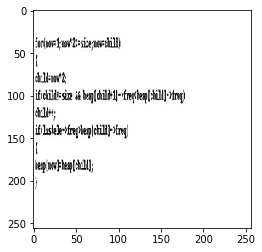

Original label:c, Prediction :python, confidence : 0.619


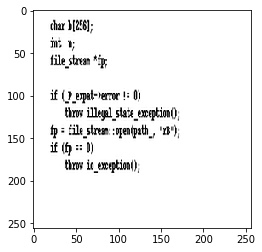

Original label:c, Prediction :cpp, confidence : 0.452


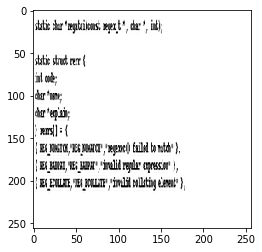

Original label:c, Prediction :python, confidence : 0.406


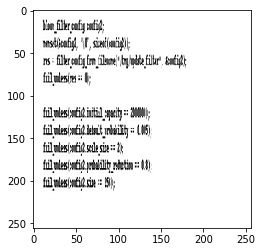

Original label:c, Prediction :cpp, confidence : 0.396


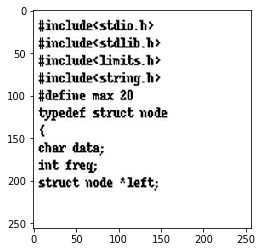

Original label:c, Prediction :java, confidence : 0.721


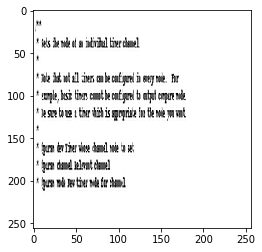

Original label:c, Prediction :cpp, confidence : 0.267


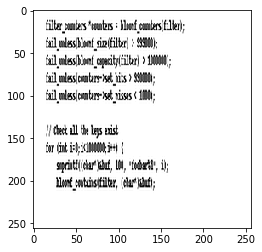

Original label:c, Prediction :java, confidence : 0.511


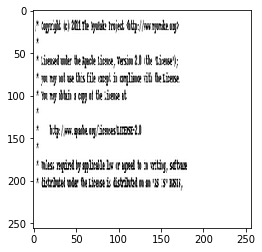

Original label:c, Prediction :java, confidence : 0.702


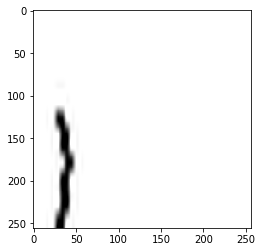

Original label:c, Prediction :python, confidence : 0.688


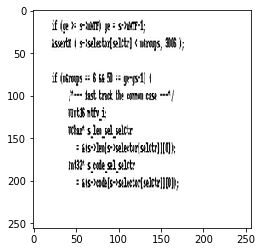

Original label:c, Prediction :python, confidence : 0.649


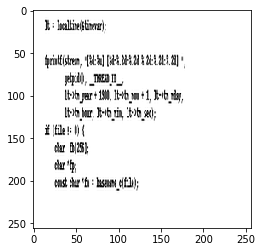

Original label:c, Prediction :cpp, confidence : 0.490


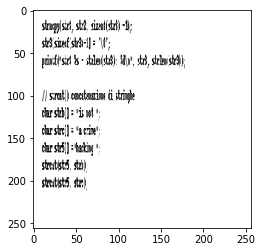

Original label:c, Prediction :java, confidence : 0.702


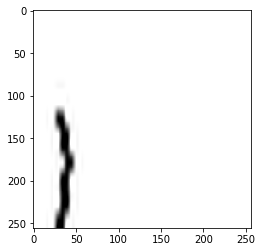

Original label:c, Prediction :java, confidence : 0.545


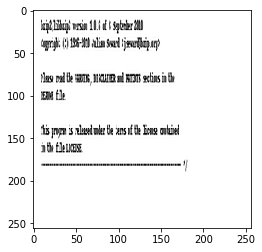

Original label:c, Prediction :python, confidence : 0.501


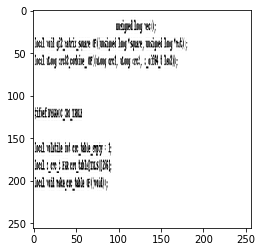

Original label:c, Prediction :cpp, confidence : 0.288


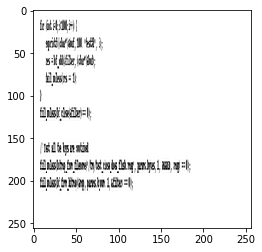

Original label:c, Prediction :python, confidence : 0.335


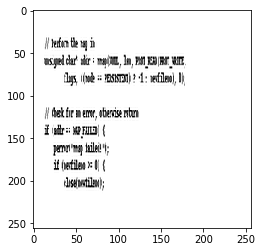

Original label:c, Prediction :python, confidence : 0.566


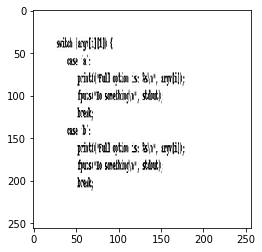

Original label:c, Prediction :python, confidence : 0.537


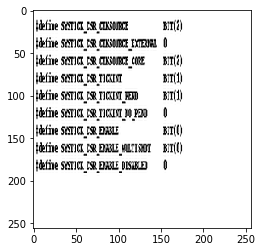

Original label:c, Prediction :cpp, confidence : 0.535


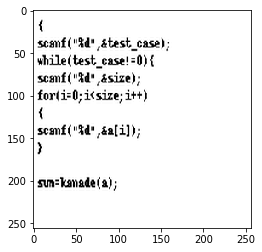

Original label:c, Prediction :python, confidence : 0.805


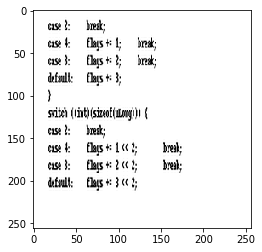

Original label:c, Prediction :java, confidence : 0.980


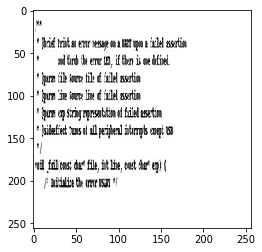

Original label:c, Prediction :python, confidence : 0.567


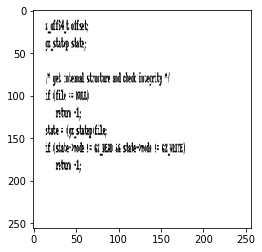

Original label:c, Prediction :java, confidence : 0.803


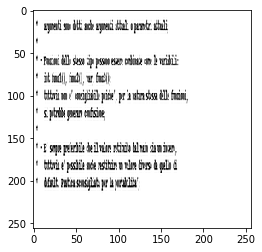

Original label:c, Prediction :python, confidence : 0.414


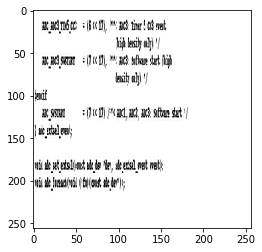

Original label:c, Prediction :java, confidence : 0.265


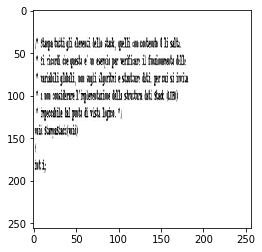

Original label:c, Prediction :cpp, confidence : 0.724


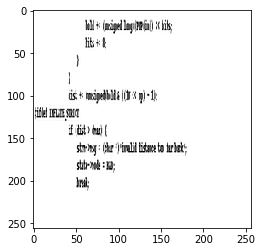

Original label:c, Prediction :cpp, confidence : 0.400


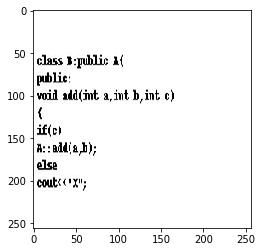

Original label:c, Prediction :python, confidence : 0.417


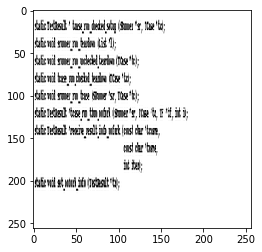

Original label:c, Prediction :python, confidence : 0.571


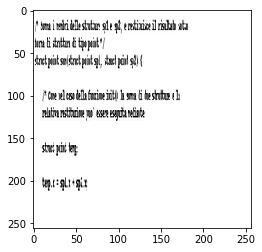

Original label:c, Prediction :java, confidence : 0.396


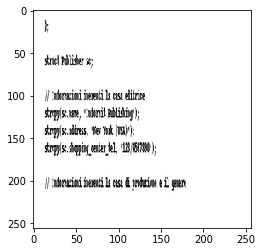

Original label:c, Prediction :java, confidence : 0.702


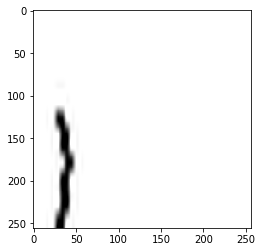

Original label:c, Prediction :cpp, confidence : 0.605


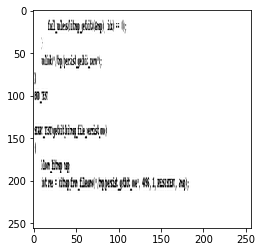

Original label:c, Prediction :python, confidence : 0.822


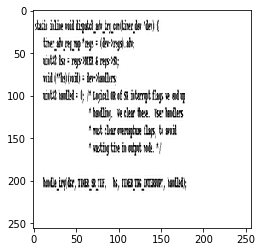

Original label:c, Prediction :python, confidence : 0.720


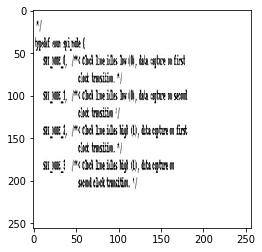

Original label:c, Prediction :python, confidence : 0.535


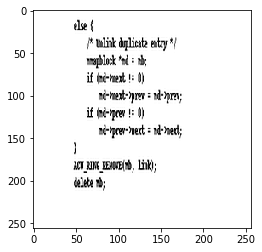

Original label:c, Prediction :java, confidence : 0.548


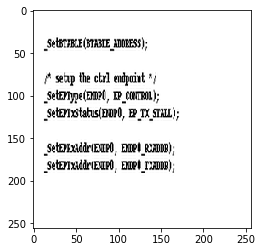

Original label:c, Prediction :cpp, confidence : 0.315


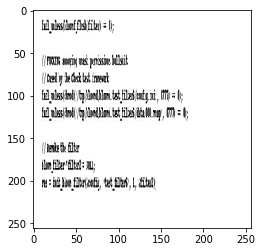

Original label:c, Prediction :java, confidence : 0.702


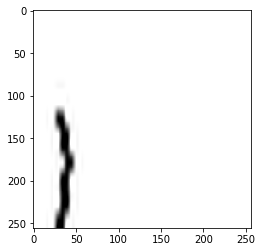

Original label:c, Prediction :java, confidence : 0.377


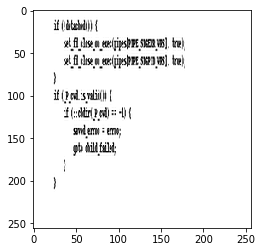

Original label:c, Prediction :python, confidence : 0.264


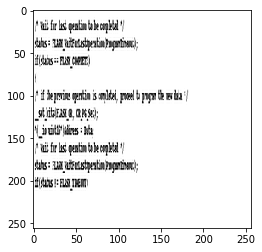

Original label:c, Prediction :cpp, confidence : 0.764


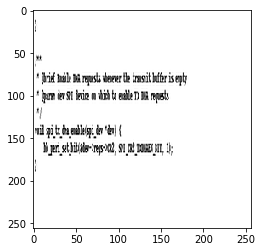

Original label:c, Prediction :java, confidence : 0.755


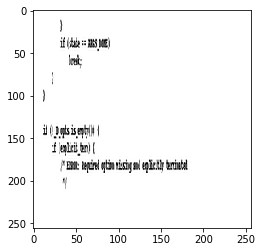

Original label:c, Prediction :python, confidence : 0.738


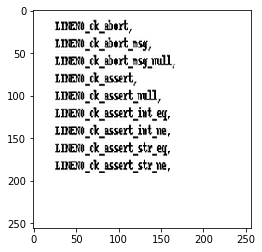

Original label:c, Prediction :cpp, confidence : 0.992


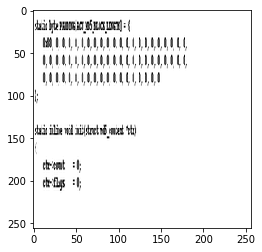

Original label:c, Prediction :java, confidence : 0.461


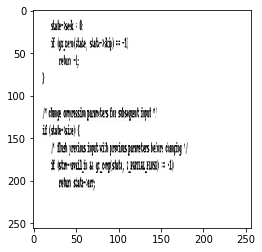

Original label:c, Prediction :python, confidence : 0.699


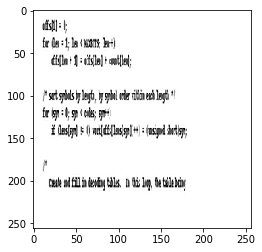

Original label:c, Prediction :python, confidence : 0.379


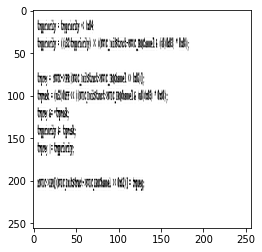

Original label:c, Prediction :python, confidence : 0.294


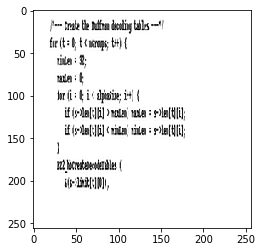

Original label:c, Prediction :python, confidence : 0.508


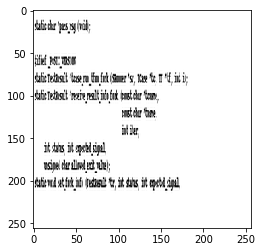

Original label:c, Prediction :java, confidence : 0.469


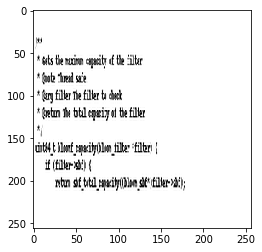

Original label:c, Prediction :python, confidence : 0.579


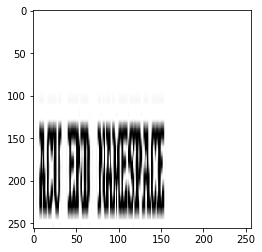

Original label:c, Prediction :java, confidence : 0.568


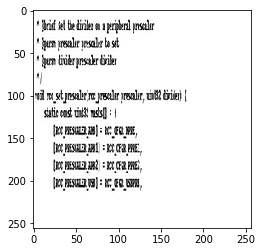

Original label:c, Prediction :cpp, confidence : 0.602


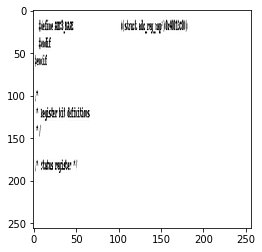

Original label:c, Prediction :python, confidence : 0.428


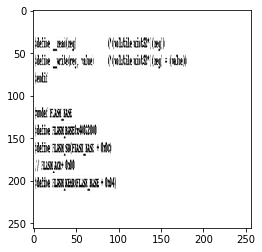

Original label:c, Prediction :python, confidence : 0.592


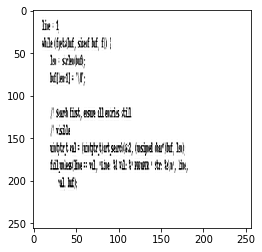

Original label:c, Prediction :cpp, confidence : 0.555


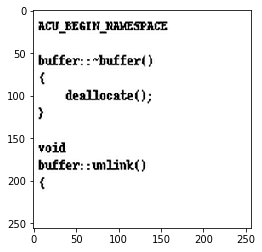

Original label:c, Prediction :java, confidence : 0.302


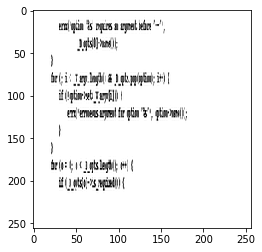

Original label:c, Prediction :java, confidence : 0.437


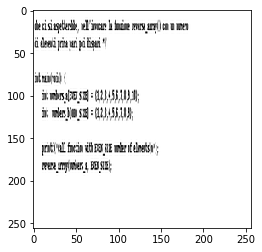

Original label:c, Prediction :java, confidence : 0.370


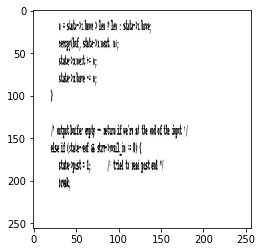

Original label:c, Prediction :java, confidence : 0.462


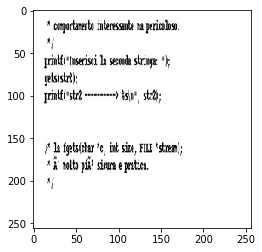

Original label:c, Prediction :python, confidence : 0.507


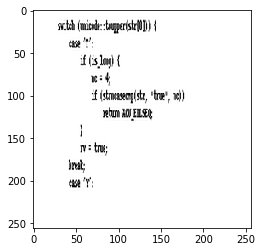

Original label:c, Prediction :python, confidence : 0.988


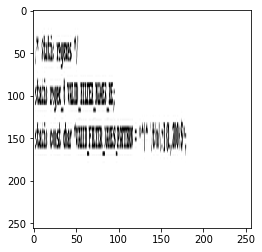

Original label:c, Prediction :python, confidence : 0.962


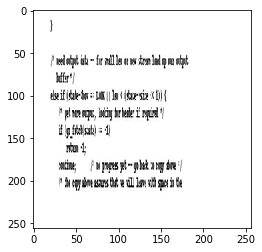

Original label:c, Prediction :cpp, confidence : 0.354


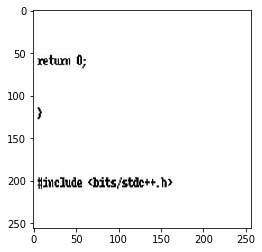

Original label:c, Prediction :cpp, confidence : 0.517


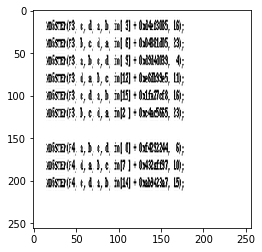

Original label:c, Prediction :python, confidence : 0.852


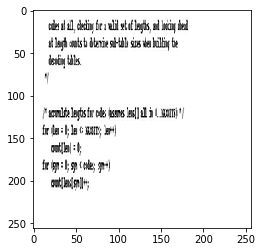

Original label:c, Prediction :cpp, confidence : 0.959


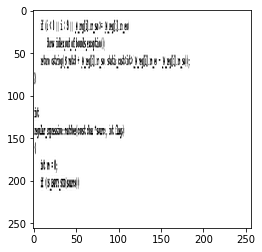

Original label:c, Prediction :python, confidence : 0.509


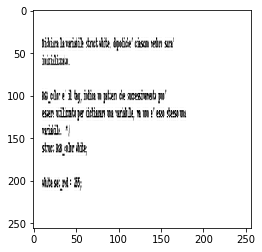

Original label:c, Prediction :python, confidence : 0.411


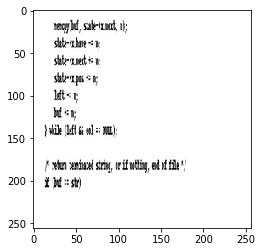

Original label:c, Prediction :java, confidence : 0.702


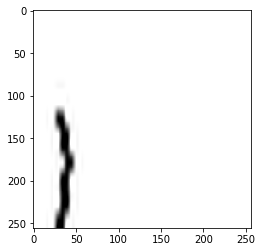

Original label:c, Prediction :python, confidence : 0.801


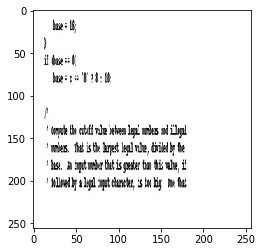

Original label:c, Prediction :java, confidence : 0.440


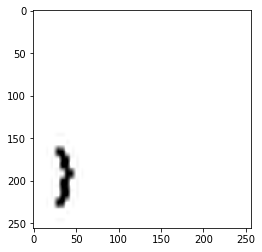

Original label:c, Prediction :java, confidence : 0.300


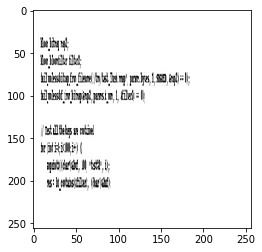

Original label:c, Prediction :java, confidence : 0.975


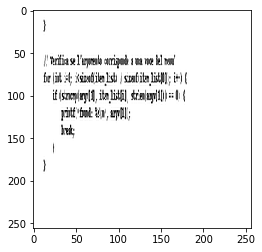

Original label:c, Prediction :python, confidence : 0.298


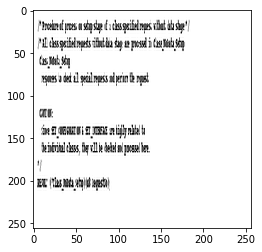

Original label:c, Prediction :cpp, confidence : 0.409


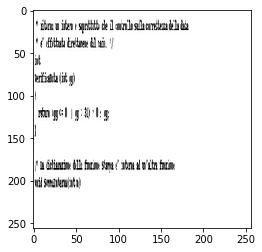

Original label:c, Prediction :cpp, confidence : 0.624


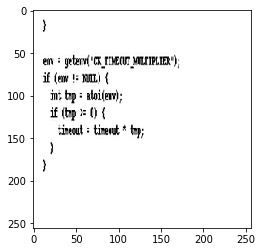

Original label:c, Prediction :java, confidence : 0.586


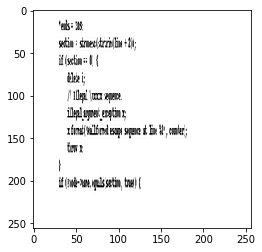

Original label:c, Prediction :java, confidence : 0.702


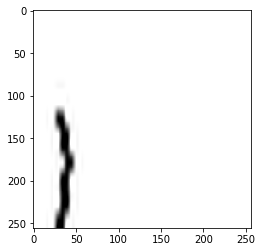

Original label:c, Prediction :python, confidence : 0.584


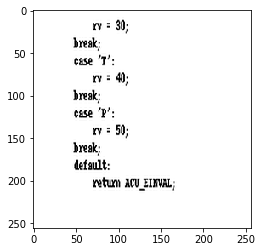

Original label:c, Prediction :java, confidence : 0.336


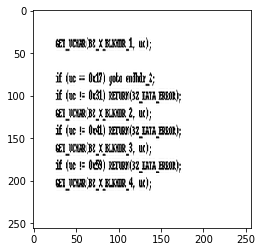

Original label:c, Prediction :java, confidence : 0.545


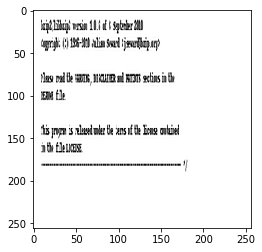

Original label:c, Prediction :python, confidence : 0.806


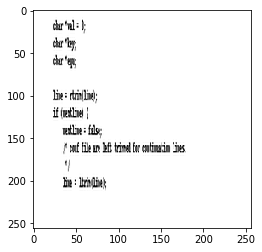

Original label:c, Prediction :cpp, confidence : 0.639


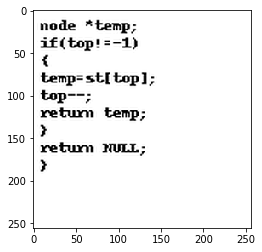

Original label:c, Prediction :python, confidence : 0.897


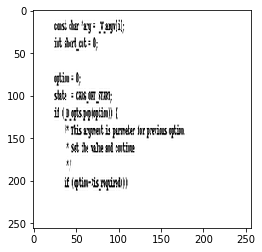

Original label:c, Prediction :python, confidence : 0.857


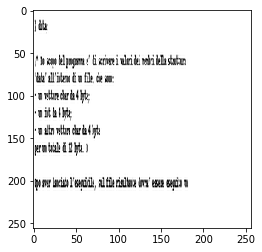

Original label:c, Prediction :python, confidence : 0.624


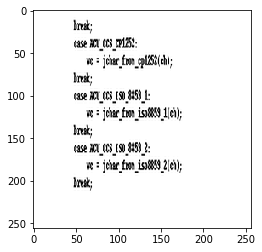

Original label:c, Prediction :cpp, confidence : 0.511


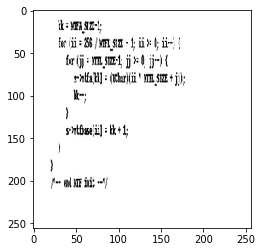

Original label:c, Prediction :python, confidence : 0.432


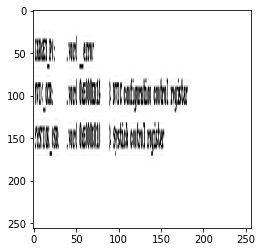

Original label:c, Prediction :java, confidence : 0.482


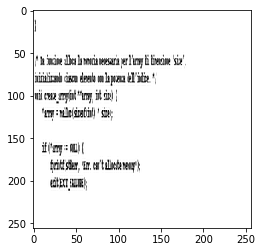

Original label:c, Prediction :python, confidence : 0.364


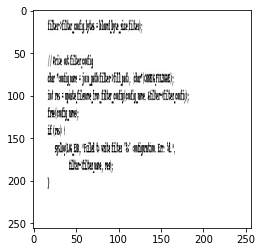

Original label:c, Prediction :python, confidence : 0.704


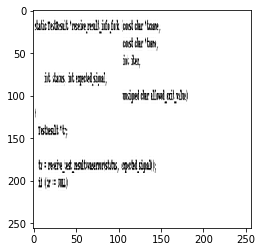

Original label:c, Prediction :python, confidence : 0.356


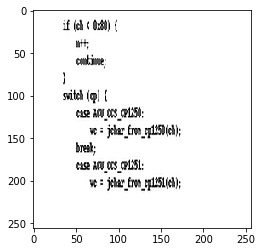

Original label:c, Prediction :python, confidence : 0.784


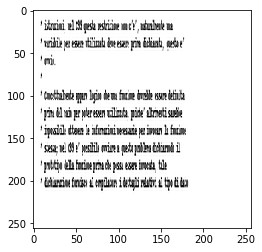

Original label:c, Prediction :cpp, confidence : 0.533


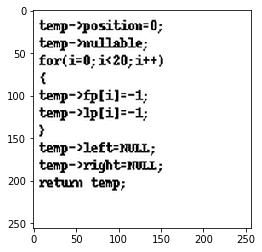

Original label:c, Prediction :python, confidence : 0.360


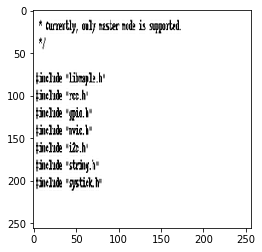

Original label:c, Prediction :python, confidence : 0.589


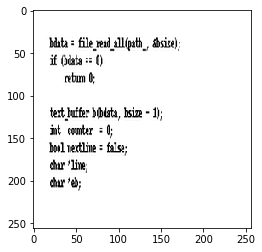

Original label:c, Prediction :python, confidence : 0.451


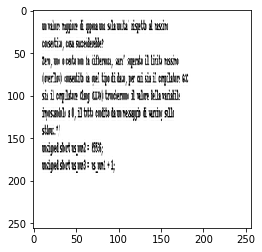

Original label:c, Prediction :python, confidence : 0.415


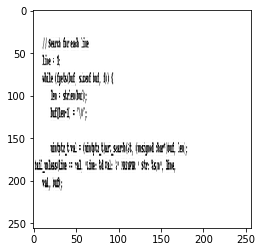

Original label:c, Prediction :cpp, confidence : 0.394


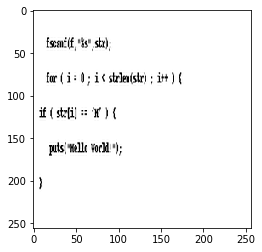

Original label:c, Prediction :cpp, confidence : 0.373


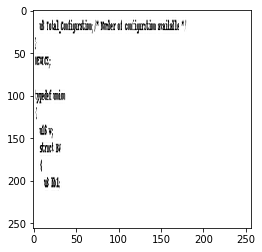

Original label:c, Prediction :java, confidence : 0.744


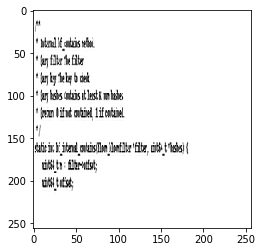

Original label:c, Prediction :python, confidence : 0.671


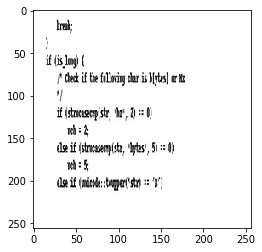

Original label:c, Prediction :cpp, confidence : 0.540


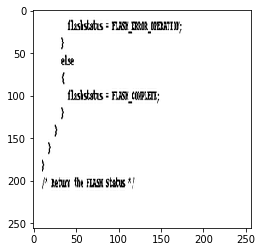

Original label:c, Prediction :java, confidence : 0.571


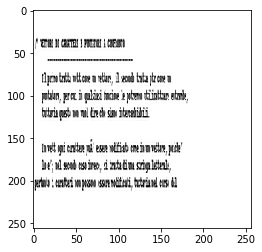

Original label:c, Prediction :python, confidence : 0.460


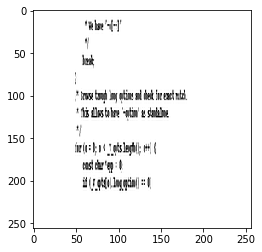

Original label:c, Prediction :cpp, confidence : 0.488


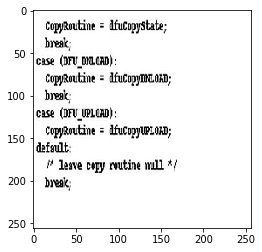

Original label:c, Prediction :java, confidence : 0.963


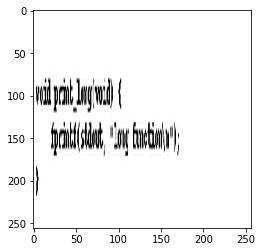

Original label:c, Prediction :java, confidence : 0.641


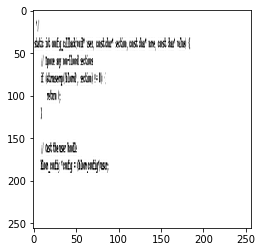

Original label:c, Prediction :java, confidence : 0.649


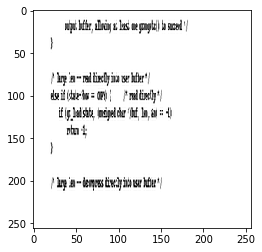

Original label:c, Prediction :python, confidence : 0.489


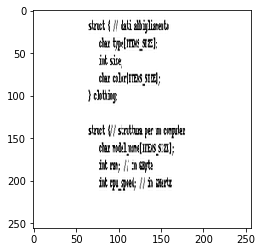

Original label:c, Prediction :java, confidence : 0.636


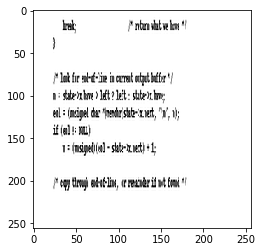

Original label:c, Prediction :python, confidence : 0.375


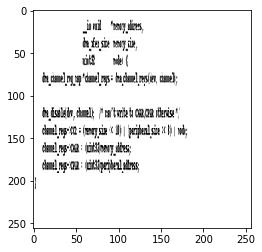

Original label:c, Prediction :cpp, confidence : 0.874


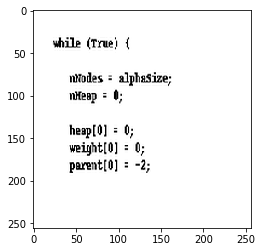

Original label:c, Prediction :python, confidence : 0.650


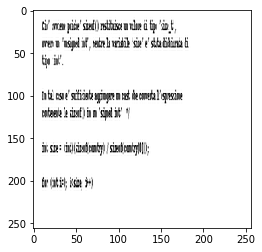

Original label:c, Prediction :java, confidence : 0.702


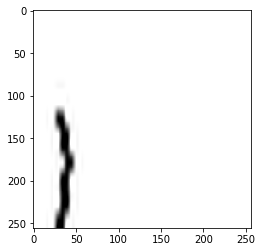

Original label:c, Prediction :python, confidence : 0.450


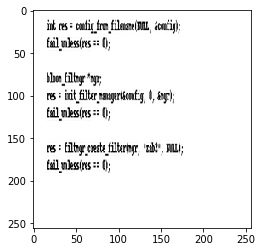

Original label:c, Prediction :java, confidence : 0.987


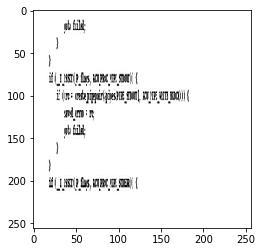

Original label:c, Prediction :cpp, confidence : 0.477


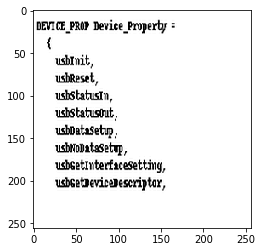

Original label:c, Prediction :python, confidence : 0.504


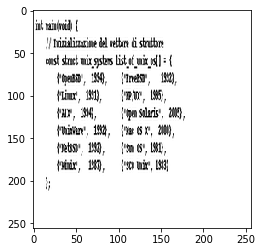

Original label:c, Prediction :python, confidence : 0.434


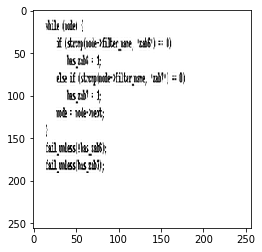

Original label:c, Prediction :cpp, confidence : 0.535


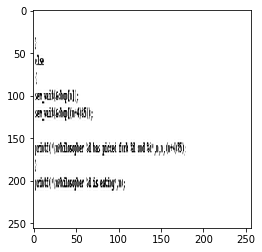

Original label:c, Prediction :python, confidence : 0.480


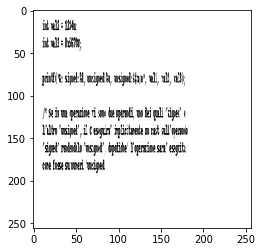

Original label:c, Prediction :java, confidence : 0.347


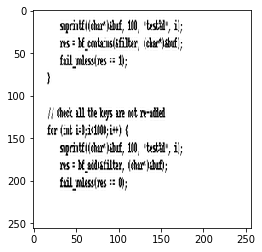

Original label:c, Prediction :python, confidence : 0.292


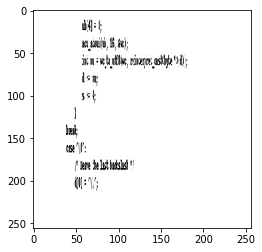

Original label:c, Prediction :python, confidence : 0.783


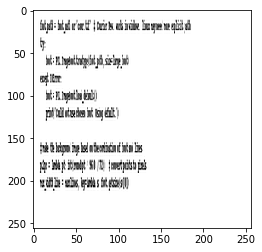

Original label:c, Prediction :python, confidence : 0.499


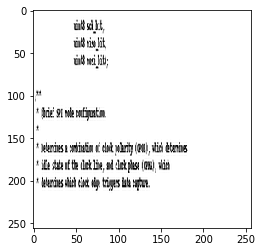

Original label:c, Prediction :python, confidence : 0.489


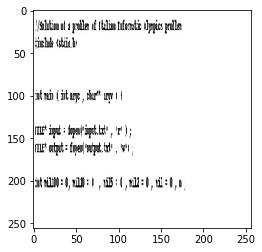

Original label:c, Prediction :python, confidence : 0.290


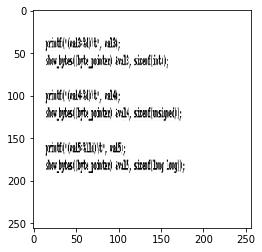

Original label:c, Prediction :java, confidence : 0.862


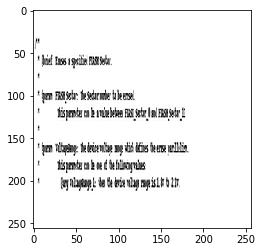

Original label:c, Prediction :cpp, confidence : 0.845


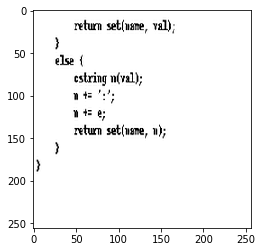

Original label:c, Prediction :cpp, confidence : 0.521


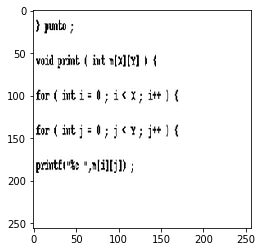

Original label:c, Prediction :java, confidence : 0.382


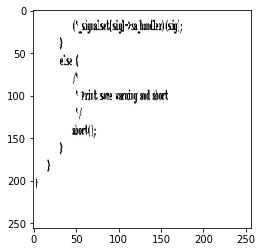

Original label:c, Prediction :python, confidence : 0.908


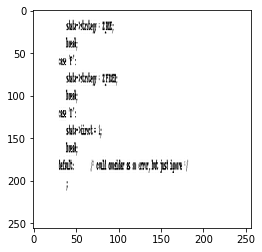

Original label:c, Prediction :cpp, confidence : 0.571


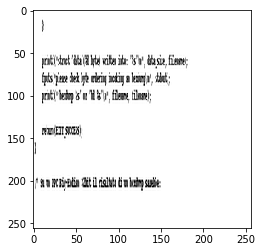

Original label:c, Prediction :java, confidence : 0.442


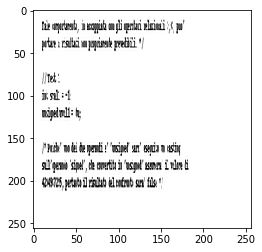

Original label:c, Prediction :python, confidence : 0.296


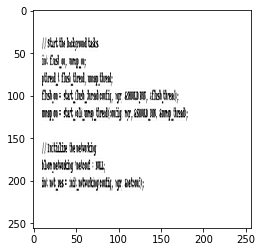

Original label:c, Prediction :cpp, confidence : 0.313


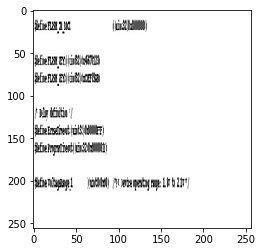

Original label:c, Prediction :cpp, confidence : 0.533


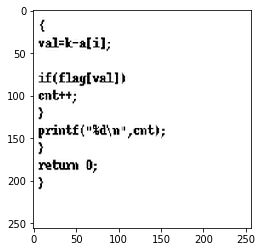

Original label:c, Prediction :python, confidence : 0.991


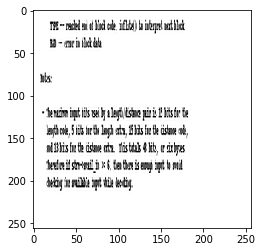

Original label:c, Prediction :cpp, confidence : 0.452


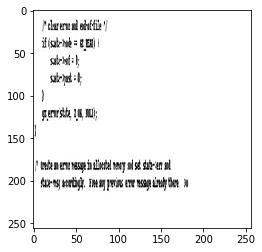

Original label:c, Prediction :java, confidence : 0.494


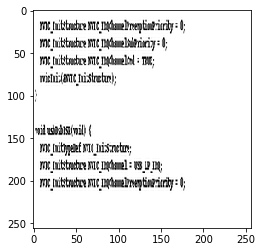

Original label:c, Prediction :cpp, confidence : 0.445


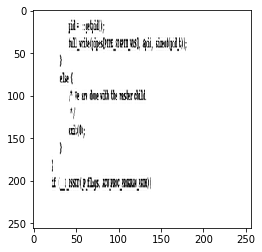

Original label:c, Prediction :cpp, confidence : 0.651


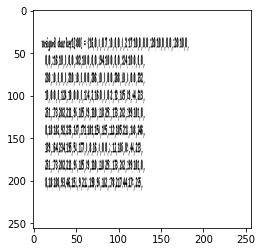

Original label:c, Prediction :java, confidence : 0.980


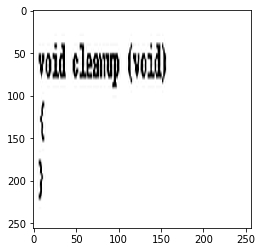

Original label:c, Prediction :cpp, confidence : 0.730


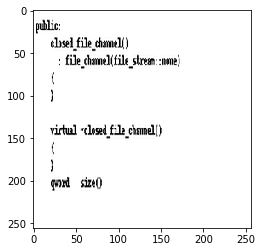

Original label:c, Prediction :python, confidence : 0.429


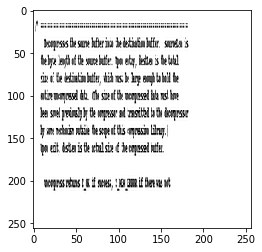

Original label:c, Prediction :java, confidence : 0.724


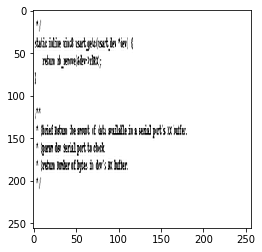

Original label:c, Prediction :python, confidence : 0.504


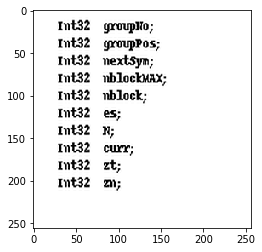

Original label:c, Prediction :java, confidence : 1.000


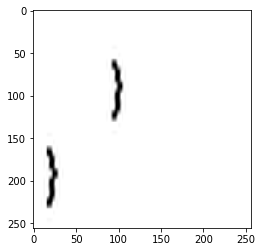

Original label:c, Prediction :python, confidence : 0.497


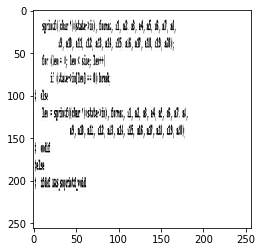

Original label:c, Prediction :python, confidence : 0.479


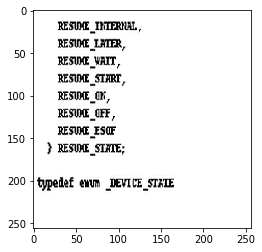

Original label:c, Prediction :python, confidence : 0.548


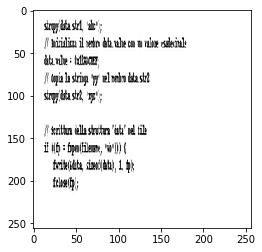

Original label:c, Prediction :cpp, confidence : 0.416


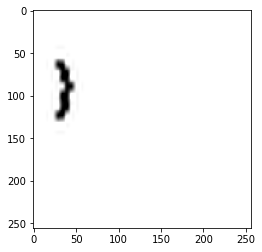

Original label:c, Prediction :java, confidence : 0.415


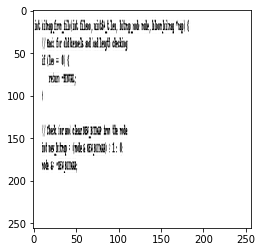

Original label:c, Prediction :java, confidence : 0.440


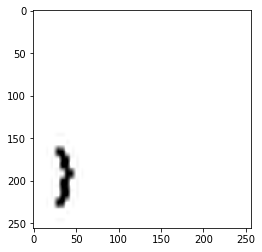

Original label:c, Prediction :cpp, confidence : 0.556


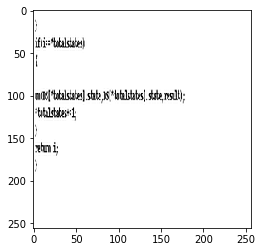

Original label:c, Prediction :cpp, confidence : 0.387


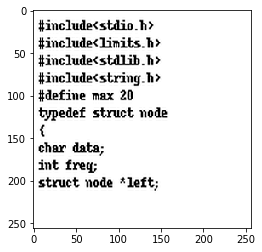

Original label:c, Prediction :cpp, confidence : 0.479


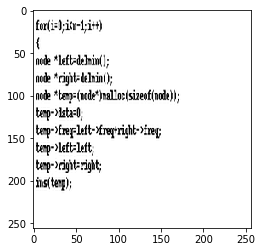

Original label:c, Prediction :python, confidence : 0.480


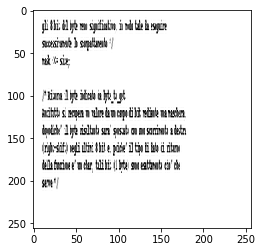

Original label:c, Prediction :python, confidence : 0.672


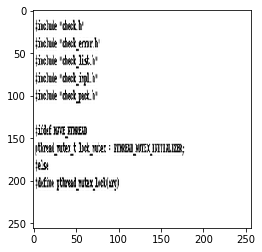

Original label:c, Prediction :python, confidence : 0.930


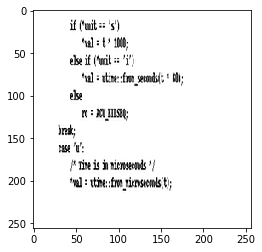

Original label:c, Prediction :cpp, confidence : 0.747


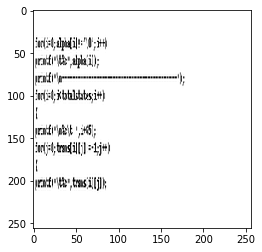

Original label:c, Prediction :python, confidence : 0.928


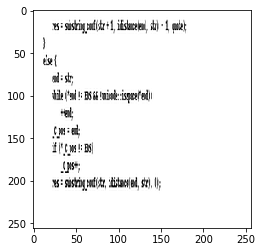

Original label:c, Prediction :python, confidence : 0.771


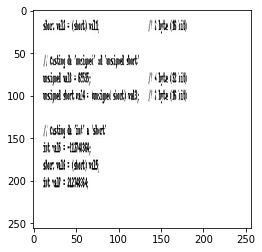

Original label:c, Prediction :java, confidence : 0.304


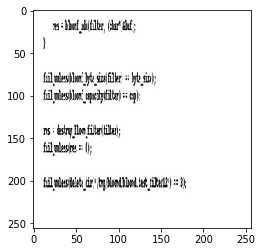

Original label:cpp, Prediction :c, confidence : 0.713


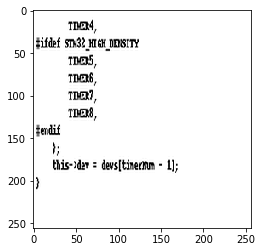

Original label:cpp, Prediction :c, confidence : 0.665


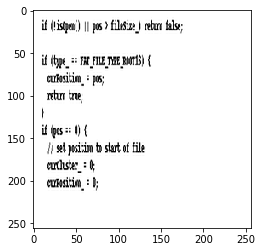

Original label:cpp, Prediction :java, confidence : 0.741


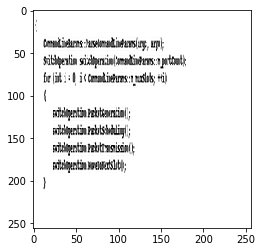

Original label:cpp, Prediction :c, confidence : 0.696


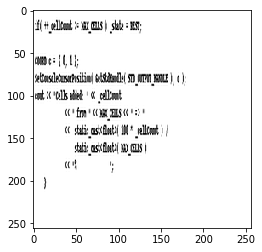

Original label:cpp, Prediction :java, confidence : 0.688


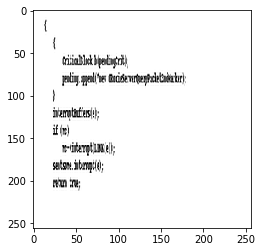

Original label:cpp, Prediction :java, confidence : 0.448


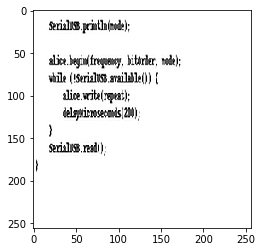

Original label:cpp, Prediction :c, confidence : 0.786


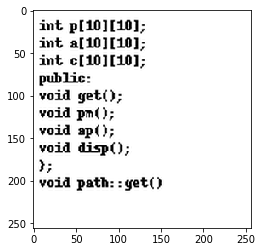

Original label:cpp, Prediction :java, confidence : 0.507


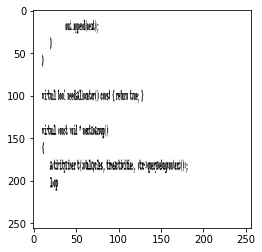

Original label:cpp, Prediction :java, confidence : 0.463


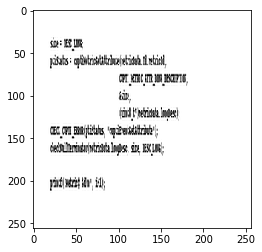

Original label:cpp, Prediction :c, confidence : 0.273


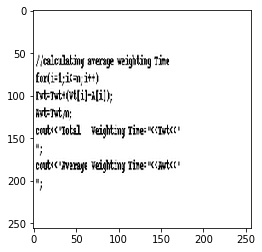

Original label:cpp, Prediction :c, confidence : 0.898


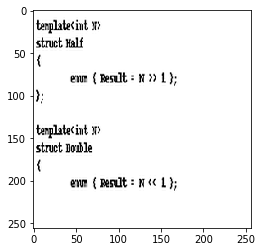

Original label:cpp, Prediction :c, confidence : 0.478


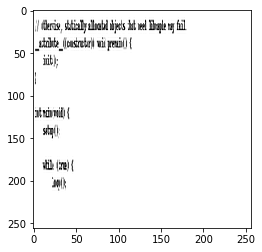

Original label:cpp, Prediction :python, confidence : 0.468


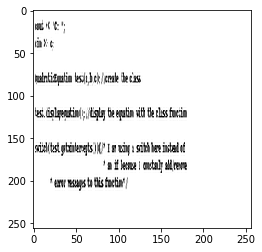

Original label:cpp, Prediction :java, confidence : 0.813


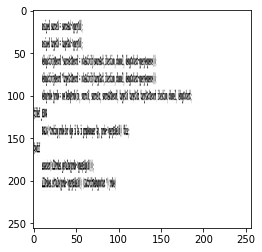

Original label:cpp, Prediction :c, confidence : 0.522


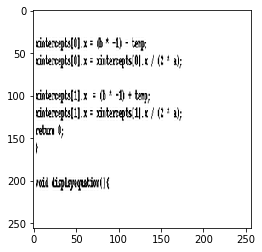

Original label:cpp, Prediction :c, confidence : 0.640


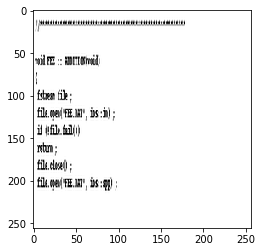

Original label:cpp, Prediction :c, confidence : 0.273


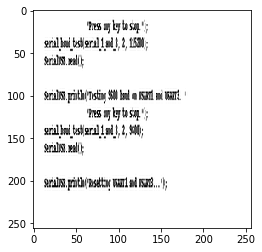

Original label:cpp, Prediction :java, confidence : 0.677


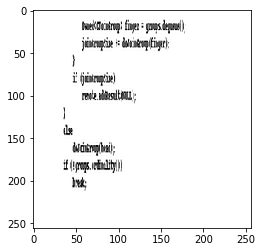

Original label:cpp, Prediction :java, confidence : 0.351


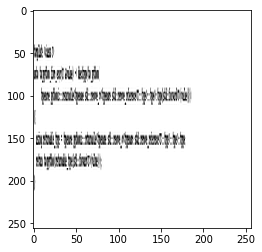

Original label:cpp, Prediction :c, confidence : 0.702


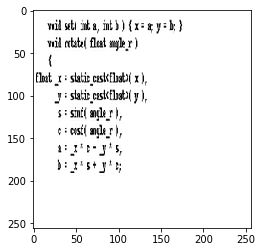

Original label:cpp, Prediction :c, confidence : 0.695


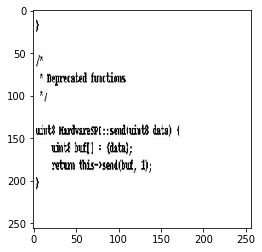

Original label:cpp, Prediction :c, confidence : 0.442


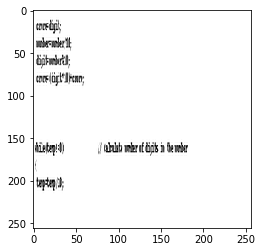

Original label:cpp, Prediction :c, confidence : 0.324


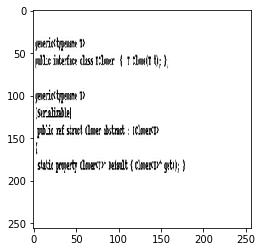

Original label:cpp, Prediction :c, confidence : 0.435


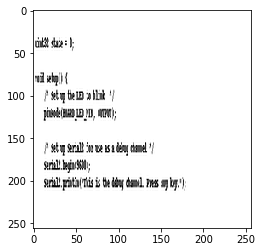

Original label:cpp, Prediction :java, confidence : 0.449


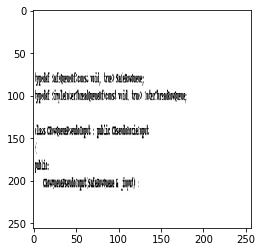

Original label:cpp, Prediction :c, confidence : 0.344


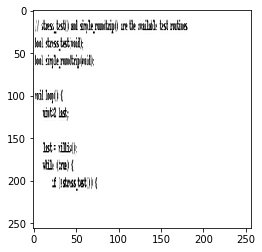

Original label:cpp, Prediction :c, confidence : 0.483


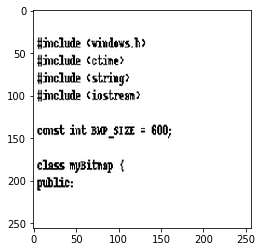

Original label:cpp, Prediction :c, confidence : 0.313


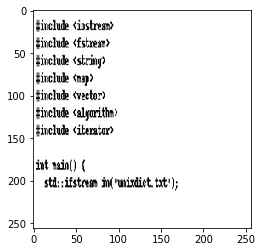

Original label:cpp, Prediction :c, confidence : 0.578


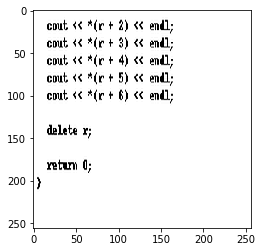

Original label:cpp, Prediction :c, confidence : 0.385


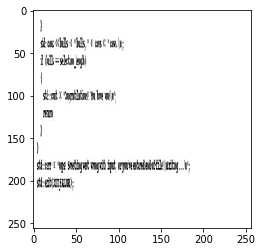

Original label:cpp, Prediction :c, confidence : 0.477


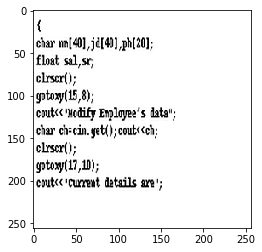

Original label:cpp, Prediction :c, confidence : 0.742


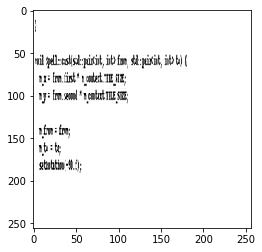

Original label:cpp, Prediction :java, confidence : 0.488


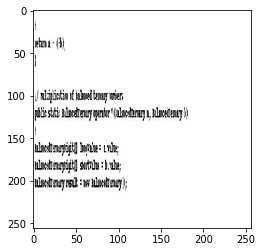

Original label:cpp, Prediction :c, confidence : 0.388


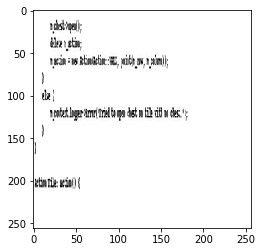

Original label:cpp, Prediction :python, confidence : 0.596


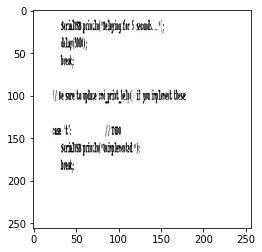

Original label:cpp, Prediction :c, confidence : 0.409


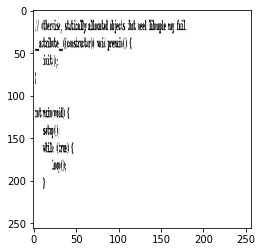

Original label:cpp, Prediction :c, confidence : 0.503


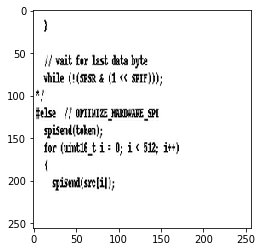

Original label:cpp, Prediction :c, confidence : 0.642


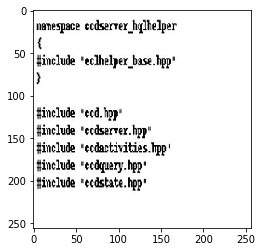

Original label:cpp, Prediction :java, confidence : 0.829


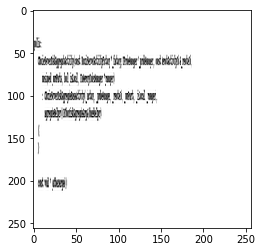

Original label:cpp, Prediction :python, confidence : 0.386


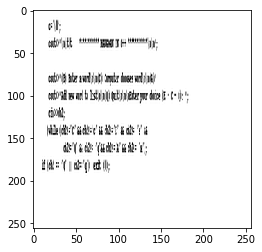

Original label:cpp, Prediction :c, confidence : 0.577


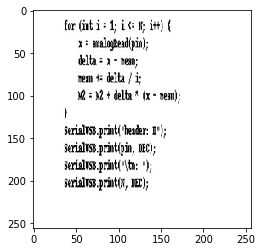

Original label:cpp, Prediction :c, confidence : 0.428


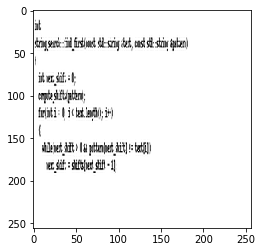

Original label:cpp, Prediction :c, confidence : 0.520


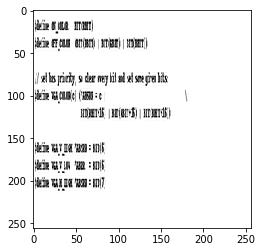

Original label:cpp, Prediction :c, confidence : 0.835


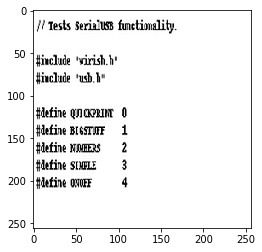

Original label:cpp, Prediction :python, confidence : 0.392


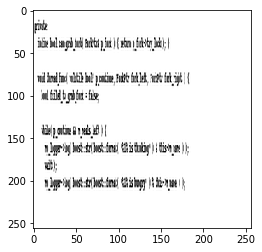

Original label:cpp, Prediction :c, confidence : 0.850


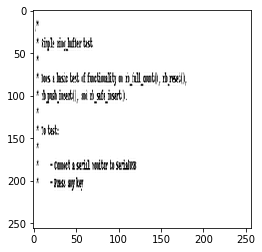

Original label:cpp, Prediction :python, confidence : 0.998


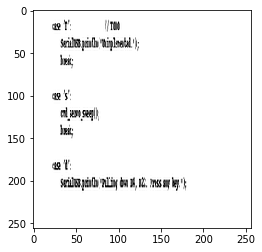

Original label:cpp, Prediction :python, confidence : 0.365


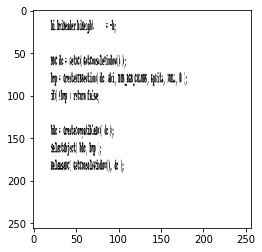

Original label:cpp, Prediction :java, confidence : 0.321


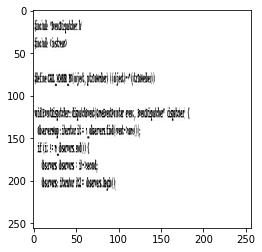

Original label:cpp, Prediction :c, confidence : 0.734


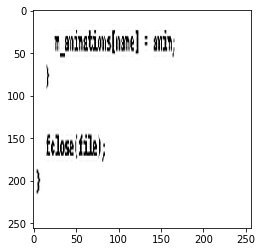

Original label:cpp, Prediction :c, confidence : 0.494


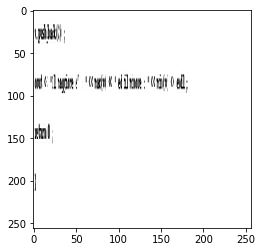

Original label:cpp, Prediction :c, confidence : 0.635


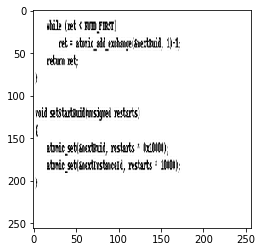

Original label:cpp, Prediction :c, confidence : 0.924


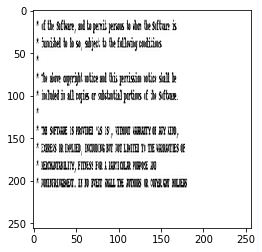

Original label:cpp, Prediction :c, confidence : 0.573


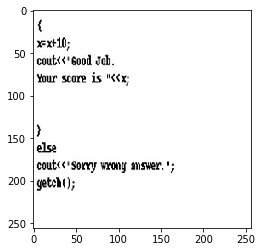

Original label:cpp, Prediction :python, confidence : 0.620


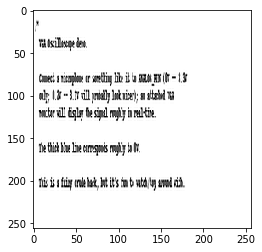

Original label:cpp, Prediction :c, confidence : 0.511


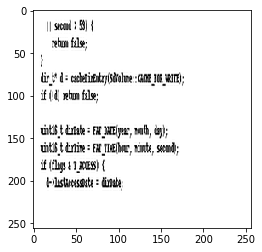

Original label:cpp, Prediction :c, confidence : 0.380


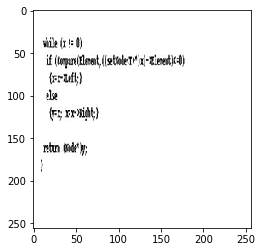

Original label:cpp, Prediction :c, confidence : 0.624


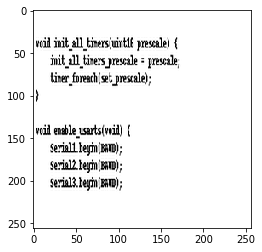

Original label:cpp, Prediction :c, confidence : 0.445


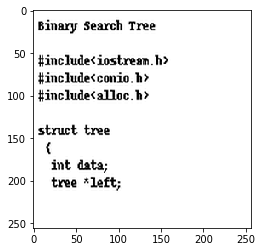

Original label:cpp, Prediction :python, confidence : 0.398


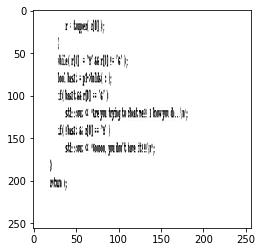

Original label:cpp, Prediction :c, confidence : 0.601


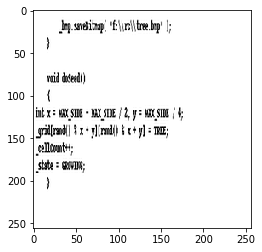

Original label:cpp, Prediction :java, confidence : 0.533


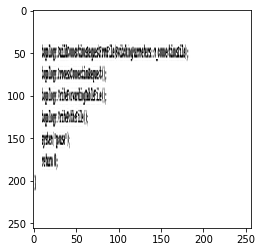

Original label:cpp, Prediction :java, confidence : 0.652


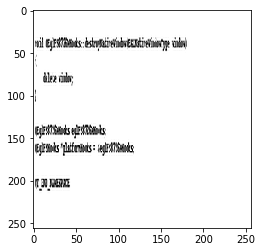

Original label:cpp, Prediction :c, confidence : 0.360


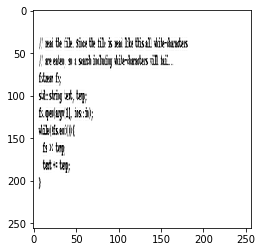

Original label:cpp, Prediction :java, confidence : 0.265


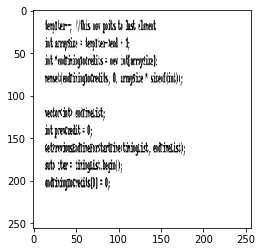

Original label:cpp, Prediction :c, confidence : 0.476


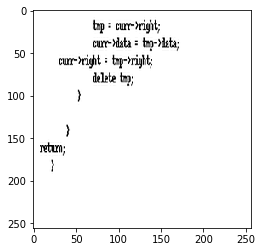

Original label:cpp, Prediction :c, confidence : 0.924


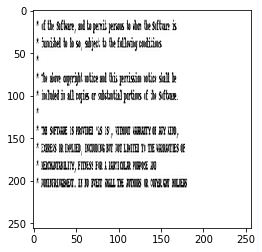

Original label:cpp, Prediction :c, confidence : 0.365


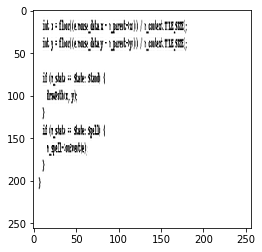

Original label:cpp, Prediction :c, confidence : 0.541


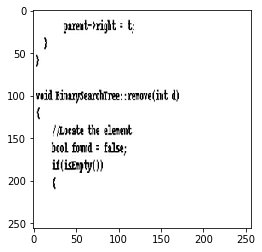

Original label:cpp, Prediction :c, confidence : 0.390


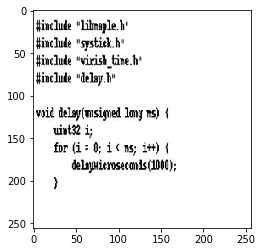

Original label:cpp, Prediction :java, confidence : 0.465


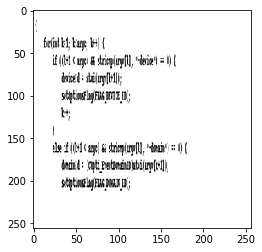

Original label:cpp, Prediction :java, confidence : 0.411


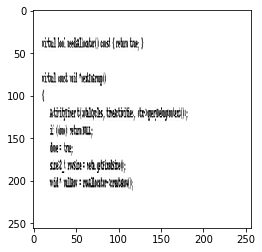

Original label:cpp, Prediction :c, confidence : 0.645


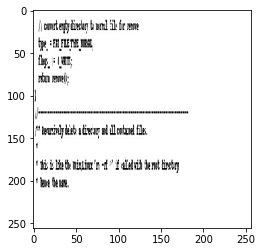

Original label:cpp, Prediction :c, confidence : 0.770


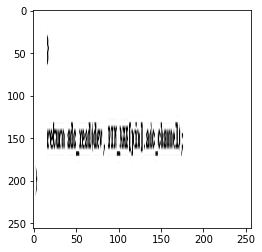

Original label:cpp, Prediction :c, confidence : 0.558


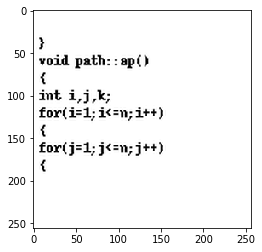

Original label:cpp, Prediction :c, confidence : 0.746


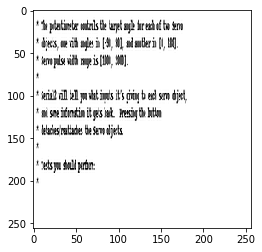

Original label:cpp, Prediction :java, confidence : 0.272


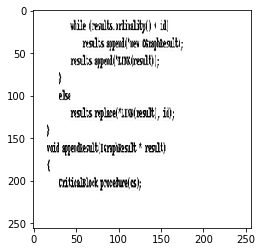

Original label:cpp, Prediction :c, confidence : 0.586


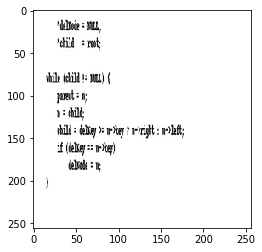

Original label:cpp, Prediction :c, confidence : 0.410


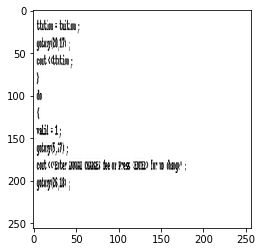

Original label:cpp, Prediction :c, confidence : 0.358


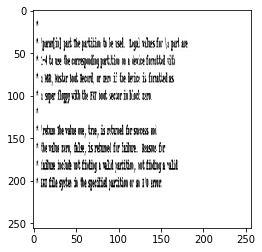

Original label:cpp, Prediction :java, confidence : 0.662


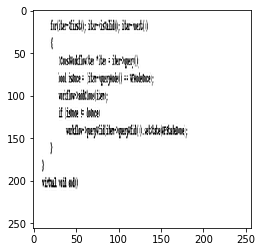

Original label:cpp, Prediction :python, confidence : 0.358


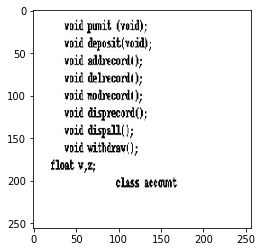

Original label:cpp, Prediction :c, confidence : 0.692


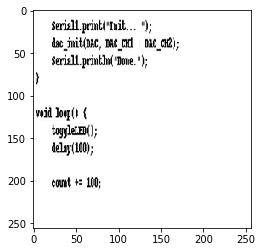

Original label:cpp, Prediction :java, confidence : 0.510


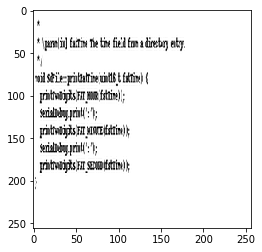

Original label:cpp, Prediction :c, confidence : 0.647


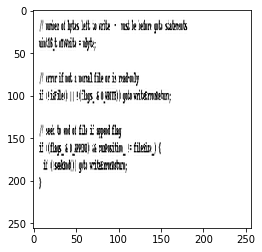

Original label:cpp, Prediction :java, confidence : 0.305


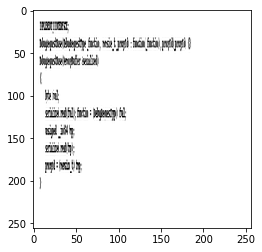

Original label:cpp, Prediction :c, confidence : 0.329


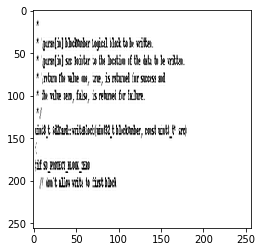

Original label:cpp, Prediction :c, confidence : 0.665


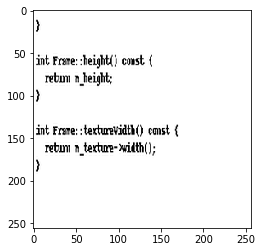

Original label:cpp, Prediction :c, confidence : 0.569


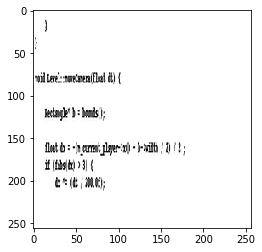

Original label:cpp, Prediction :c, confidence : 0.603


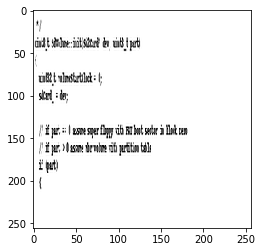

Original label:cpp, Prediction :python, confidence : 0.315


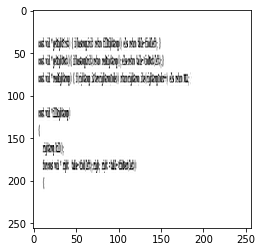

Original label:cpp, Prediction :c, confidence : 0.663


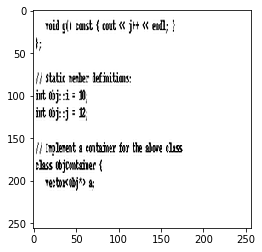

Original label:cpp, Prediction :c, confidence : 0.470


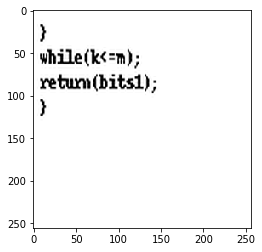

Original label:cpp, Prediction :python, confidence : 0.513


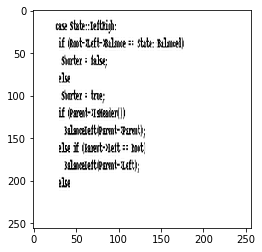

Original label:cpp, Prediction :c, confidence : 0.399


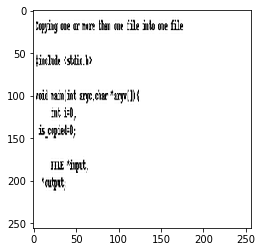

Original label:cpp, Prediction :java, confidence : 0.511


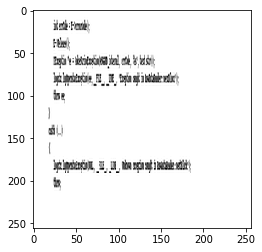

Original label:cpp, Prediction :java, confidence : 0.671


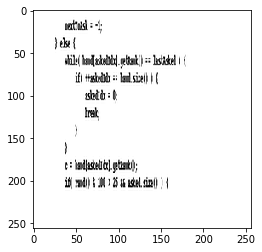

Original label:cpp, Prediction :c, confidence : 0.568


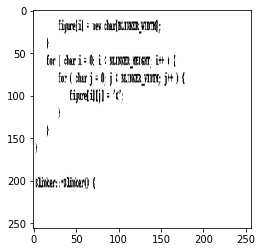

Original label:cpp, Prediction :python, confidence : 0.511


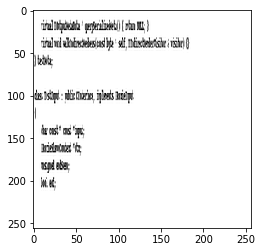

Original label:cpp, Prediction :c, confidence : 0.841


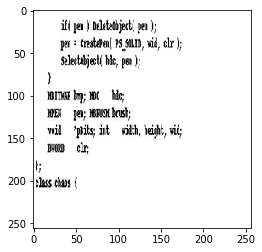

Original label:cpp, Prediction :c, confidence : 0.549


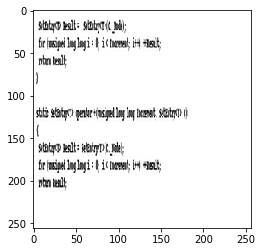

Original label:cpp, Prediction :python, confidence : 0.261


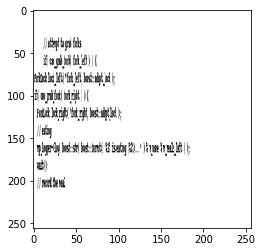

Original label:cpp, Prediction :c, confidence : 0.595


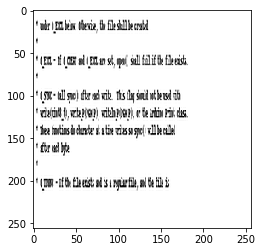

Original label:cpp, Prediction :c, confidence : 0.486


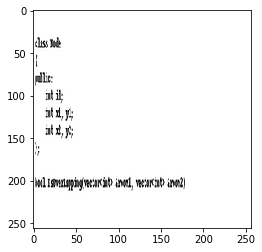

Original label:cpp, Prediction :c, confidence : 0.484


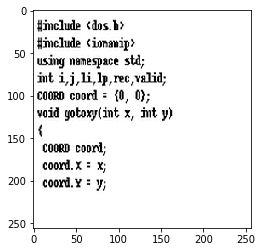

Original label:cpp, Prediction :c, confidence : 0.343


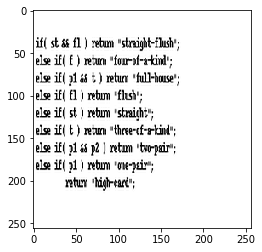

Original label:cpp, Prediction :c, confidence : 0.491


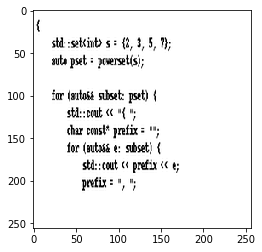

Original label:cpp, Prediction :c, confidence : 0.685


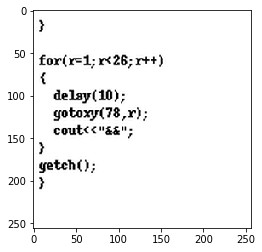

Original label:cpp, Prediction :python, confidence : 0.307


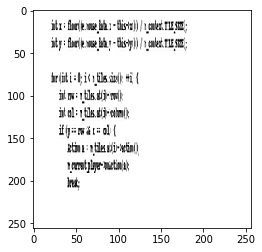

Original label:cpp, Prediction :java, confidence : 0.771


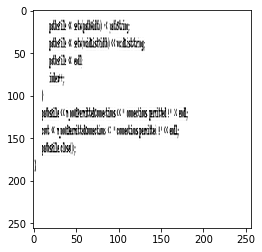

Original label:cpp, Prediction :c, confidence : 0.664


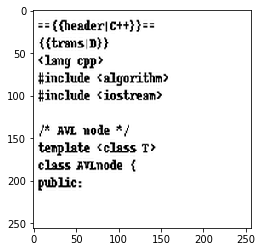

Original label:cpp, Prediction :c, confidence : 0.386


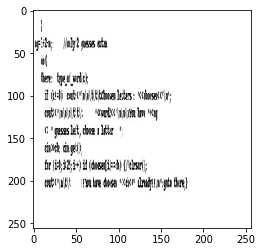

Original label:cpp, Prediction :c, confidence : 0.832


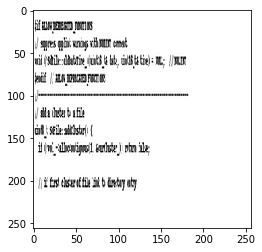

Original label:cpp, Prediction :java, confidence : 0.526


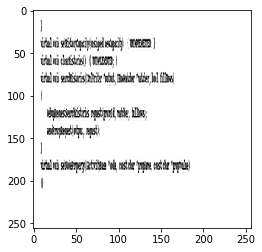

Original label:cpp, Prediction :c, confidence : 0.451


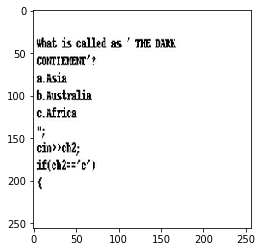

Original label:cpp, Prediction :c, confidence : 0.722


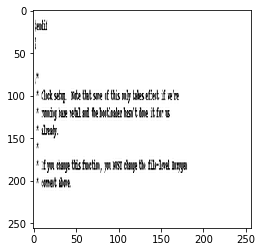

Original label:cpp, Prediction :java, confidence : 0.637


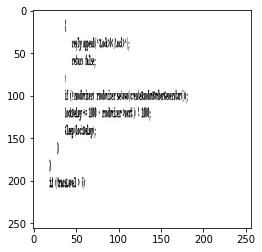

Original label:cpp, Prediction :python, confidence : 0.293


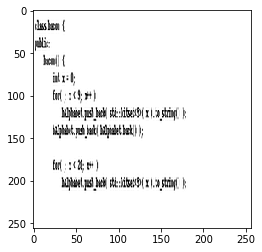

Original label:cpp, Prediction :c, confidence : 0.487


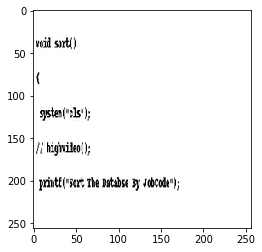

Original label:cpp, Prediction :c, confidence : 0.282


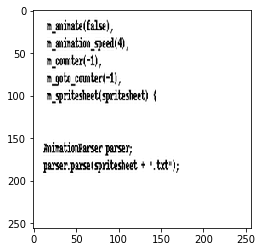

Original label:cpp, Prediction :python, confidence : 0.787


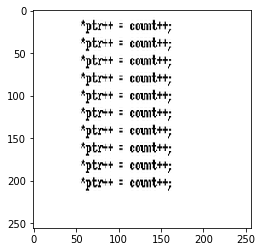

Original label:cpp, Prediction :c, confidence : 0.527


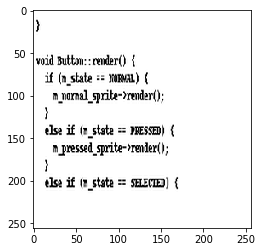

Original label:cpp, Prediction :c, confidence : 0.836


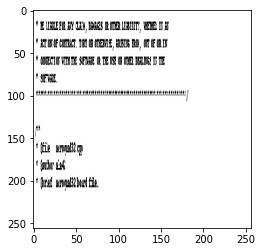

Original label:cpp, Prediction :c, confidence : 0.524


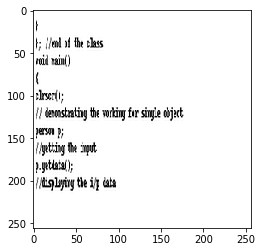

Original label:cpp, Prediction :c, confidence : 0.567


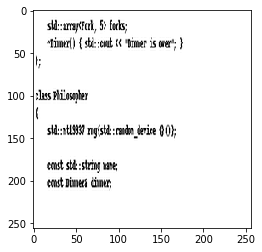

Original label:cpp, Prediction :c, confidence : 0.318


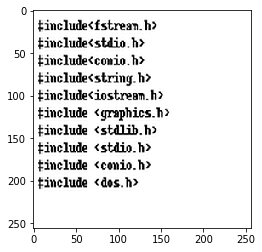

Original label:cpp, Prediction :c, confidence : 0.619


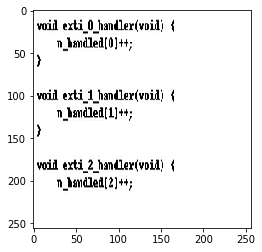

Original label:cpp, Prediction :java, confidence : 0.496


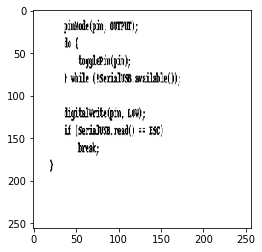

Original label:cpp, Prediction :c, confidence : 0.512


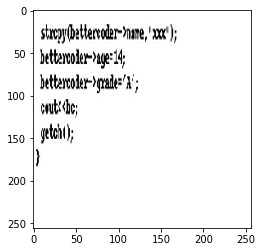

Original label:cpp, Prediction :c, confidence : 0.417


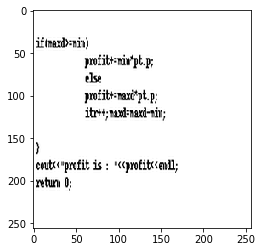

Original label:cpp, Prediction :c, confidence : 0.777


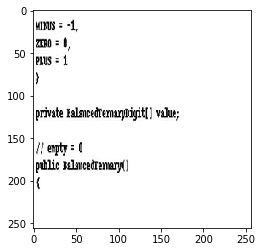

Original label:cpp, Prediction :c, confidence : 0.434


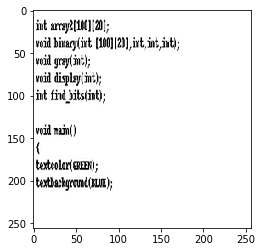

Original label:cpp, Prediction :c, confidence : 0.303


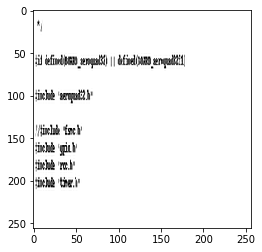

Original label:cpp, Prediction :c, confidence : 0.871


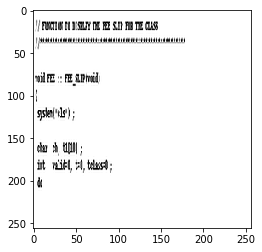

Original label:cpp, Prediction :c, confidence : 0.543


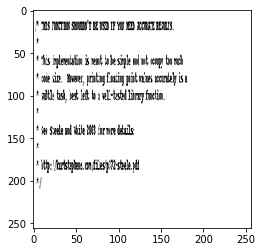

Original label:cpp, Prediction :c, confidence : 0.277


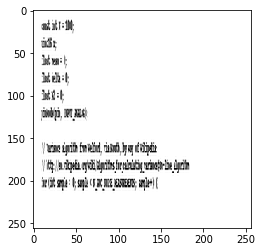

Original label:cpp, Prediction :c, confidence : 0.262


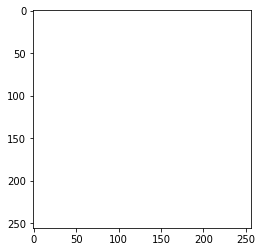

Original label:cpp, Prediction :c, confidence : 0.587


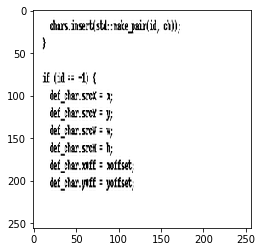

Original label:cpp, Prediction :c, confidence : 0.805


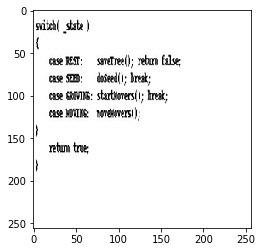

Original label:cpp, Prediction :java, confidence : 0.533


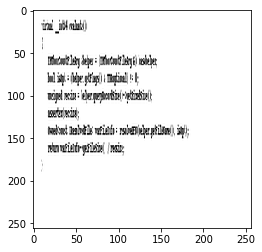

Original label:cpp, Prediction :c, confidence : 0.631


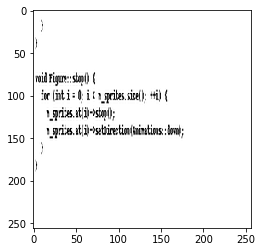

Original label:cpp, Prediction :c, confidence : 0.448


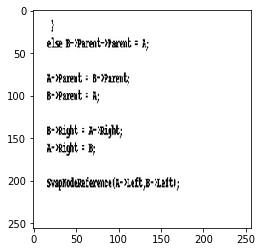

Original label:cpp, Prediction :c, confidence : 0.646


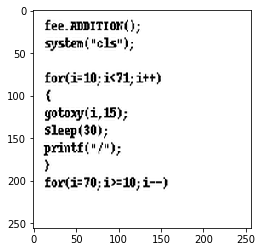

Original label:cpp, Prediction :c, confidence : 0.582


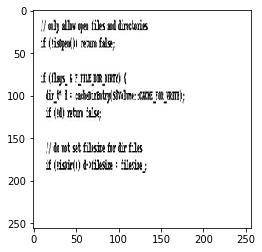

Original label:cpp, Prediction :c, confidence : 0.861


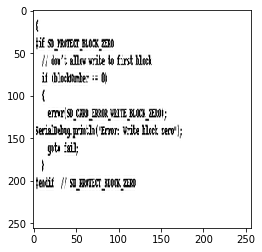

Original label:cpp, Prediction :c, confidence : 0.570


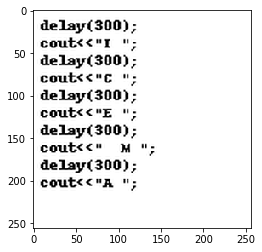

Original label:cpp, Prediction :c, confidence : 0.547


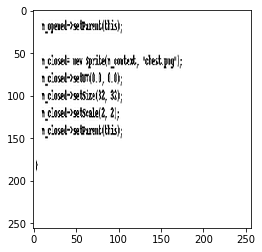

Original label:cpp, Prediction :c, confidence : 0.302


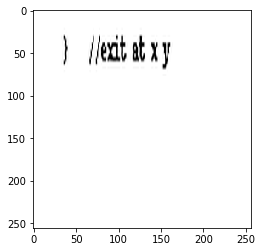

Original label:cpp, Prediction :c, confidence : 0.698


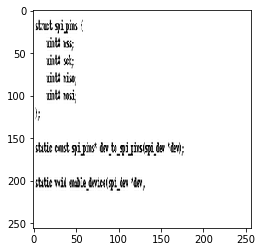

Original label:cpp, Prediction :c, confidence : 0.609


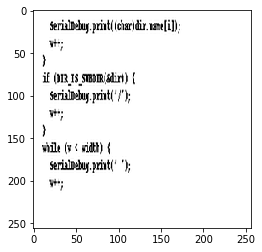

Original label:cpp, Prediction :c, confidence : 0.852


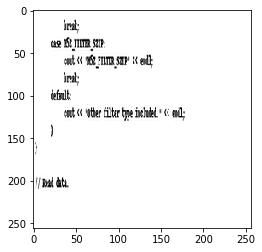

Original label:cpp, Prediction :c, confidence : 0.280


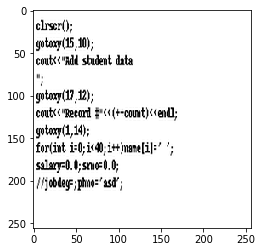

Original label:cpp, Prediction :python, confidence : 0.538


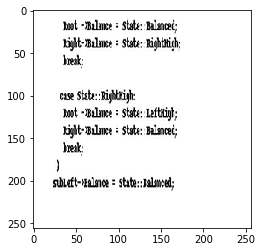

Original label:cpp, Prediction :c, confidence : 0.606


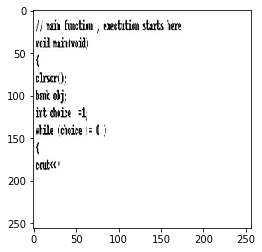

Original label:cpp, Prediction :c, confidence : 0.541


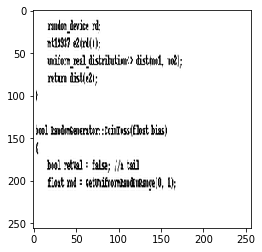

Original label:cpp, Prediction :c, confidence : 0.410


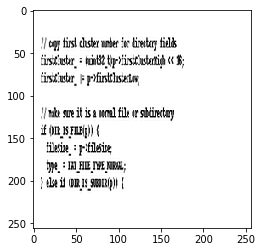

Original label:cpp, Prediction :c, confidence : 0.552


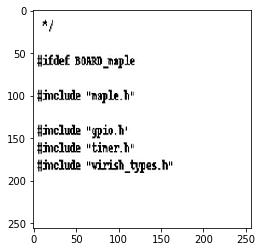

Original label:cpp, Prediction :java, confidence : 0.735


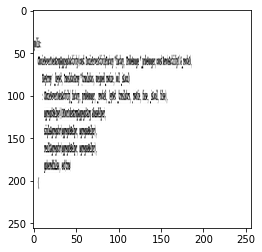

Original label:cpp, Prediction :c, confidence : 0.841


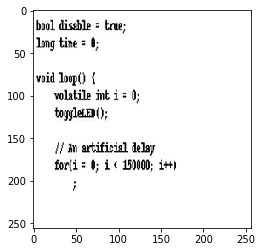

Original label:cpp, Prediction :c, confidence : 0.262


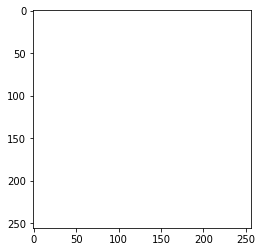

Original label:cpp, Prediction :python, confidence : 0.592


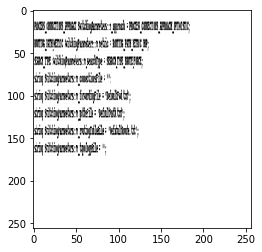

Original label:cpp, Prediction :java, confidence : 0.841


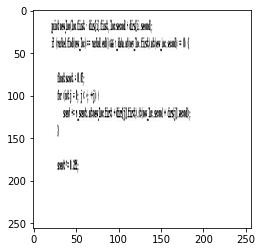

Original label:cpp, Prediction :python, confidence : 0.523


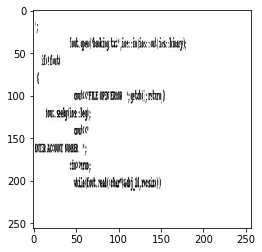

Original label:cpp, Prediction :c, confidence : 0.402


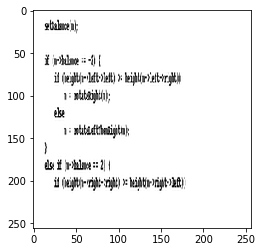

Original label:cpp, Prediction :java, confidence : 0.452


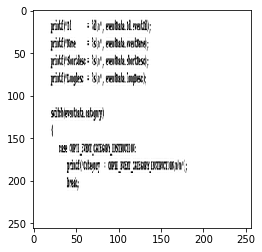

Original label:cpp, Prediction :c, confidence : 0.306


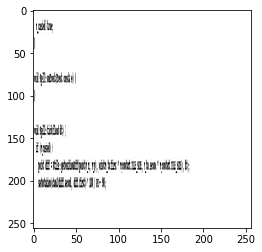

Original label:cpp, Prediction :java, confidence : 0.477


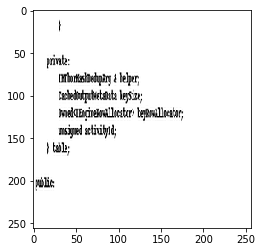

Original label:cpp, Prediction :java, confidence : 0.942


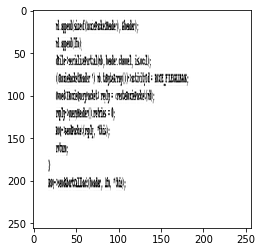

Original label:cpp, Prediction :c, confidence : 0.753


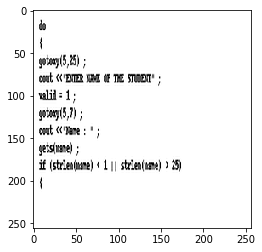

Original label:cpp, Prediction :java, confidence : 0.932


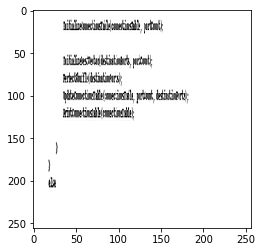

Original label:cpp, Prediction :c, confidence : 0.924


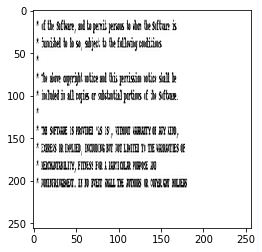

Original label:cpp, Prediction :python, confidence : 0.262


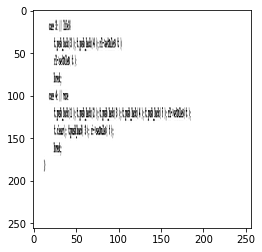

Original label:cpp, Prediction :c, confidence : 0.899


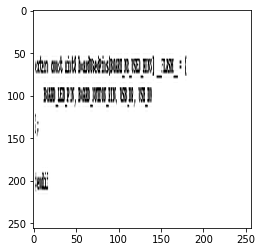

Original label:cpp, Prediction :java, confidence : 0.999


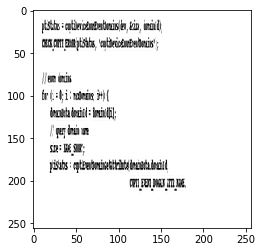

Original label:cpp, Prediction :c, confidence : 0.302


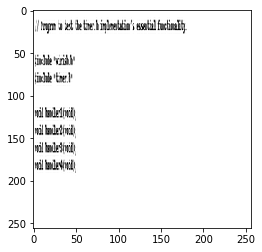

Original label:cpp, Prediction :c, confidence : 0.639


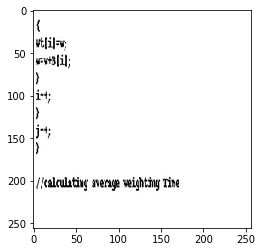

Original label:cpp, Prediction :c, confidence : 0.294


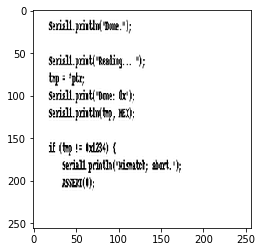

Original label:cpp, Prediction :python, confidence : 0.594


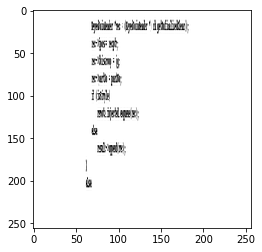

Original label:cpp, Prediction :c, confidence : 0.545


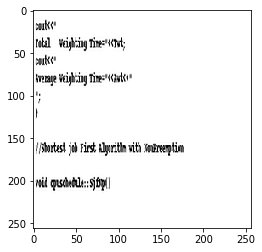

Original label:cpp, Prediction :c, confidence : 0.675


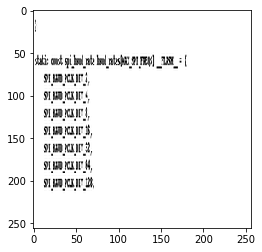

Original label:cpp, Prediction :java, confidence : 0.864


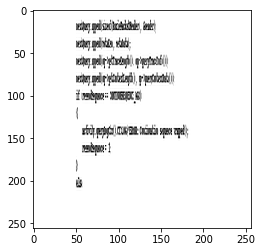

Original label:cpp, Prediction :c, confidence : 0.941


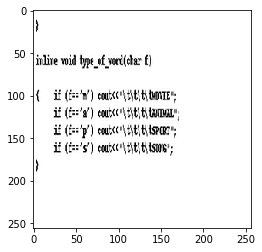

Original label:cpp, Prediction :c, confidence : 0.513


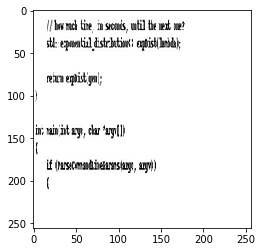

Original label:cpp, Prediction :c, confidence : 0.498


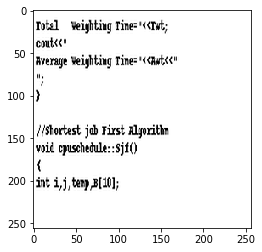

Original label:cpp, Prediction :java, confidence : 0.635


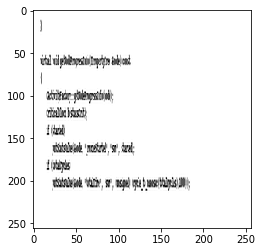

Original label:cpp, Prediction :python, confidence : 0.313


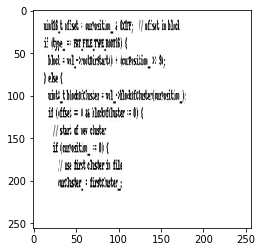

Original label:cpp, Prediction :c, confidence : 0.467


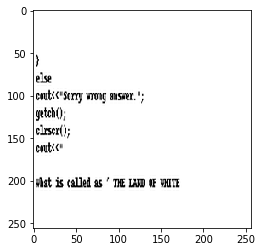

Original label:cpp, Prediction :java, confidence : 0.513


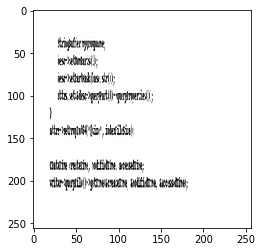

Original label:cpp, Prediction :c, confidence : 0.555


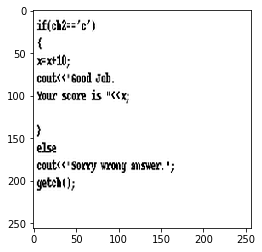

Original label:cpp, Prediction :c, confidence : 0.431


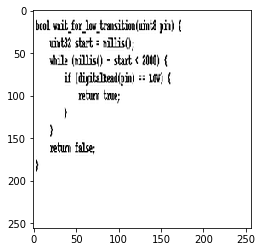

Original label:cpp, Prediction :c, confidence : 0.735


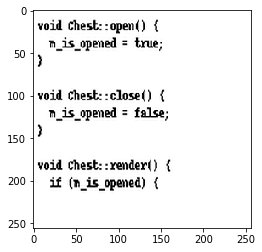

Original label:cpp, Prediction :c, confidence : 0.696


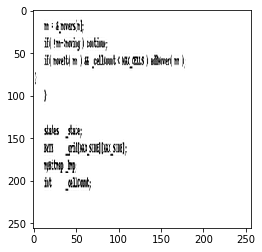

Original label:cpp, Prediction :java, confidence : 0.521


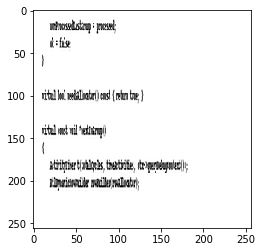

Original label:cpp, Prediction :python, confidence : 0.910


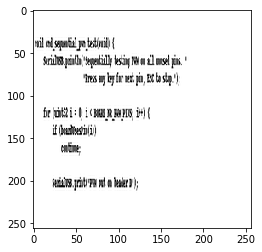

Original label:cpp, Prediction :python, confidence : 0.992


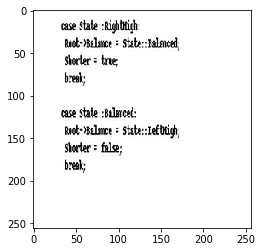

Original label:cpp, Prediction :c, confidence : 0.576


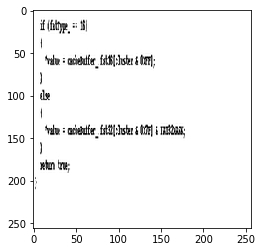

Original label:cpp, Prediction :c, confidence : 0.311


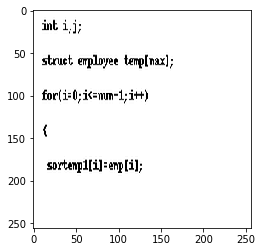

Original label:cpp, Prediction :c, confidence : 0.697


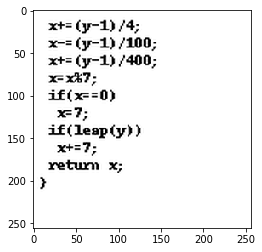

Original label:cpp, Prediction :c, confidence : 0.279


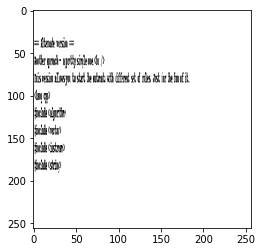

Original label:cpp, Prediction :c, confidence : 0.422


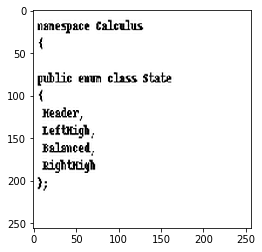

Original label:cpp, Prediction :c, confidence : 0.768


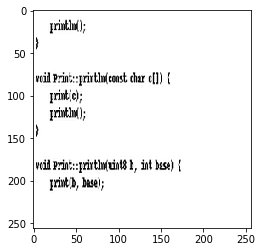

Original label:cpp, Prediction :java, confidence : 0.959


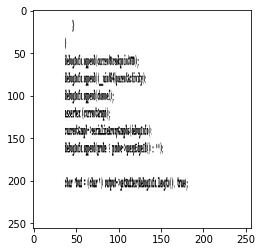

Original label:cpp, Prediction :c, confidence : 0.360


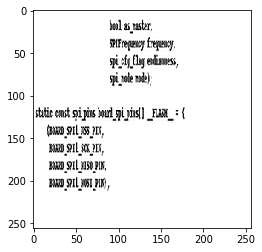

Original label:cpp, Prediction :java, confidence : 0.559


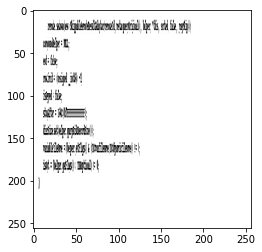

Original label:cpp, Prediction :java, confidence : 0.399


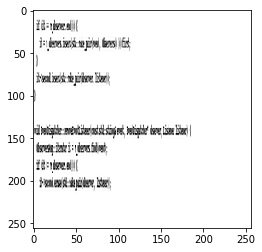

Original label:cpp, Prediction :c, confidence : 0.624


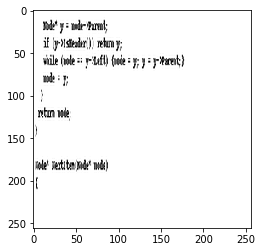

Original label:cpp, Prediction :c, confidence : 0.330


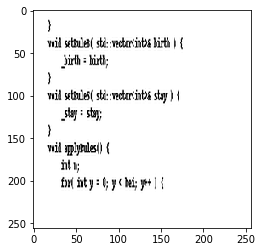

Original label:cpp, Prediction :c, confidence : 0.579


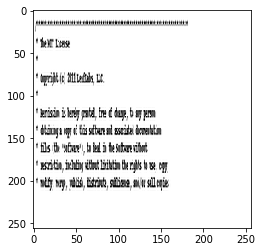

Original label:cpp, Prediction :c, confidence : 0.319


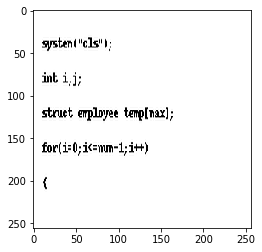

Original label:cpp, Prediction :c, confidence : 0.358


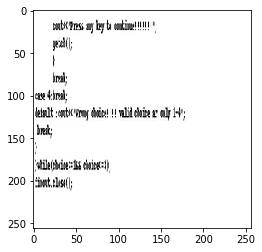

Original label:cpp, Prediction :c, confidence : 0.612


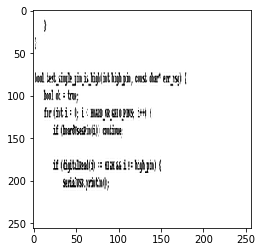

Original label:cpp, Prediction :c, confidence : 0.924


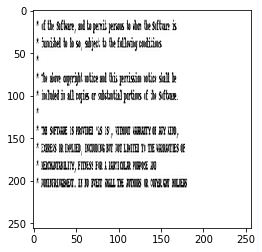

Original label:cpp, Prediction :c, confidence : 0.827


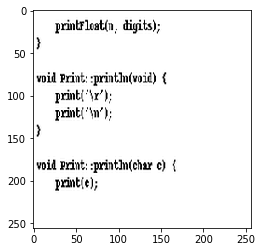

Original label:cpp, Prediction :c, confidence : 0.271


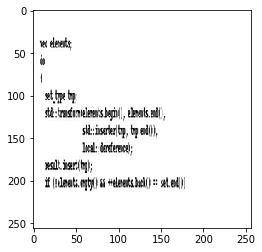

Original label:cpp, Prediction :c, confidence : 0.284


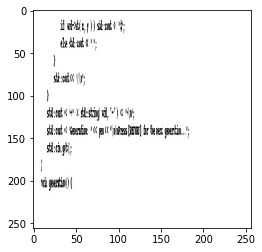

Original label:cpp, Prediction :c, confidence : 0.385


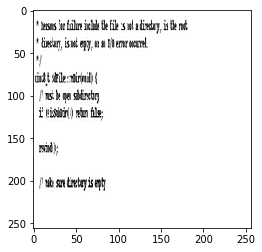

Original label:cpp, Prediction :java, confidence : 0.982


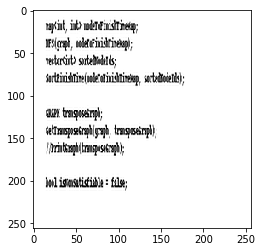

Original label:cpp, Prediction :c, confidence : 0.666


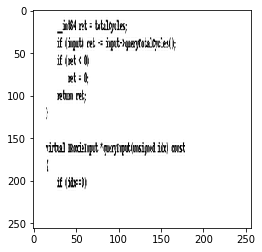

Original label:cpp, Prediction :java, confidence : 0.287


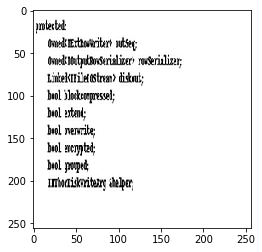

Original label:cpp, Prediction :c, confidence : 0.399


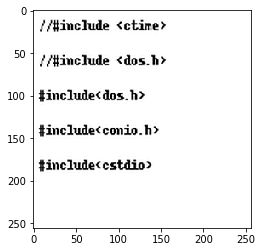

Original label:cpp, Prediction :c, confidence : 0.281


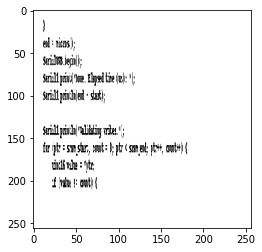

Original label:cpp, Prediction :c, confidence : 0.446


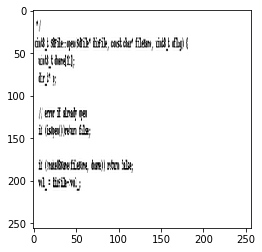

Original label:cpp, Prediction :java, confidence : 0.465


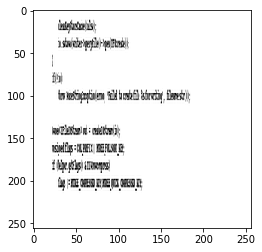

Original label:cpp, Prediction :c, confidence : 0.712


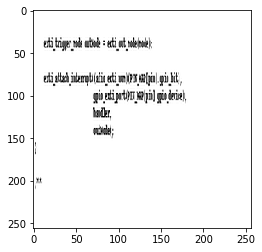

Original label:cpp, Prediction :c, confidence : 0.565


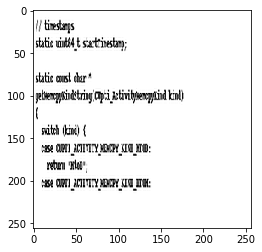

Original label:cpp, Prediction :c, confidence : 0.570


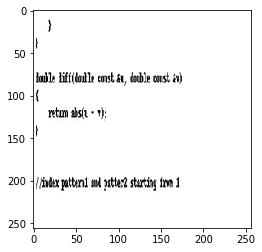

Original label:cpp, Prediction :c, confidence : 0.462


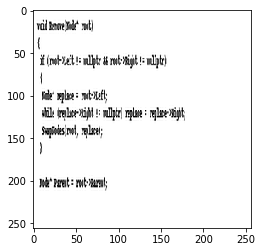

Original label:cpp, Prediction :c, confidence : 0.564


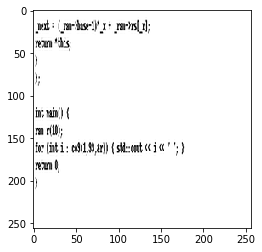

Original label:cpp, Prediction :c, confidence : 0.515


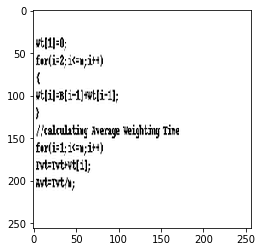

Original label:cpp, Prediction :c, confidence : 0.272


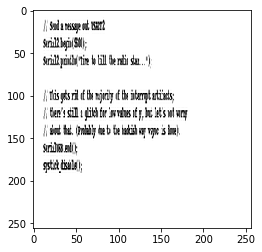

Original label:cpp, Prediction :c, confidence : 0.537


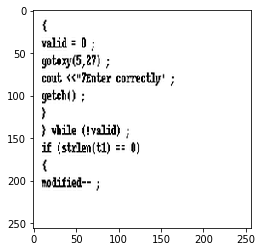

Original label:cpp, Prediction :c, confidence : 0.362


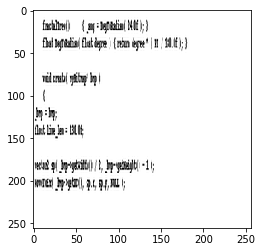

Original label:cpp, Prediction :java, confidence : 0.727


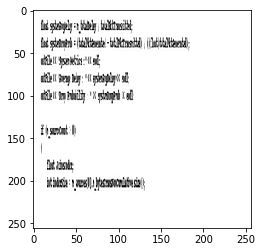

Original label:cpp, Prediction :c, confidence : 0.602


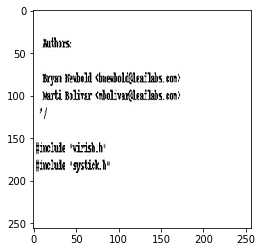

Original label:cpp, Prediction :python, confidence : 0.601


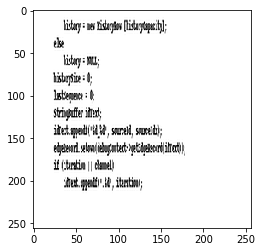

Original label:cpp, Prediction :java, confidence : 0.301


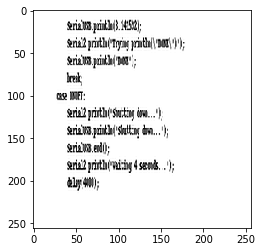

Original label:cpp, Prediction :c, confidence : 0.346


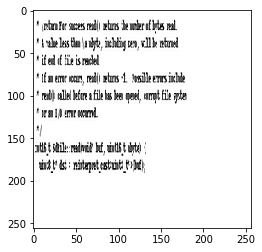

Original label:cpp, Prediction :c, confidence : 0.686


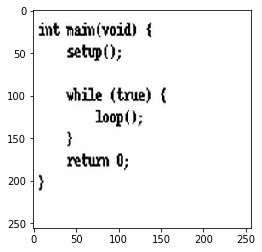

Original label:cpp, Prediction :c, confidence : 0.960


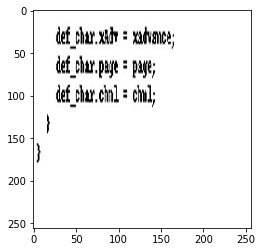

Original label:cpp, Prediction :c, confidence : 0.780


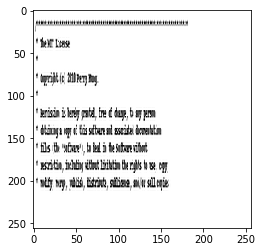

Original label:cpp, Prediction :java, confidence : 0.531


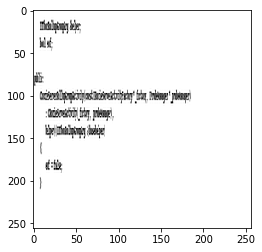

Original label:cpp, Prediction :java, confidence : 0.702


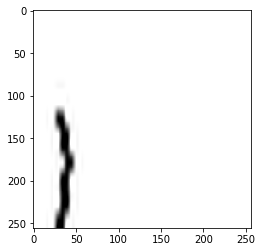

Original label:cpp, Prediction :c, confidence : 0.541


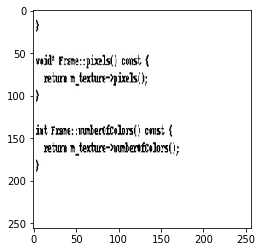

Original label:cpp, Prediction :java, confidence : 0.490


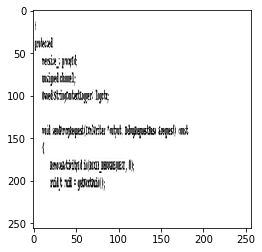

Original label:cpp, Prediction :c, confidence : 0.491


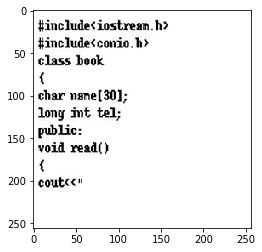

Original label:cpp, Prediction :python, confidence : 0.281


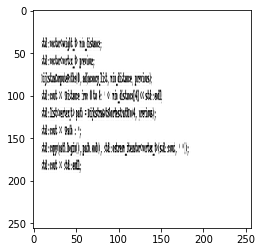

Original label:cpp, Prediction :c, confidence : 0.730


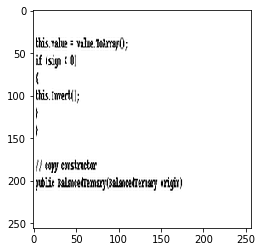

Original label:cpp, Prediction :c, confidence : 0.590


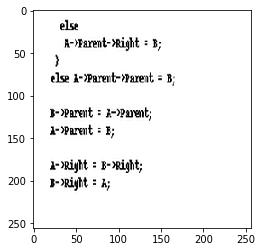

Original label:cpp, Prediction :c, confidence : 0.406


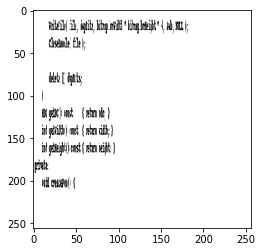

Original label:cpp, Prediction :java, confidence : 0.965


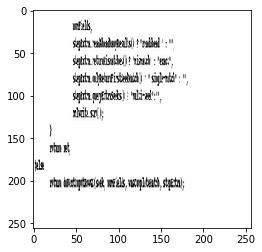

Original label:cpp, Prediction :c, confidence : 0.579


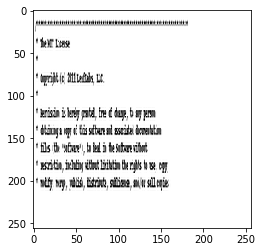

Original label:cpp, Prediction :java, confidence : 0.512


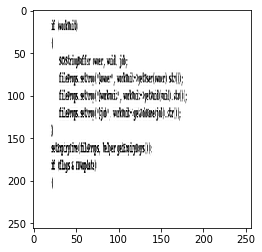

Original label:cpp, Prediction :c, confidence : 0.451


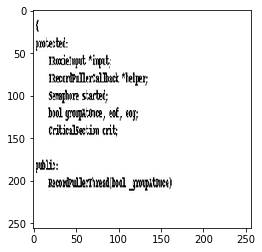

Original label:cpp, Prediction :java, confidence : 0.692


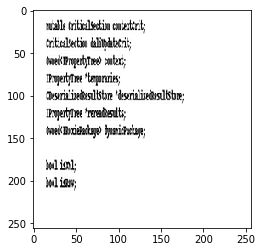

Original label:cpp, Prediction :c, confidence : 0.490


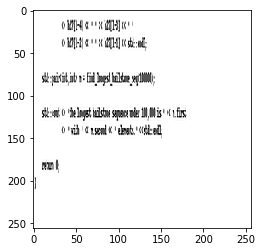

Original label:cpp, Prediction :java, confidence : 1.000


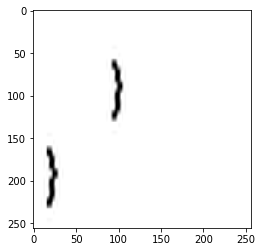

Original label:cpp, Prediction :java, confidence : 0.479


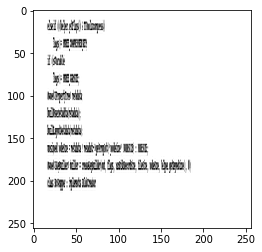

Original label:cpp, Prediction :c, confidence : 0.358


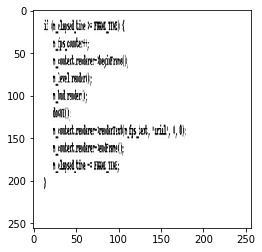

Original label:cpp, Prediction :c, confidence : 0.634


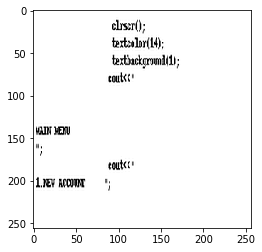

Original label:cpp, Prediction :c, confidence : 0.484


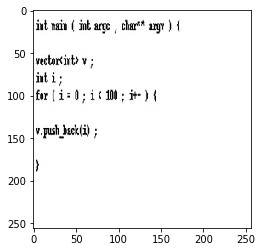

Original label:cpp, Prediction :java, confidence : 0.269


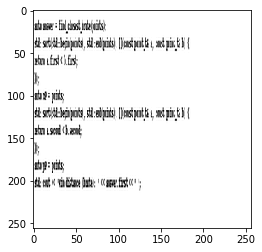

Original label:cpp, Prediction :c, confidence : 0.924


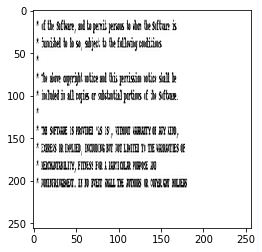

Original label:cpp, Prediction :c, confidence : 0.271


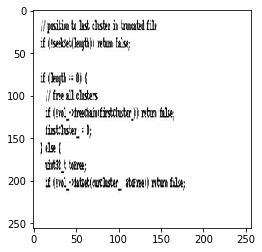

Original label:cpp, Prediction :c, confidence : 0.343


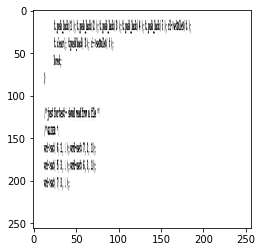

Original label:cpp, Prediction :c, confidence : 0.398


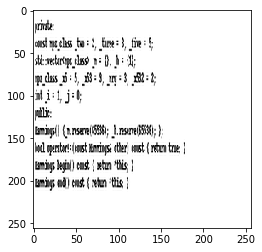

Original label:cpp, Prediction :c, confidence : 0.537


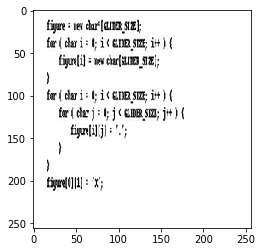

Original label:cpp, Prediction :c, confidence : 0.956


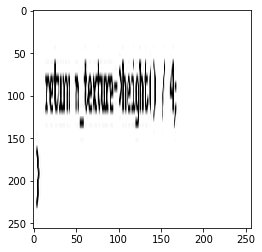

Original label:cpp, Prediction :c, confidence : 0.924


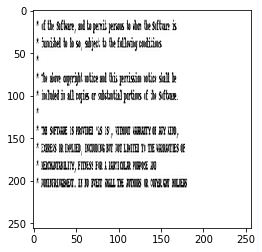

Original label:cpp, Prediction :c, confidence : 0.421


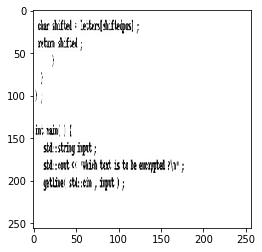

Original label:cpp, Prediction :python, confidence : 0.809


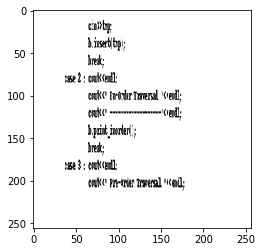

Original label:cpp, Prediction :c, confidence : 0.686


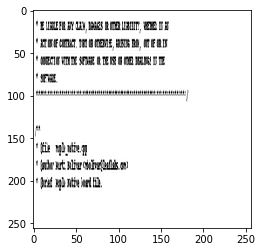

Original label:cpp, Prediction :c, confidence : 0.376


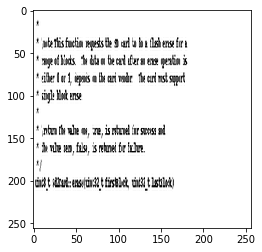

Original label:cpp, Prediction :c, confidence : 0.327


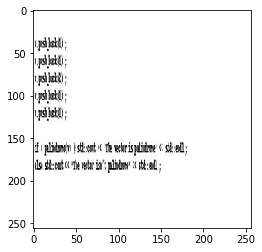

Original label:cpp, Prediction :java, confidence : 0.993


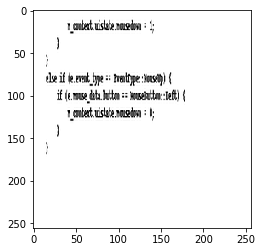

Original label:cpp, Prediction :c, confidence : 0.406


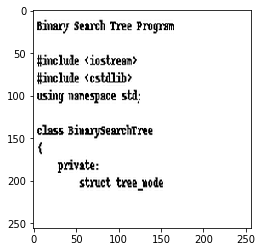

Original label:cpp, Prediction :python, confidence : 0.413


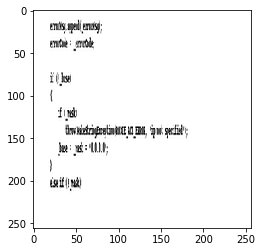

Original label:cpp, Prediction :c, confidence : 0.496


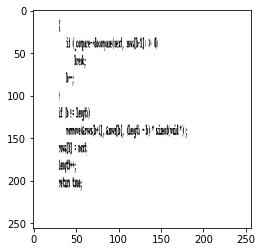

Original label:cpp, Prediction :c, confidence : 0.484


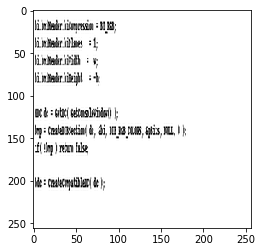

Original label:cpp, Prediction :c, confidence : 0.363


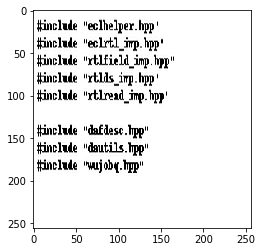

Original label:cpp, Prediction :java, confidence : 0.893


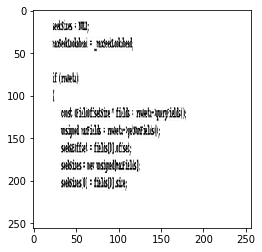

Original label:cpp, Prediction :c, confidence : 0.488


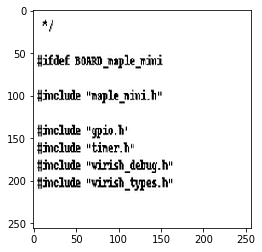

Original label:cpp, Prediction :java, confidence : 0.846


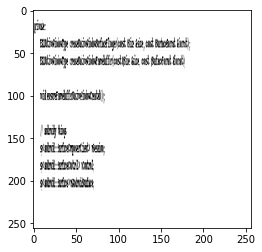

Original label:cpp, Prediction :c, confidence : 0.650


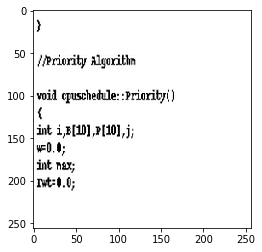

Original label:cpp, Prediction :c, confidence : 0.305


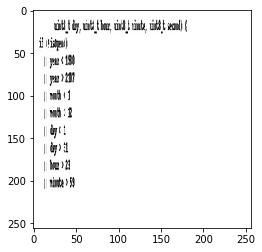

Original label:cpp, Prediction :java, confidence : 0.856


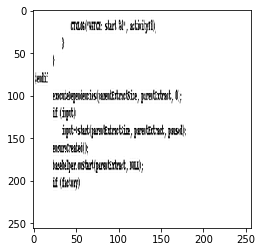

Original label:cpp, Prediction :c, confidence : 0.854


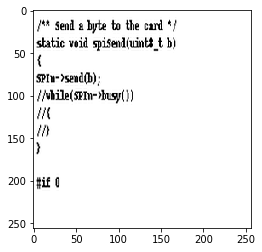

Original label:cpp, Prediction :c, confidence : 0.496


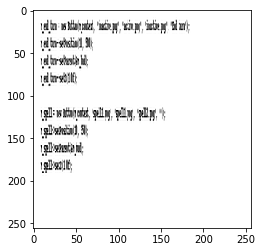

Original label:cpp, Prediction :java, confidence : 0.605


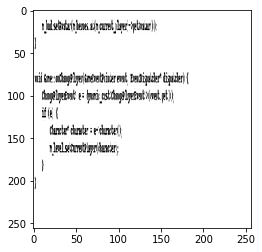

Original label:cpp, Prediction :c, confidence : 0.614


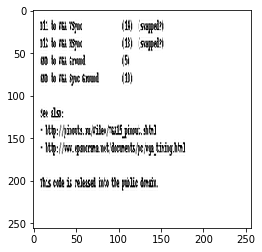

Original label:cpp, Prediction :java, confidence : 0.558


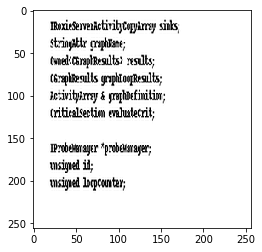

Original label:cpp, Prediction :java, confidence : 0.688


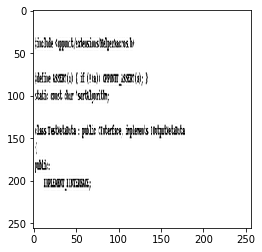

Original label:cpp, Prediction :c, confidence : 0.797


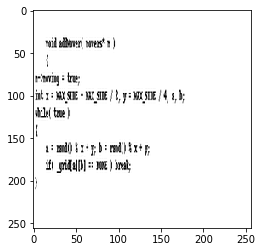

Original label:cpp, Prediction :c, confidence : 0.384


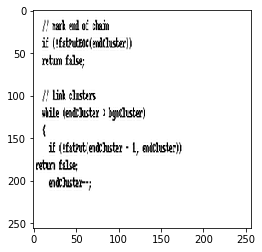

Original label:cpp, Prediction :c, confidence : 0.512


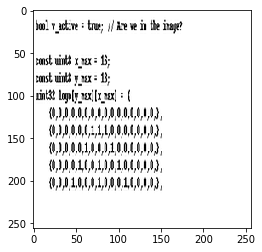

Original label:cpp, Prediction :c, confidence : 0.363


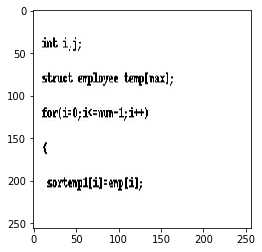

Original label:cpp, Prediction :java, confidence : 0.404


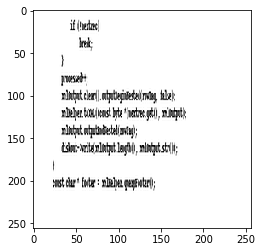

Original label:cpp, Prediction :c, confidence : 0.667


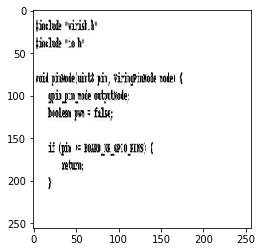

Original label:cpp, Prediction :java, confidence : 0.726


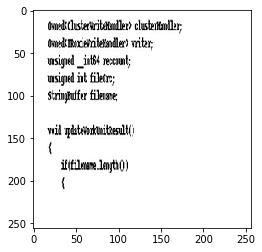

Original label:cpp, Prediction :c, confidence : 0.459


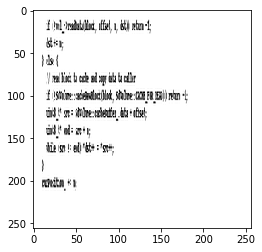

Original label:cpp, Prediction :c, confidence : 0.480


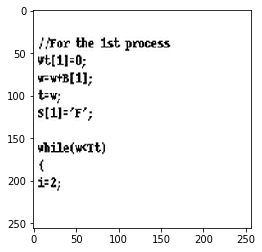

Original label:cpp, Prediction :python, confidence : 0.882


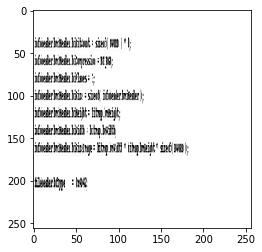

Original label:cpp, Prediction :c, confidence : 0.347


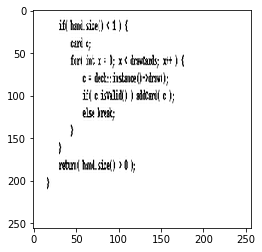

Original label:cpp, Prediction :c, confidence : 0.639


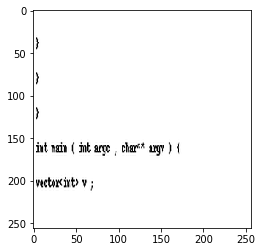

Original label:cpp, Prediction :c, confidence : 0.958


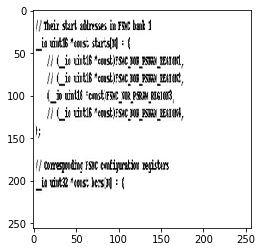

Original label:cpp, Prediction :c, confidence : 0.359


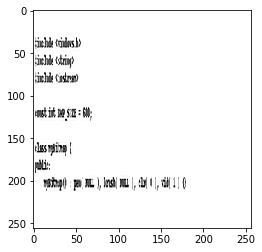

Original label:cpp, Prediction :c, confidence : 0.494


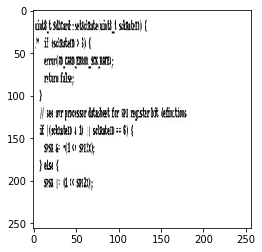

Original label:cpp, Prediction :python, confidence : 0.648


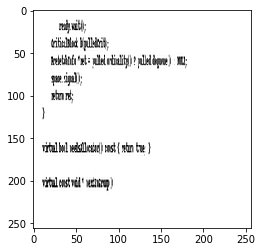

Original label:cpp, Prediction :c, confidence : 0.507


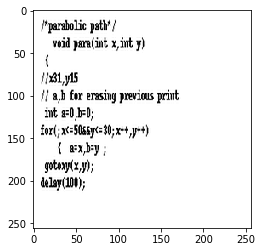

Original label:cpp, Prediction :java, confidence : 0.998


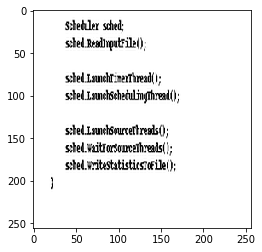

Original label:cpp, Prediction :c, confidence : 0.739


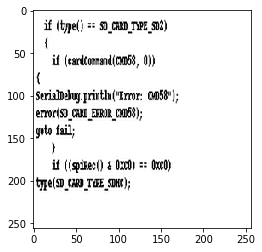

Original label:cpp, Prediction :python, confidence : 0.924


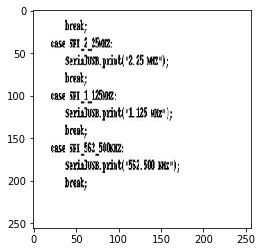

Original label:cpp, Prediction :java, confidence : 0.908


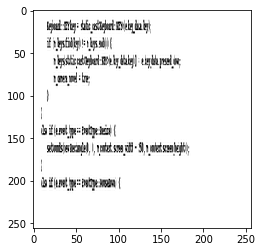

Original label:cpp, Prediction :c, confidence : 0.293


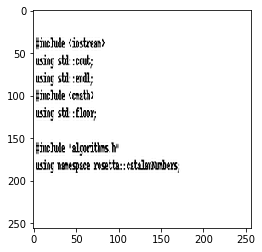

Original label:cpp, Prediction :c, confidence : 0.514


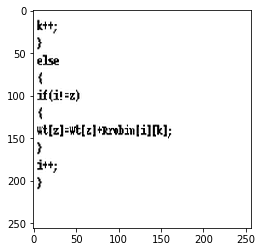

Original label:cpp, Prediction :c, confidence : 0.499


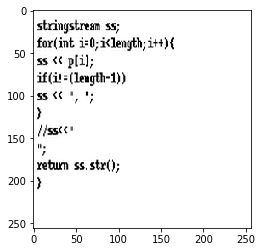

Original label:cpp, Prediction :java, confidence : 0.348


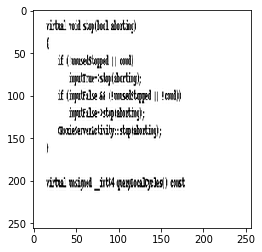

Original label:cpp, Prediction :python, confidence : 0.360


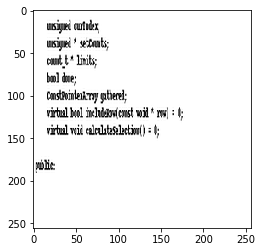

Original label:cpp, Prediction :c, confidence : 0.875


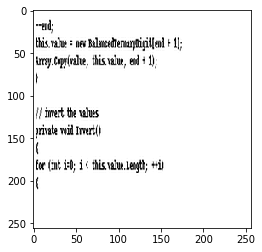

Original label:cpp, Prediction :c, confidence : 0.373


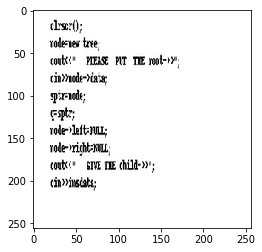

Original label:cpp, Prediction :c, confidence : 0.920


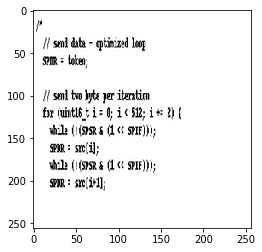

Original label:cpp, Prediction :python, confidence : 0.998


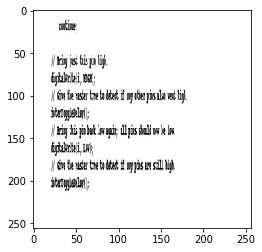

Original label:cpp, Prediction :python, confidence : 0.269


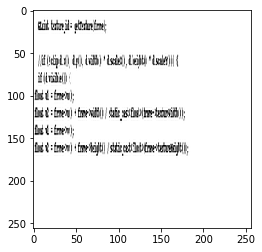

Original label:cpp, Prediction :java, confidence : 0.310


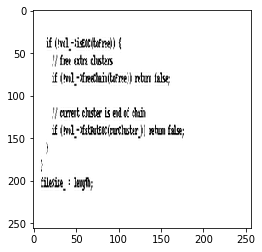

Original label:cpp, Prediction :c, confidence : 0.502


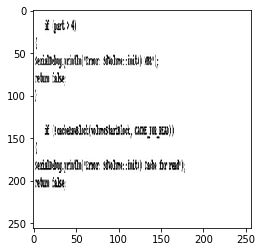

Original label:cpp, Prediction :c, confidence : 0.952


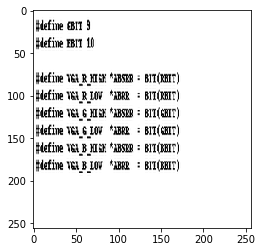

Original label:cpp, Prediction :c, confidence : 0.308


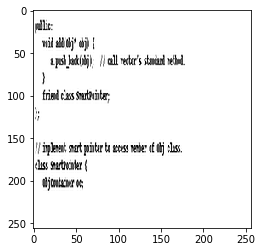

Original label:cpp, Prediction :java, confidence : 0.956


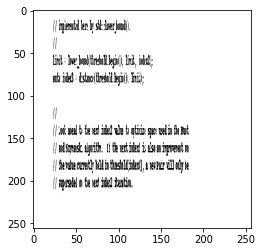

Original label:cpp, Prediction :c, confidence : 0.534


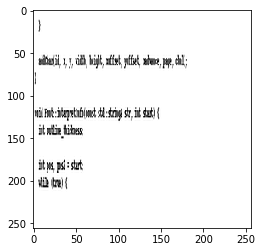

Original label:cpp, Prediction :python, confidence : 0.376


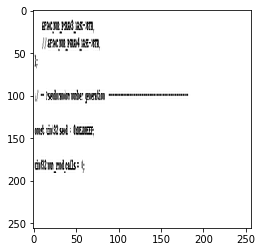

Original label:cpp, Prediction :c, confidence : 0.490


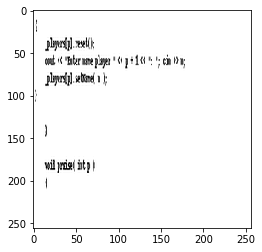

Original label:cpp, Prediction :java, confidence : 0.474


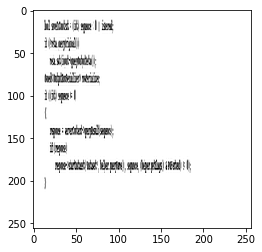

Original label:cpp, Prediction :c, confidence : 0.681


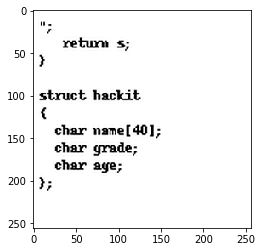

Original label:cpp, Prediction :java, confidence : 0.290


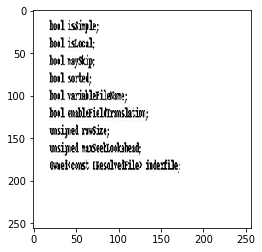

Original label:cpp, Prediction :c, confidence : 0.607


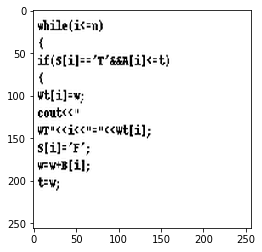

Original label:cpp, Prediction :c, confidence : 0.357


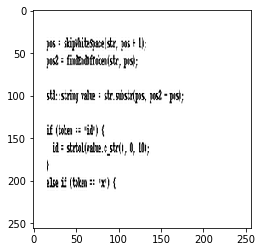

Original label:cpp, Prediction :c, confidence : 0.613


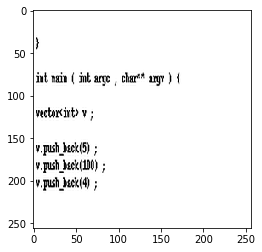

Original label:cpp, Prediction :c, confidence : 0.601


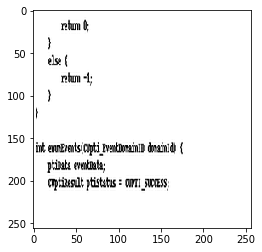

Original label:cpp, Prediction :python, confidence : 0.323


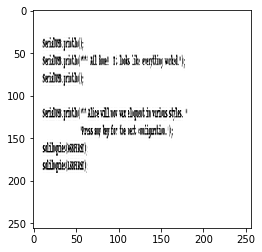

Original label:cpp, Prediction :c, confidence : 0.284


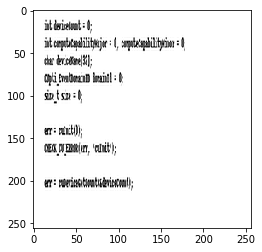

Original label:cpp, Prediction :c, confidence : 0.719


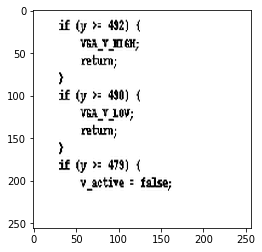

Original label:cpp, Prediction :java, confidence : 0.502


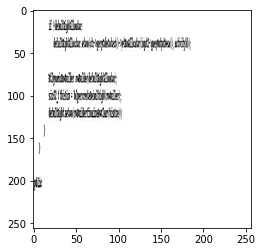

Original label:java, Prediction :python, confidence : 0.271


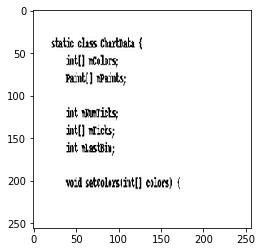

Original label:java, Prediction :cpp, confidence : 0.490


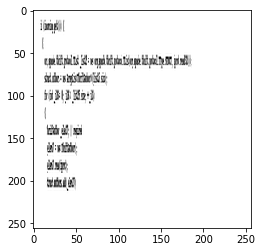

Original label:java, Prediction :c, confidence : 0.275


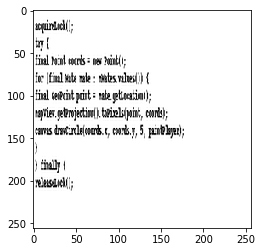

Original label:java, Prediction :c, confidence : 0.496


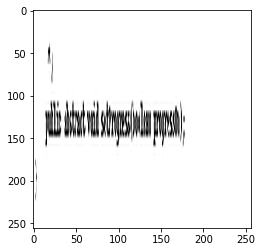

Original label:java, Prediction :cpp, confidence : 0.781


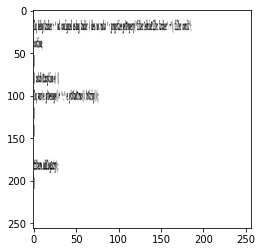

Original label:java, Prediction :cpp, confidence : 0.958


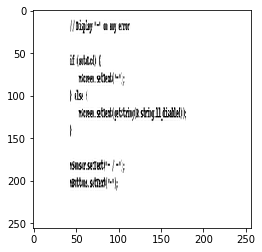

Original label:java, Prediction :python, confidence : 0.537


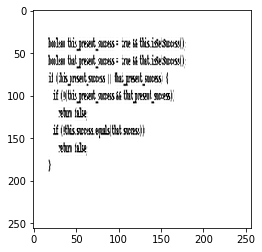

Original label:java, Prediction :python, confidence : 0.748


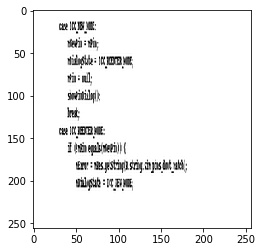

Original label:java, Prediction :c, confidence : 0.406


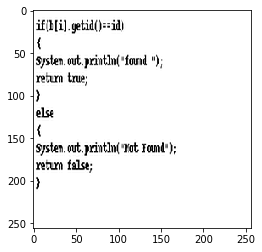

Original label:java, Prediction :cpp, confidence : 0.541


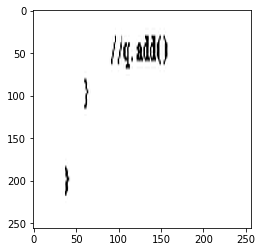

Original label:java, Prediction :c, confidence : 0.388


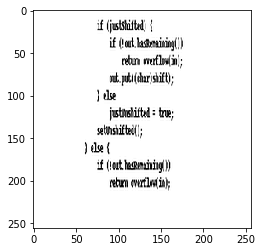

Original label:java, Prediction :cpp, confidence : 0.720


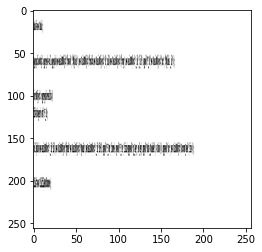

Original label:java, Prediction :python, confidence : 0.879


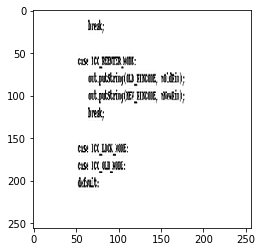

Original label:java, Prediction :c, confidence : 0.284


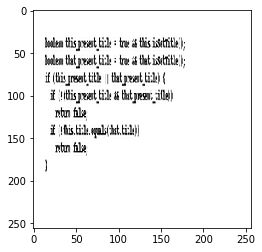

Original label:java, Prediction :c, confidence : 0.289


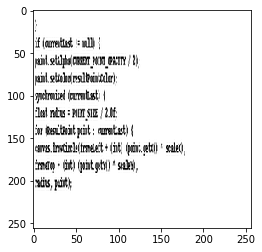

Original label:java, Prediction :python, confidence : 0.462


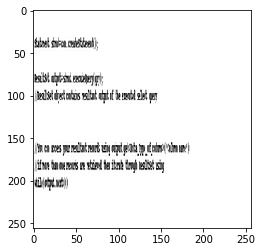

Original label:java, Prediction :c, confidence : 0.619


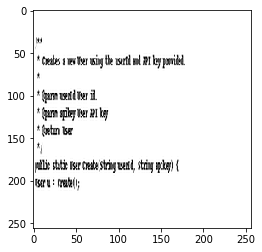

Original label:java, Prediction :c, confidence : 0.483


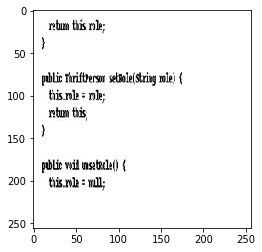

Original label:java, Prediction :c, confidence : 0.454


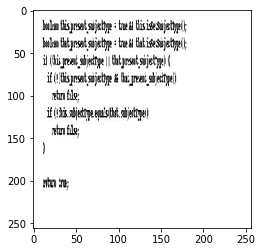

Original label:java, Prediction :cpp, confidence : 0.840


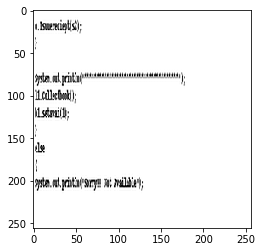

Original label:java, Prediction :cpp, confidence : 0.435


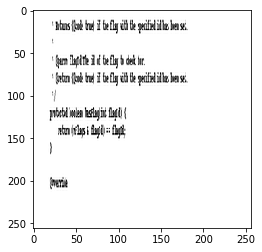

Original label:java, Prediction :python, confidence : 0.264


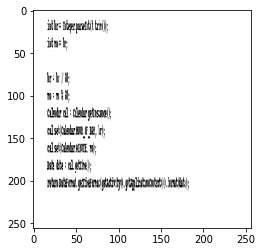

Original label:java, Prediction :cpp, confidence : 0.749


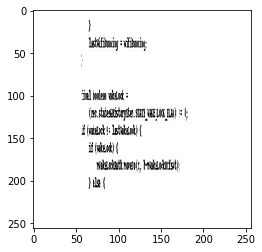

Original label:java, Prediction :cpp, confidence : 0.411


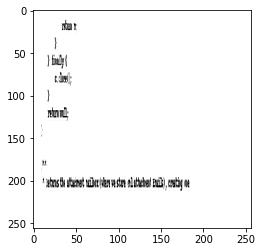

Original label:java, Prediction :python, confidence : 0.430


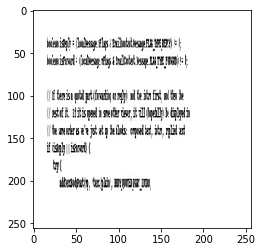

Original label:java, Prediction :c, confidence : 0.629


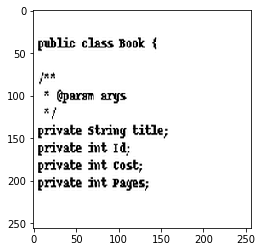

Original label:java, Prediction :c, confidence : 0.325


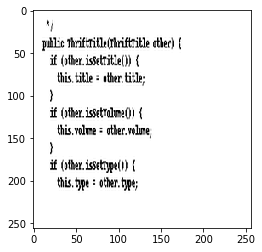

Original label:java, Prediction :python, confidence : 0.568


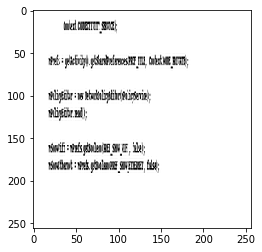

Original label:java, Prediction :python, confidence : 0.334


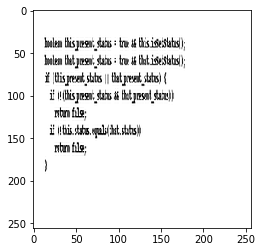

Original label:java, Prediction :c, confidence : 0.292


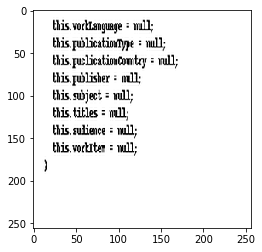

Original label:java, Prediction :c, confidence : 0.369


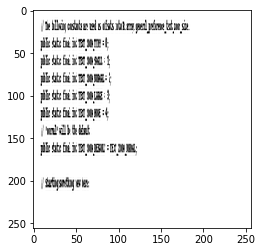

Original label:java, Prediction :python, confidence : 0.262


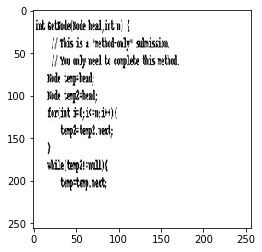

Original label:java, Prediction :cpp, confidence : 0.583


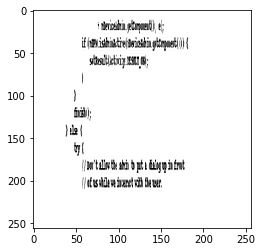

Original label:java, Prediction :python, confidence : 0.299


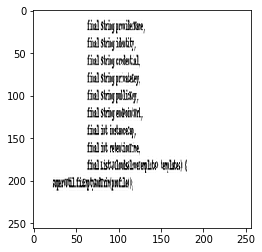

Original label:java, Prediction :cpp, confidence : 0.507


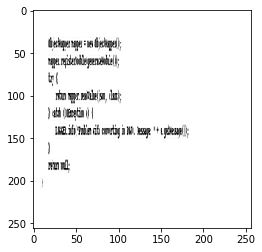

Original label:java, Prediction :c, confidence : 0.503


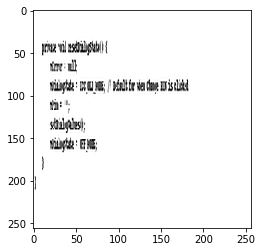

Original label:java, Prediction :cpp, confidence : 0.280


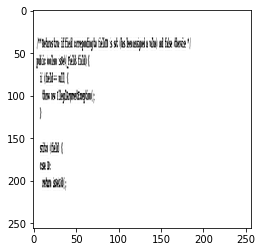

Original label:java, Prediction :python, confidence : 0.291


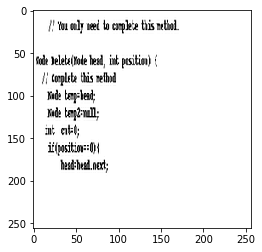

Original label:java, Prediction :cpp, confidence : 0.827


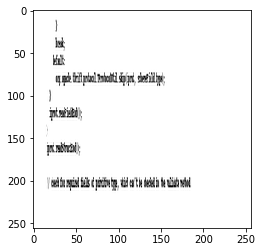

Original label:java, Prediction :cpp, confidence : 0.440


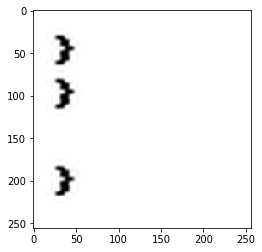

Original label:java, Prediction :c, confidence : 0.319


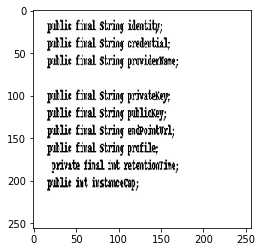

Original label:java, Prediction :python, confidence : 0.746


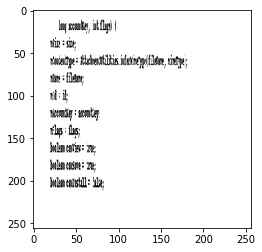

Original label:java, Prediction :python, confidence : 0.674


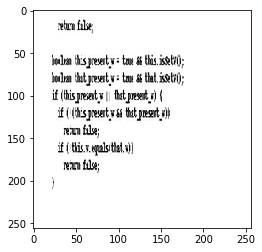

Original label:java, Prediction :c, confidence : 0.673


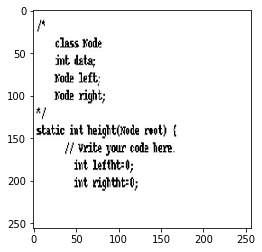

Original label:java, Prediction :cpp, confidence : 0.414


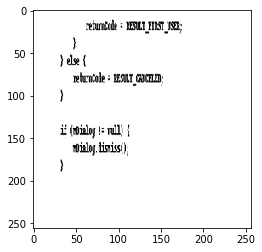

Original label:java, Prediction :cpp, confidence : 0.476


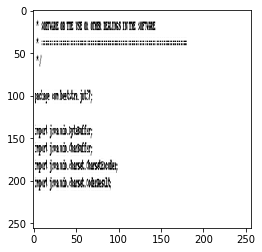

Original label:java, Prediction :c, confidence : 0.406


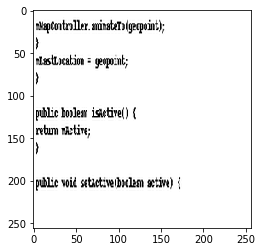

Original label:java, Prediction :cpp, confidence : 0.994


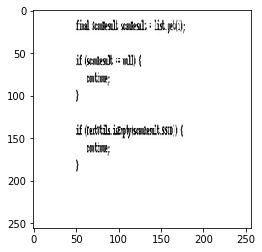

Original label:java, Prediction :python, confidence : 0.603


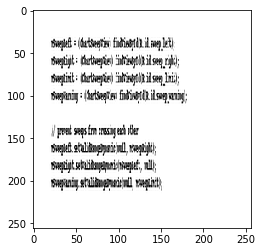

Original label:java, Prediction :cpp, confidence : 0.582


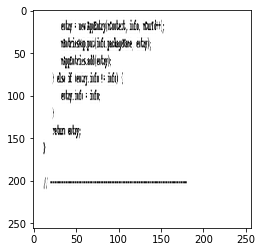

Original label:java, Prediction :c, confidence : 0.296


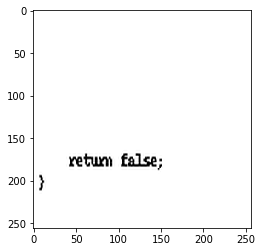

Original label:java, Prediction :cpp, confidence : 0.955


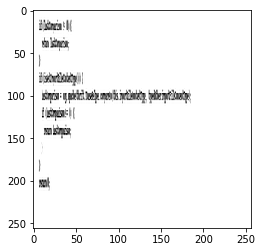

Original label:java, Prediction :python, confidence : 0.434


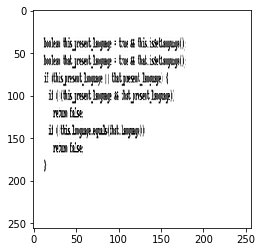

Original label:java, Prediction :c, confidence : 0.282


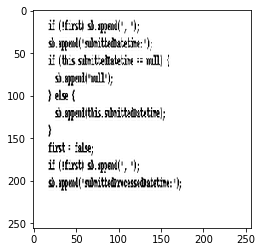

Original label:java, Prediction :c, confidence : 0.621


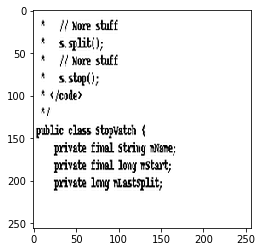

Original label:java, Prediction :c, confidence : 0.731


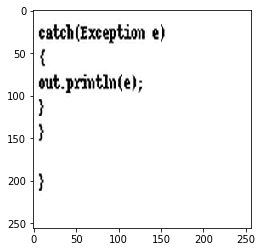

Original label:java, Prediction :cpp, confidence : 0.626


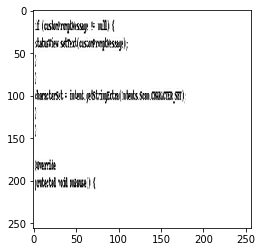

Original label:java, Prediction :c, confidence : 0.269


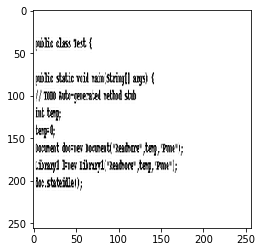

Original label:java, Prediction :cpp, confidence : 0.275


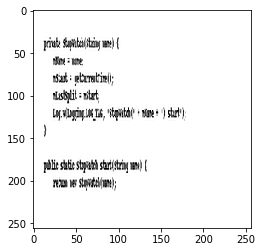

Original label:java, Prediction :cpp, confidence : 0.984


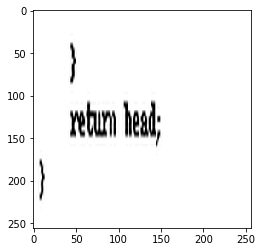

Original label:java, Prediction :cpp, confidence : 0.400


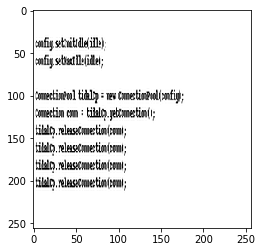

Original label:java, Prediction :cpp, confidence : 0.440


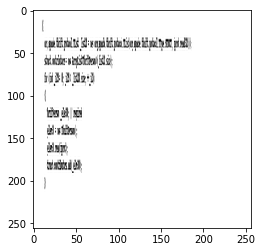

Original label:java, Prediction :python, confidence : 0.597


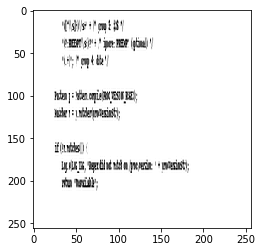

Original label:java, Prediction :c, confidence : 0.502


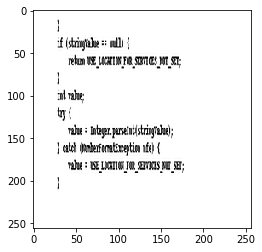

Original label:java, Prediction :c, confidence : 0.664


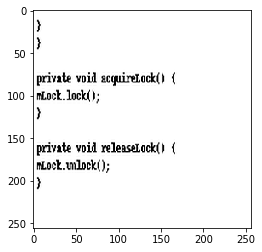

Original label:java, Prediction :cpp, confidence : 0.977


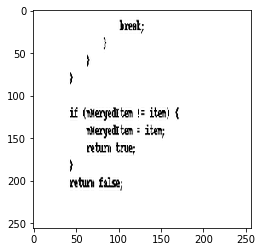

Original label:java, Prediction :cpp, confidence : 0.562


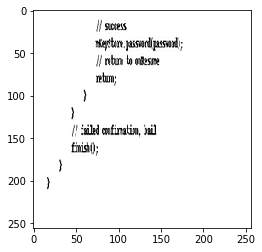

Original label:java, Prediction :c, confidence : 0.373


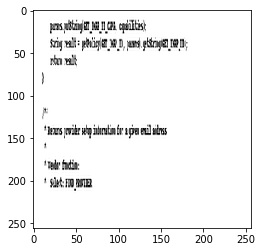

Original label:java, Prediction :c, confidence : 0.289


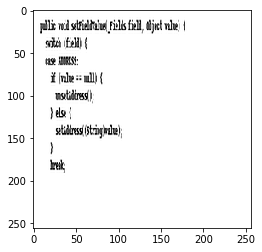

Original label:java, Prediction :c, confidence : 0.275


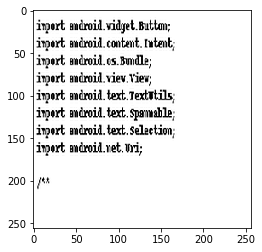

Original label:java, Prediction :cpp, confidence : 0.586


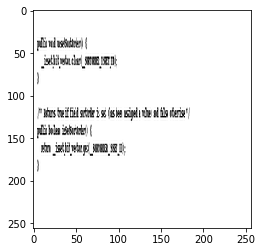

Original label:java, Prediction :c, confidence : 0.441


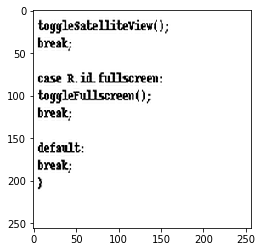

Original label:java, Prediction :c, confidence : 0.464


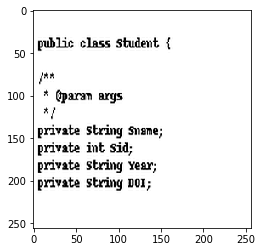

Original label:java, Prediction :cpp, confidence : 0.528


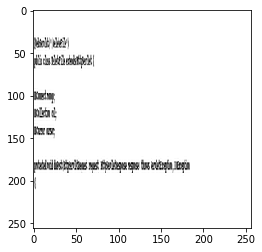

Original label:java, Prediction :python, confidence : 0.891


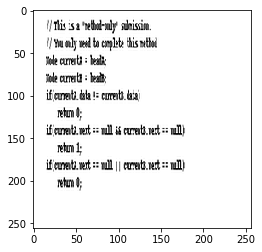

Original label:java, Prediction :c, confidence : 0.739


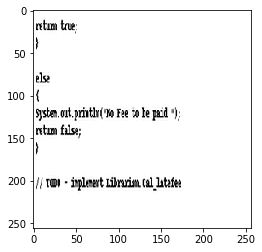

Original label:java, Prediction :cpp, confidence : 0.995


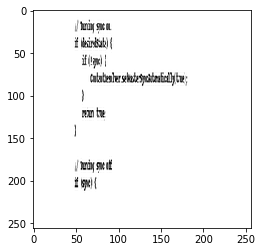

Original label:java, Prediction :python, confidence : 0.516


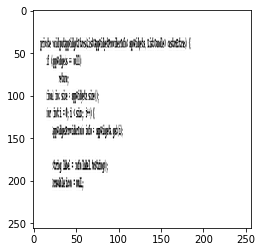

Original label:java, Prediction :cpp, confidence : 0.967


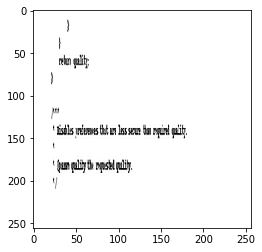

Original label:java, Prediction :python, confidence : 0.270


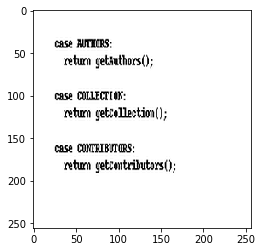

Original label:java, Prediction :c, confidence : 0.419


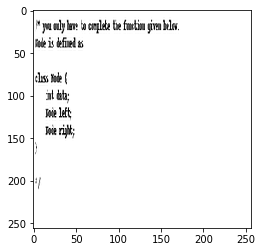

Original label:java, Prediction :c, confidence : 0.301


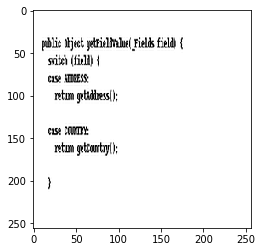

Original label:java, Prediction :c, confidence : 0.337


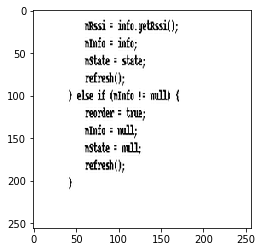

Original label:java, Prediction :c, confidence : 0.499


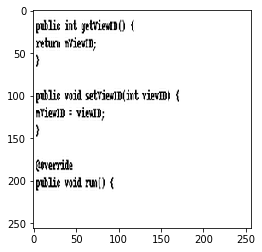

Original label:java, Prediction :c, confidence : 0.506


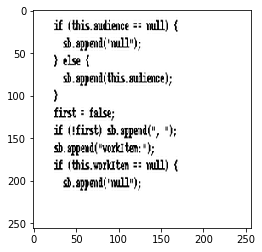

Original label:java, Prediction :python, confidence : 0.399


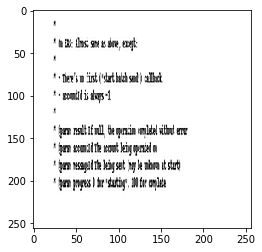

Original label:java, Prediction :cpp, confidence : 0.730


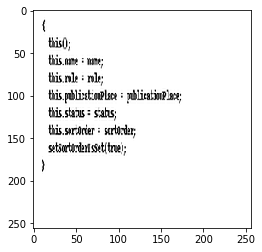

Original label:java, Prediction :python, confidence : 0.885


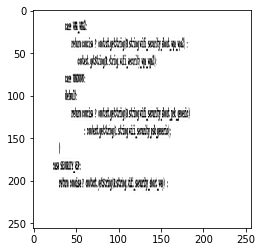

Original label:java, Prediction :cpp, confidence : 0.420


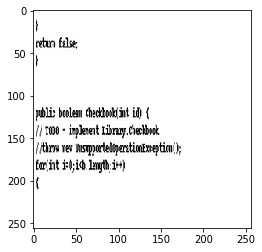

Original label:java, Prediction :c, confidence : 0.400


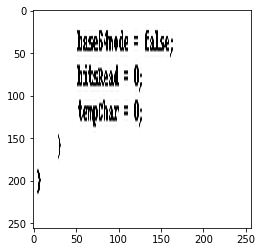

Original label:java, Prediction :python, confidence : 0.405


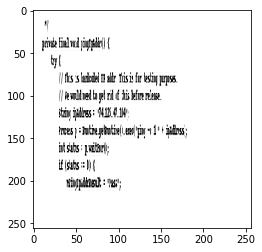

Original label:java, Prediction :c, confidence : 0.429


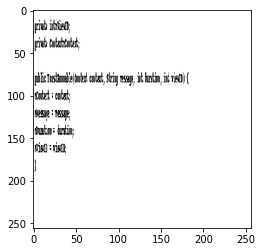

Original label:java, Prediction :cpp, confidence : 0.467


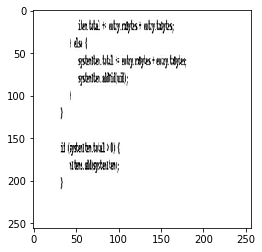

Original label:java, Prediction :c, confidence : 0.437


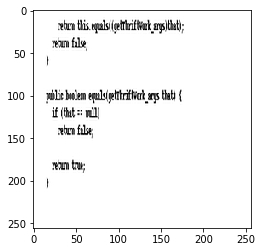

Original label:java, Prediction :cpp, confidence : 0.509


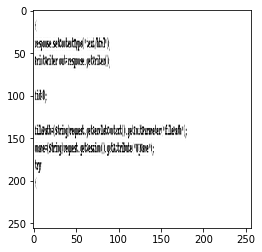

Original label:java, Prediction :c, confidence : 0.532


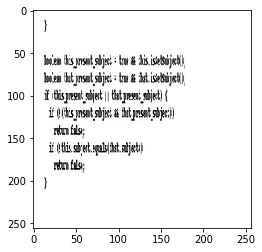

Original label:java, Prediction :cpp, confidence : 0.276


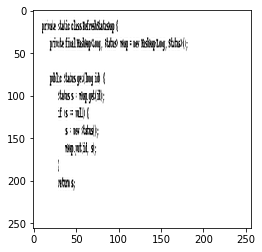

Original label:java, Prediction :python, confidence : 0.934


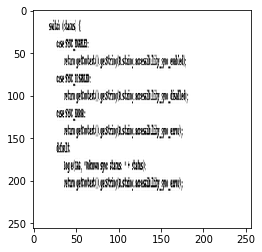

Original label:java, Prediction :python, confidence : 0.264


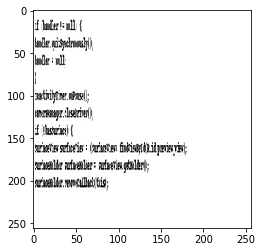

Original label:java, Prediction :python, confidence : 0.493


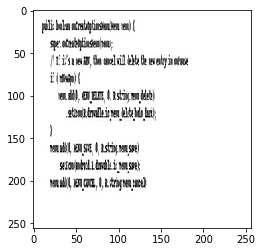

Original label:java, Prediction :c, confidence : 0.321


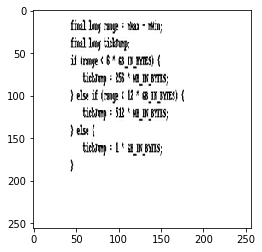

Original label:java, Prediction :cpp, confidence : 0.846


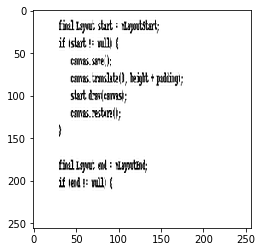

Original label:java, Prediction :python, confidence : 0.992


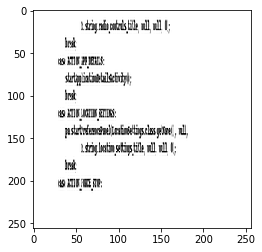

Original label:java, Prediction :c, confidence : 0.402


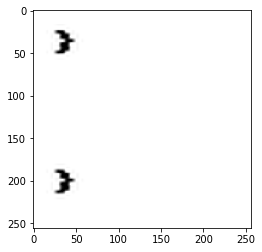

Original label:java, Prediction :cpp, confidence : 0.416


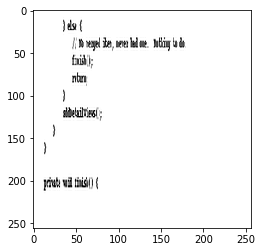

Original label:java, Prediction :python, confidence : 0.268


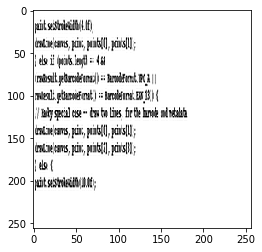

Original label:java, Prediction :cpp, confidence : 0.372


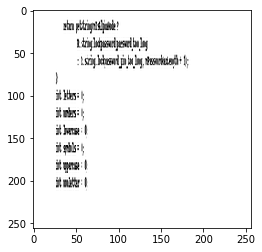

Original label:java, Prediction :c, confidence : 0.664


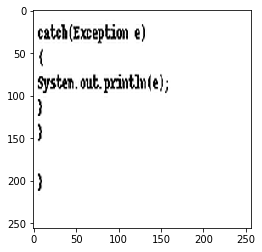

Original label:java, Prediction :c, confidence : 0.267


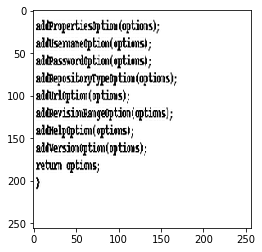

Original label:java, Prediction :python, confidence : 0.654


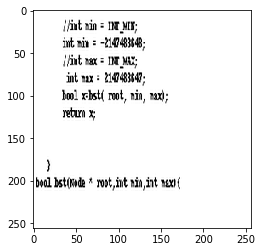

Original label:java, Prediction :cpp, confidence : 0.682


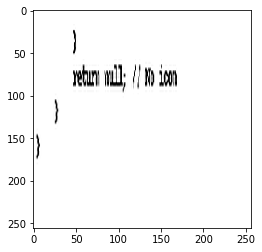

Original label:java, Prediction :python, confidence : 0.753


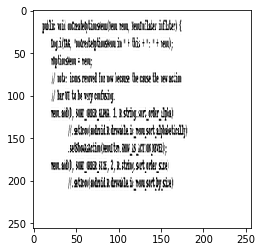

Original label:java, Prediction :cpp, confidence : 0.570


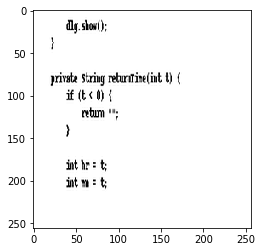

Original label:java, Prediction :c, confidence : 0.316


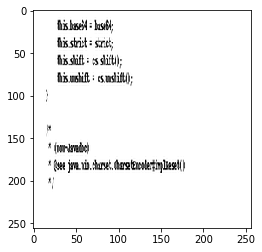

Original label:java, Prediction :c, confidence : 0.355


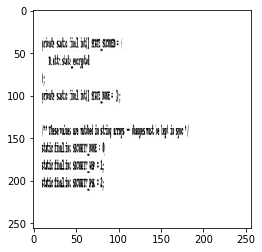

Original label:java, Prediction :cpp, confidence : 0.265


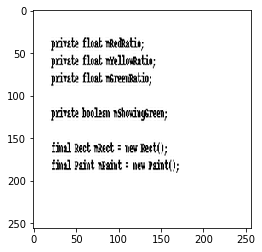

Original label:java, Prediction :cpp, confidence : 0.326


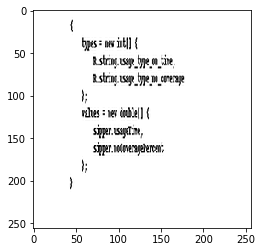

Original label:java, Prediction :c, confidence : 0.521


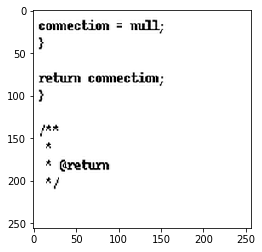

Original label:java, Prediction :cpp, confidence : 0.452


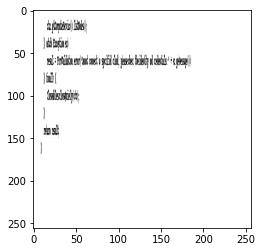

Original label:java, Prediction :python, confidence : 0.589


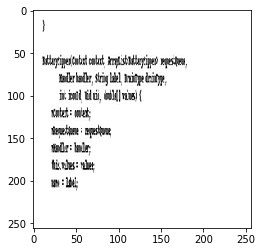

Original label:java, Prediction :c, confidence : 0.613


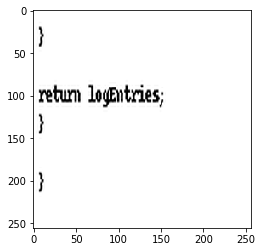

Original label:java, Prediction :c, confidence : 0.296


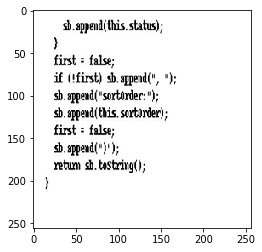

Original label:java, Prediction :python, confidence : 0.466


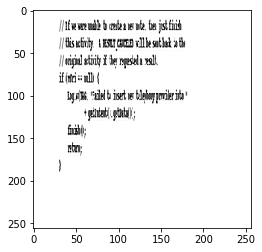

Original label:java, Prediction :cpp, confidence : 0.353


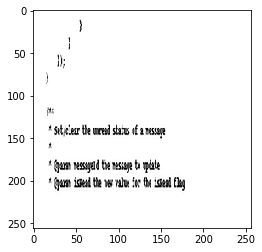

Original label:java, Prediction :cpp, confidence : 0.564


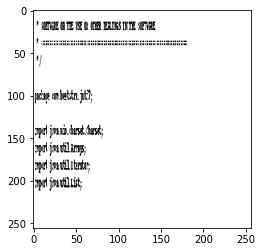

Original label:java, Prediction :cpp, confidence : 0.318


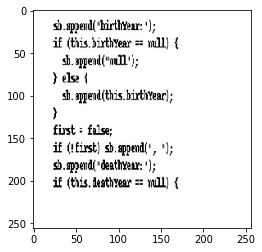

Original label:java, Prediction :cpp, confidence : 0.351


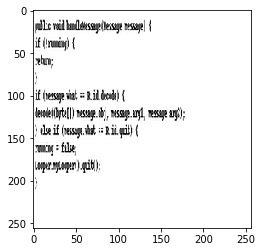

Original label:java, Prediction :c, confidence : 0.982


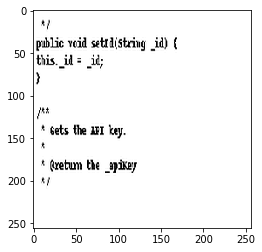

Original label:java, Prediction :cpp, confidence : 0.392


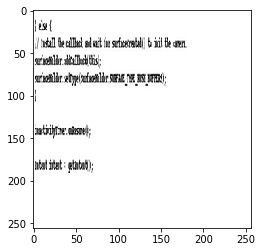

Original label:java, Prediction :python, confidence : 0.624


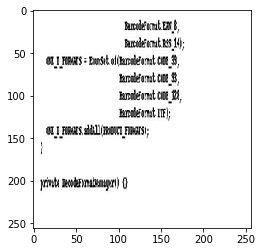

Original label:java, Prediction :cpp, confidence : 0.606


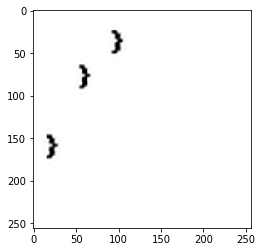

Original label:java, Prediction :c, confidence : 0.271


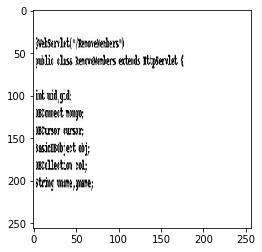

Original label:java, Prediction :cpp, confidence : 0.955


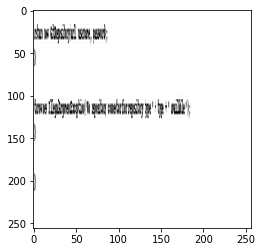

Original label:java, Prediction :cpp, confidence : 0.448


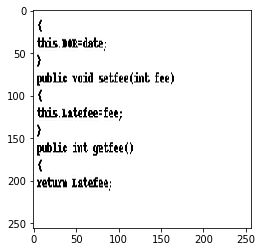

Original label:java, Prediction :cpp, confidence : 0.389


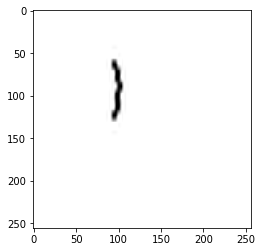

Original label:java, Prediction :c, confidence : 0.585


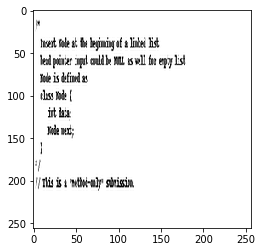

Original label:java, Prediction :c, confidence : 0.262


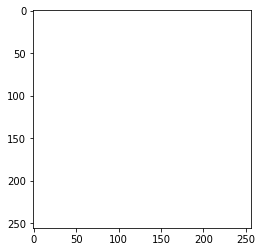

Original label:java, Prediction :cpp, confidence : 0.427


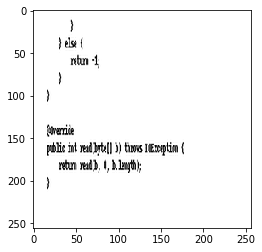

Original label:java, Prediction :cpp, confidence : 0.620


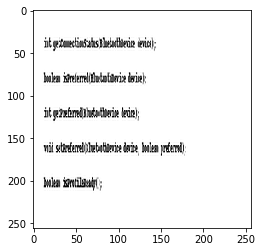

Original label:java, Prediction :c, confidence : 0.430


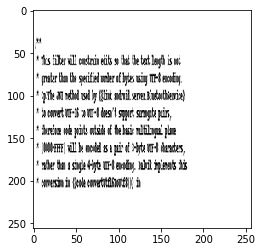

Original label:java, Prediction :c, confidence : 0.534


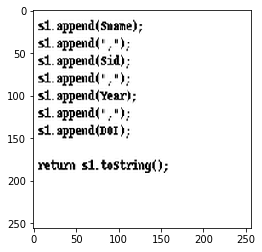

Original label:java, Prediction :cpp, confidence : 0.442


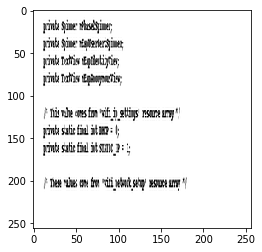

Original label:java, Prediction :cpp, confidence : 0.883


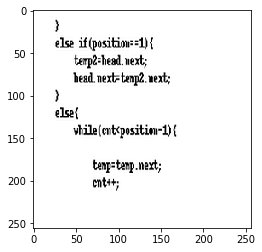

Original label:java, Prediction :cpp, confidence : 0.355


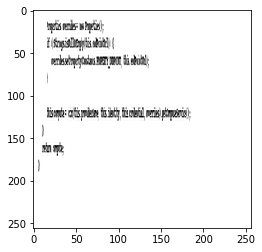

Original label:java, Prediction :cpp, confidence : 0.469


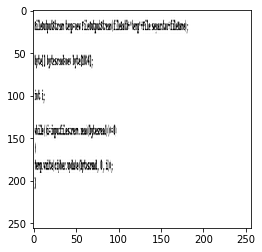

Original label:java, Prediction :c, confidence : 0.628


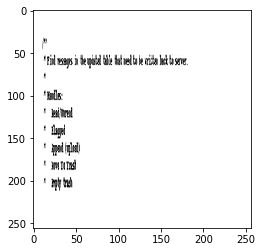

Original label:java, Prediction :cpp, confidence : 0.625


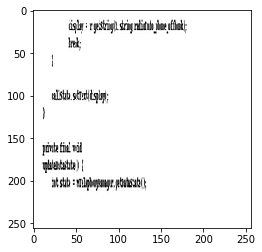

Original label:java, Prediction :cpp, confidence : 0.449


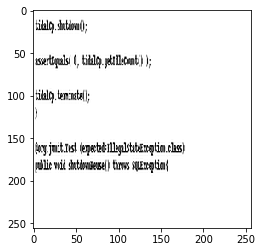

Original label:java, Prediction :cpp, confidence : 0.331


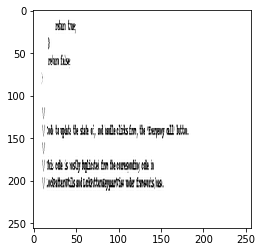

Original label:java, Prediction :c, confidence : 0.467


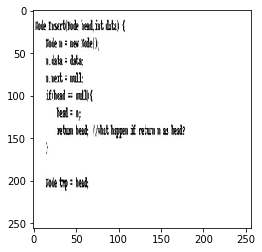

Original label:java, Prediction :cpp, confidence : 0.319


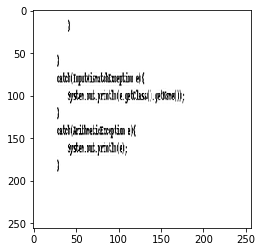

Original label:java, Prediction :cpp, confidence : 0.990


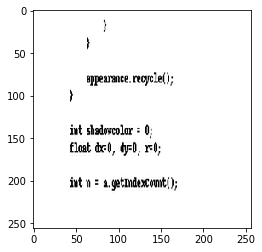

Original label:java, Prediction :cpp, confidence : 0.681


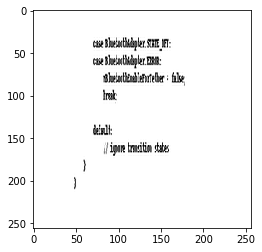

Original label:java, Prediction :c, confidence : 0.333


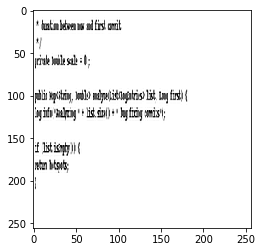

Original label:java, Prediction :c, confidence : 0.441


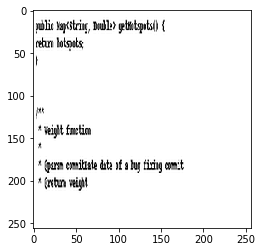

Original label:java, Prediction :cpp, confidence : 0.606


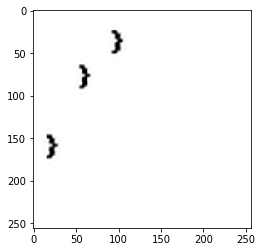

Original label:java, Prediction :c, confidence : 0.390


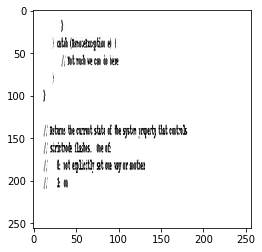

Original label:java, Prediction :cpp, confidence : 0.343


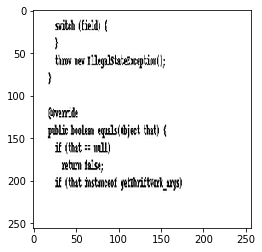

Original label:java, Prediction :c, confidence : 0.311


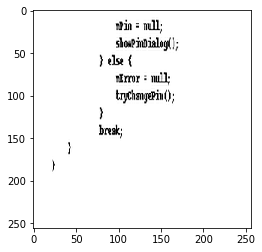

Original label:java, Prediction :c, confidence : 0.522


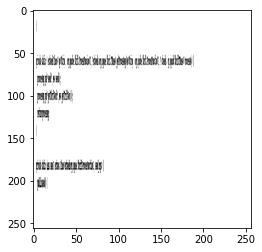

Original label:java, Prediction :cpp, confidence : 0.684


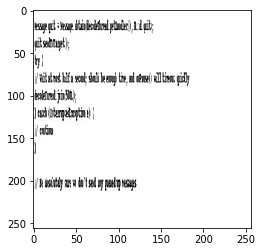

Original label:java, Prediction :c, confidence : 0.475


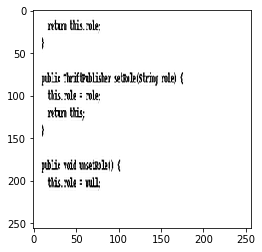

Original label:python, Prediction :java, confidence : 0.826


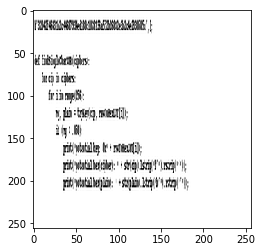

Original label:python, Prediction :c, confidence : 0.337


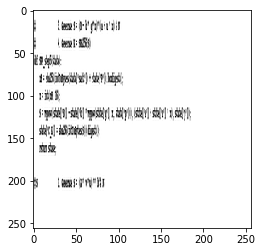

Original label:python, Prediction :java, confidence : 0.974


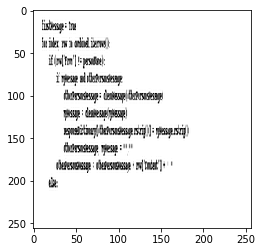

Original label:python, Prediction :c, confidence : 0.920


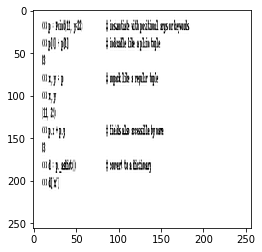

Original label:python, Prediction :cpp, confidence : 0.999


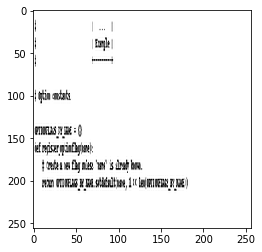

Original label:python, Prediction :c, confidence : 0.624


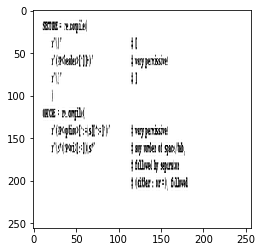

Original label:python, Prediction :c, confidence : 0.407


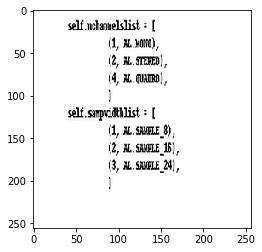

Original label:python, Prediction :cpp, confidence : 0.262


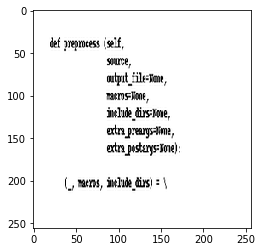

Original label:python, Prediction :cpp, confidence : 0.680


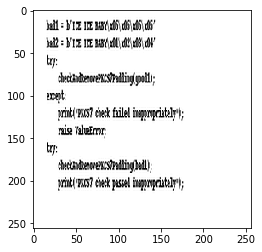

Original label:python, Prediction :c, confidence : 0.477


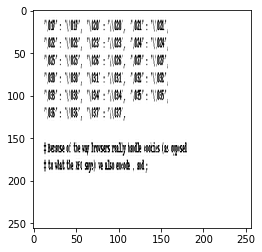

Original label:python, Prediction :java, confidence : 0.662


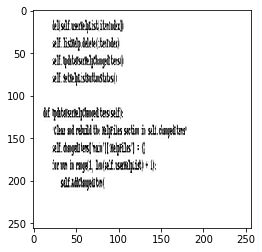

Original label:python, Prediction :c, confidence : 0.322


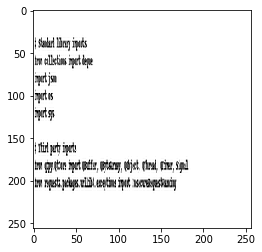

Original label:python, Prediction :java, confidence : 0.364


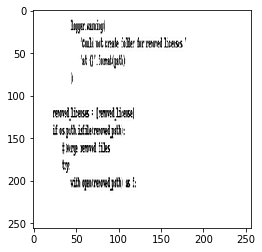

Original label:python, Prediction :c, confidence : 0.540


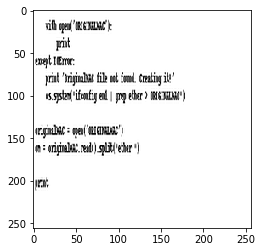

Original label:python, Prediction :c, confidence : 0.419


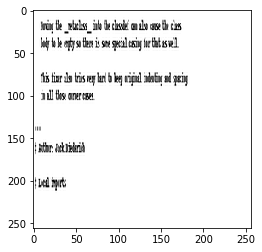

Original label:python, Prediction :c, confidence : 0.270


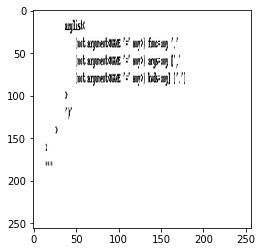

Original label:python, Prediction :cpp, confidence : 0.991


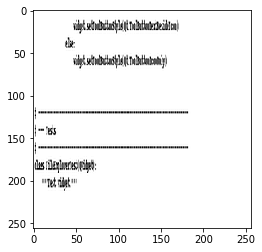

Original label:python, Prediction :cpp, confidence : 0.477


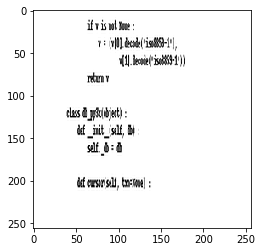

Original label:python, Prediction :c, confidence : 0.376


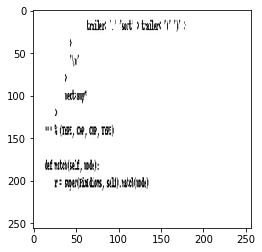

Original label:python, Prediction :java, confidence : 0.948


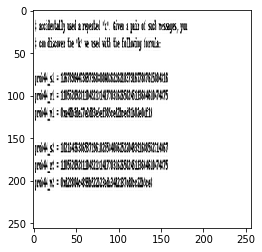

Original label:python, Prediction :c, confidence : 0.401


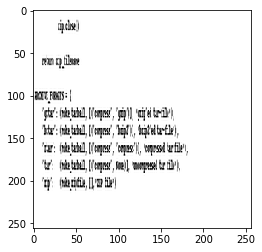

Original label:python, Prediction :c, confidence : 0.338


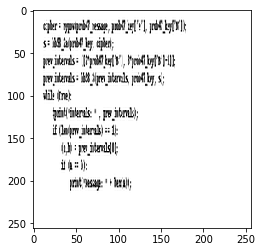

Original label:python, Prediction :c, confidence : 0.871


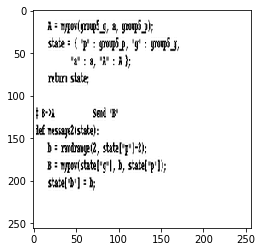

Original label:python, Prediction :java, confidence : 0.890


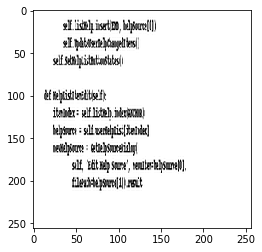

Original label:python, Prediction :c, confidence : 0.364


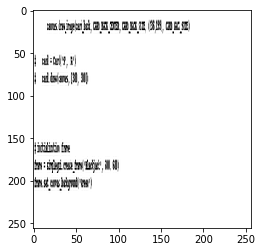

Original label:python, Prediction :c, confidence : 0.479


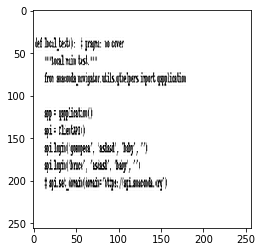

Original label:python, Prediction :c, confidence : 0.682


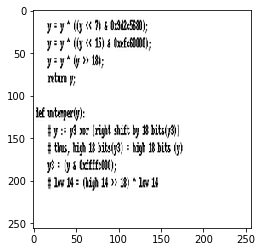

Original label:python, Prediction :c, confidence : 0.415


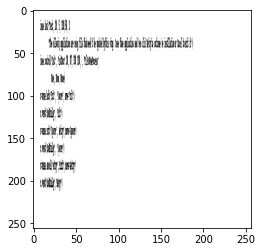

Original label:python, Prediction :java, confidence : 0.523


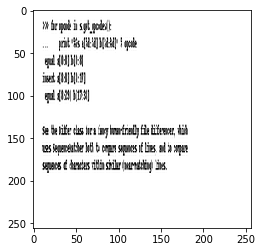

Original label:python, Prediction :java, confidence : 0.505


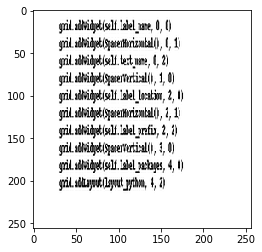

Original label:python, Prediction :c, confidence : 0.459


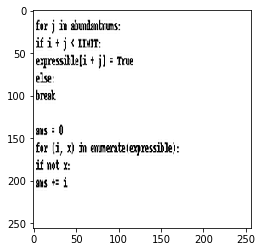

Original label:python, Prediction :cpp, confidence : 0.274


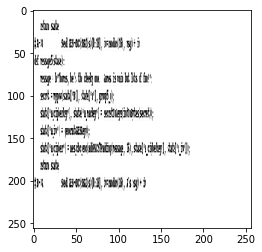

Original label:python, Prediction :c, confidence : 0.273


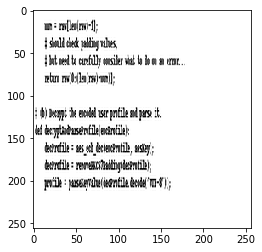

Original label:python, Prediction :c, confidence : 0.364


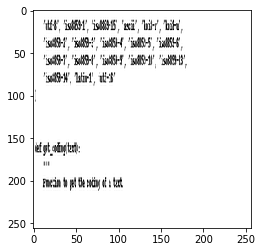

Original label:python, Prediction :c, confidence : 0.262


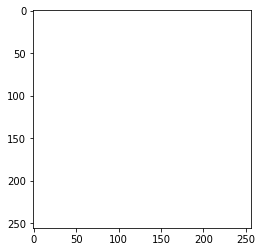

Original label:python, Prediction :c, confidence : 0.421


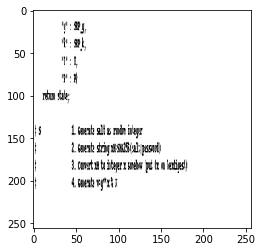

Original label:python, Prediction :c, confidence : 0.587


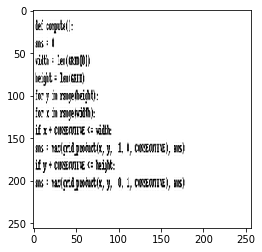

Original label:python, Prediction :c, confidence : 0.416


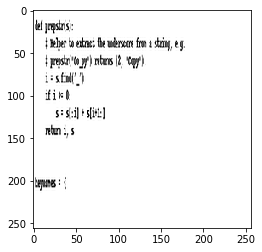

Original label:python, Prediction :cpp, confidence : 0.997


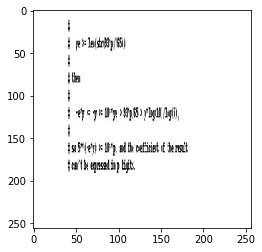

Original label:python, Prediction :c, confidence : 0.551


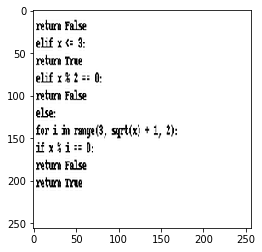

Original label:python, Prediction :c, confidence : 0.436


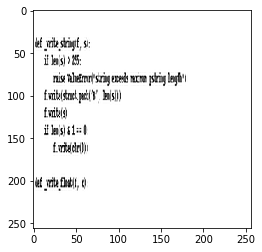

Original label:python, Prediction :c, confidence : 0.562


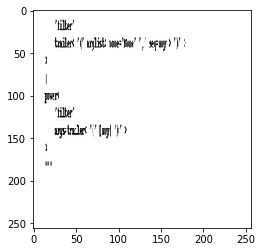

Original label:python, Prediction :java, confidence : 0.868


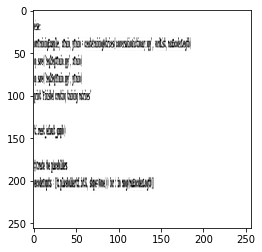

Original label:python, Prediction :c, confidence : 0.455


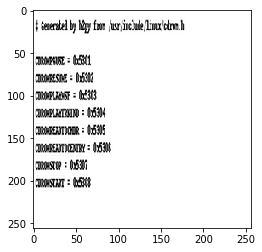

Original label:python, Prediction :java, confidence : 0.420


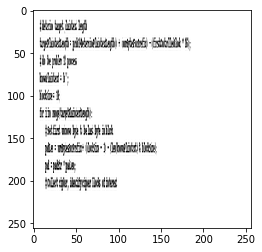

Original label:python, Prediction :java, confidence : 0.360


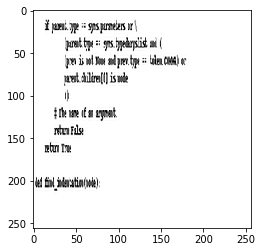

Original label:python, Prediction :c, confidence : 0.291


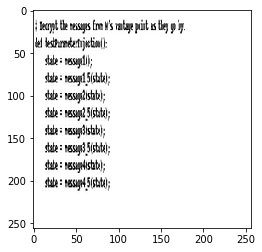

Original label:python, Prediction :c, confidence : 0.369


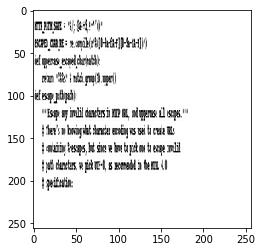

Original label:python, Prediction :c, confidence : 0.453


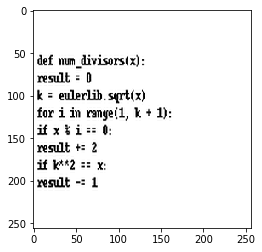

Original label:python, Prediction :c, confidence : 0.299


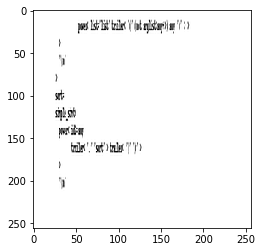

Original label:python, Prediction :java, confidence : 0.860


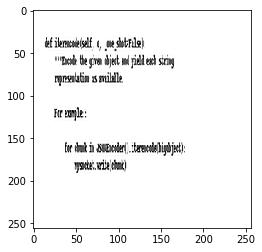

Original label:python, Prediction :java, confidence : 0.359


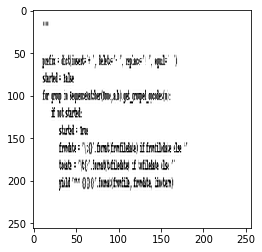

Original label:python, Prediction :cpp, confidence : 0.353


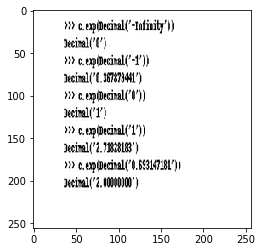

Original label:python, Prediction :cpp, confidence : 0.678


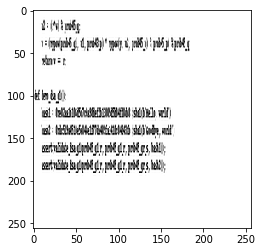

Original label:python, Prediction :c, confidence : 0.276


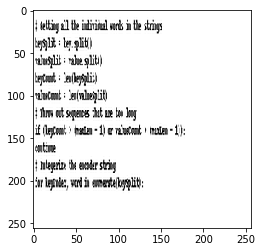

Original label:python, Prediction :c, confidence : 0.422


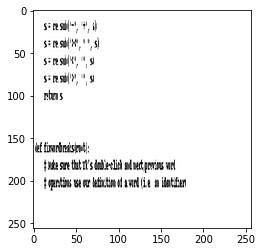

Original label:python, Prediction :c, confidence : 0.322


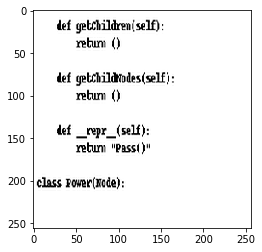

Original label:python, Prediction :java, confidence : 0.881


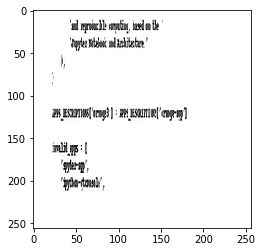

Original label:python, Prediction :c, confidence : 0.373


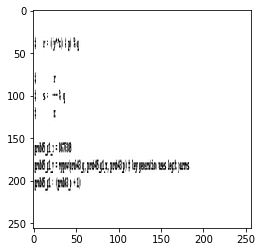

Original label:python, Prediction :c, confidence : 0.480


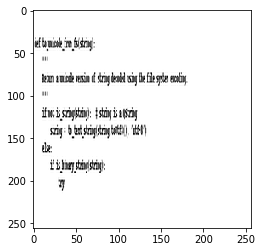

Original label:python, Prediction :java, confidence : 0.389


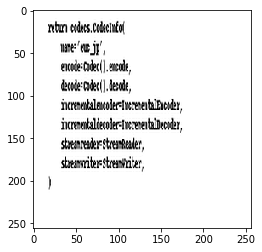

Original label:python, Prediction :c, confidence : 0.273


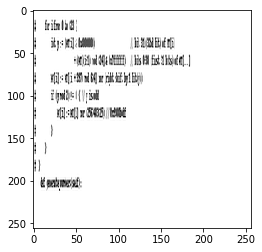

Original label:python, Prediction :cpp, confidence : 0.310


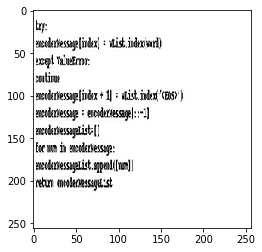

Original label:python, Prediction :c, confidence : 0.282


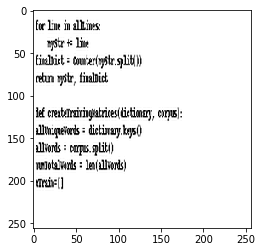

Original label:python, Prediction :cpp, confidence : 0.876


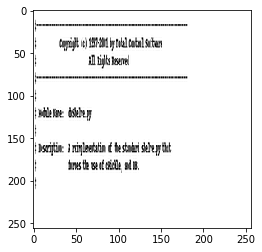

Original label:python, Prediction :c, confidence : 0.841


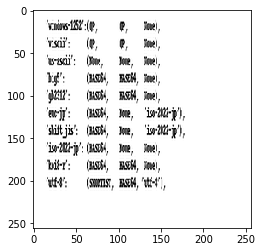

Original label:python, Prediction :cpp, confidence : 1.000


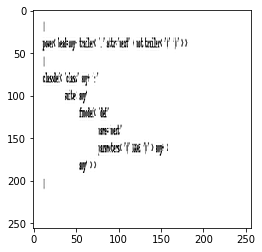

Original label:python, Prediction :c, confidence : 0.649


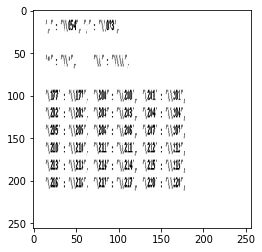

Original label:python, Prediction :c, confidence : 0.442


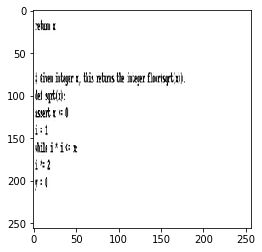

Original label:python, Prediction :cpp, confidence : 0.407


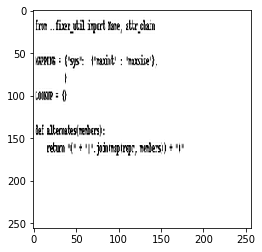

Original label:python, Prediction :java, confidence : 0.556


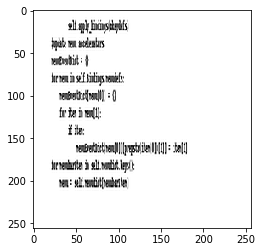

Original label:python, Prediction :c, confidence : 0.519


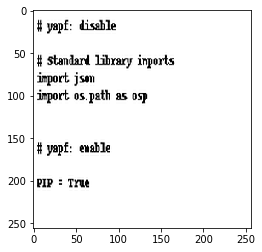

Original label:python, Prediction :c, confidence : 0.987


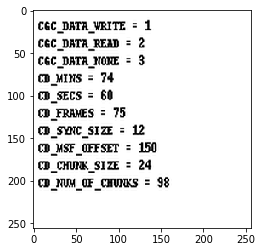

Original label:python, Prediction :c, confidence : 0.622


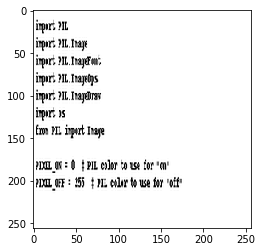

Original label:python, Prediction :java, confidence : 0.673


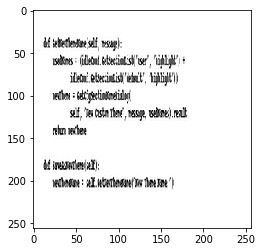

Original label:python, Prediction :cpp, confidence : 0.646


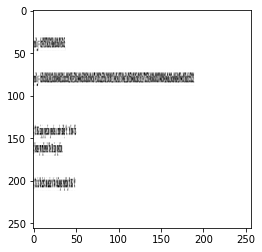

Original label:python, Prediction :c, confidence : 0.540


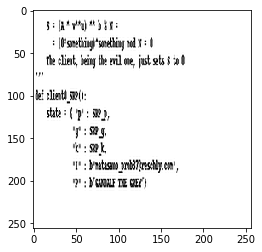

Original label:python, Prediction :c, confidence : 0.313


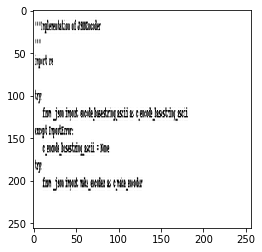

Original label:python, Prediction :c, confidence : 0.618


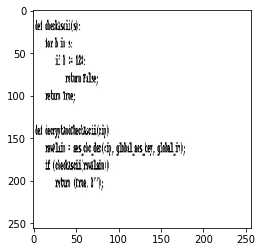

Original label:python, Prediction :c, confidence : 0.425


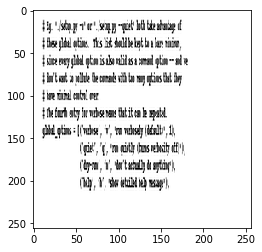

Original label:python, Prediction :java, confidence : 0.934


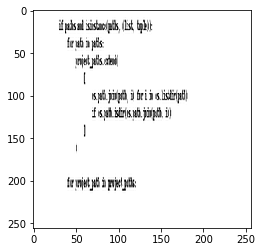

Original label:python, Prediction :c, confidence : 0.396


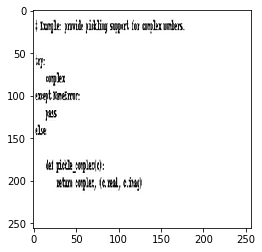

Original label:python, Prediction :java, confidence : 0.335


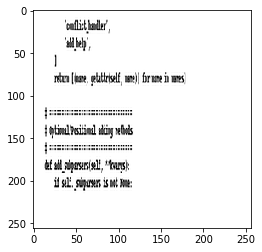

Original label:python, Prediction :c, confidence : 0.380


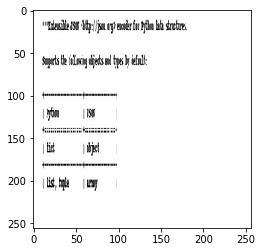

Original label:python, Prediction :java, confidence : 0.760


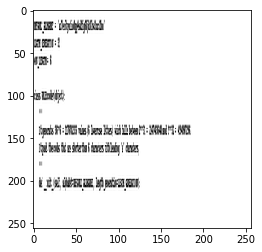

Original label:python, Prediction :java, confidence : 0.931


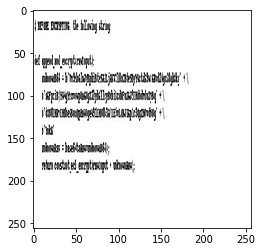

Original label:python, Prediction :c, confidence : 0.415


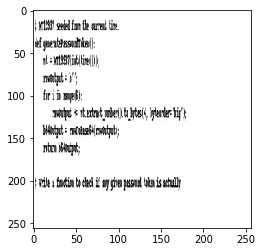

Original label:python, Prediction :c, confidence : 0.269


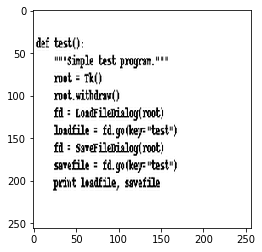

Original label:python, Prediction :c, confidence : 0.324


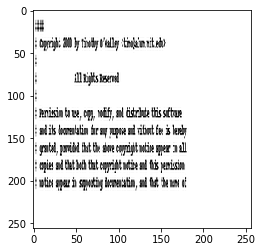

Original label:python, Prediction :c, confidence : 0.397


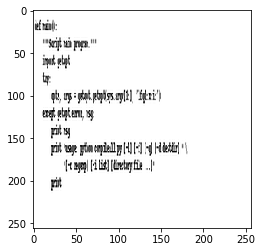

Original label:python, Prediction :c, confidence : 0.398


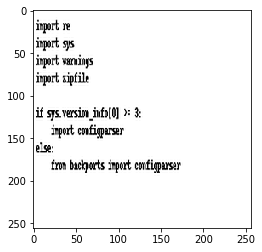

Original label:python, Prediction :java, confidence : 0.958


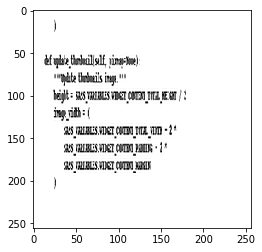

Original label:python, Prediction :java, confidence : 0.795


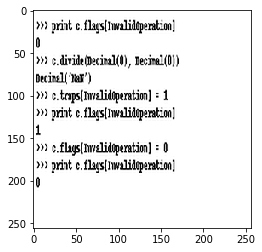

Original label:python, Prediction :c, confidence : 0.369


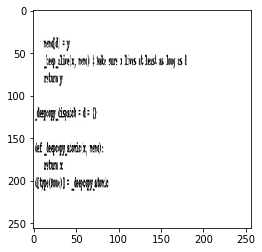

Original label:python, Prediction :cpp, confidence : 0.751


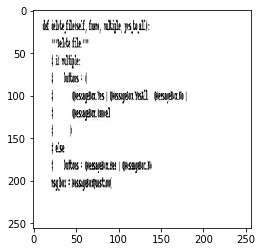

Original label:python, Prediction :c, confidence : 0.601


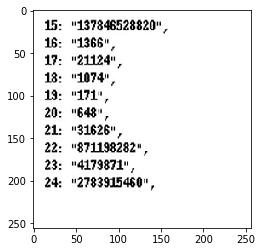

Original label:python, Prediction :c, confidence : 0.394


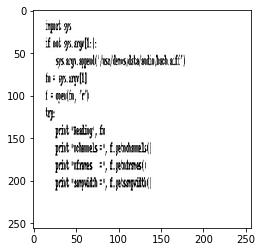

Original label:python, Prediction :c, confidence : 0.507


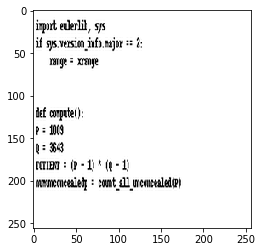

Original label:python, Prediction :c, confidence : 0.730


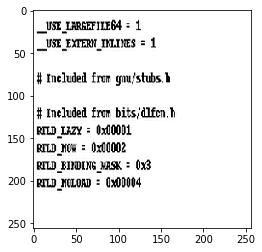

Original label:python, Prediction :java, confidence : 0.656


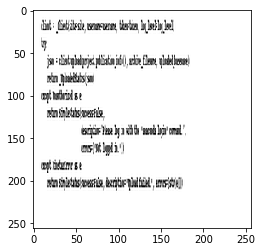

Original label:python, Prediction :java, confidence : 0.552


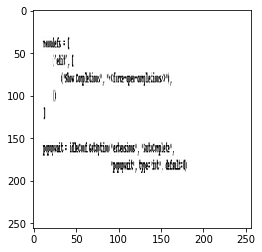

Original label:python, Prediction :java, confidence : 0.827


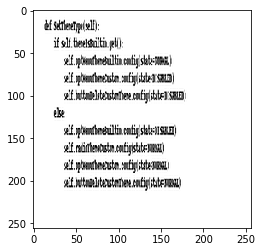

Original label:python, Prediction :java, confidence : 0.394


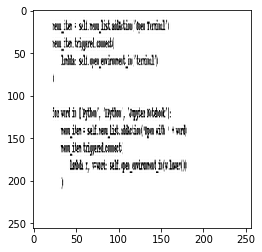

Original label:python, Prediction :c, confidence : 0.843


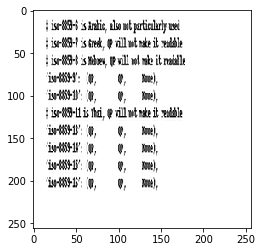

Original label:python, Prediction :cpp, confidence : 0.289


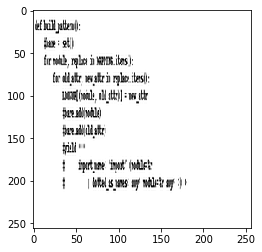

Original label:python, Prediction :java, confidence : 0.912


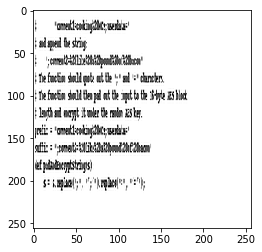

Original label:python, Prediction :java, confidence : 0.911


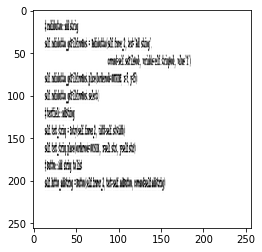

Original label:python, Prediction :java, confidence : 0.315


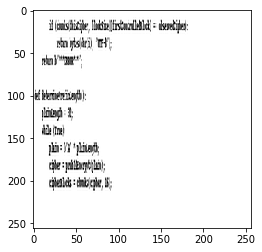

Original label:python, Prediction :java, confidence : 0.406


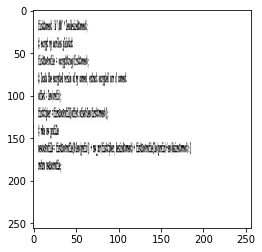

Original label:python, Prediction :c, confidence : 0.533


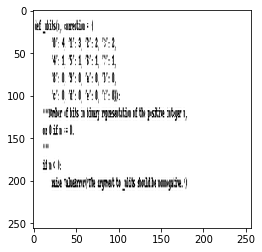

Original label:python, Prediction :c, confidence : 0.807


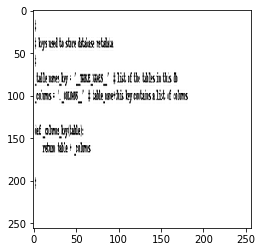

Original label:python, Prediction :c, confidence : 0.457


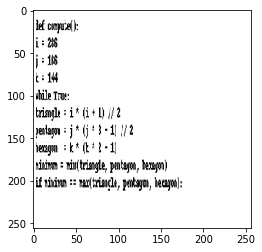

Original label:python, Prediction :c, confidence : 0.287


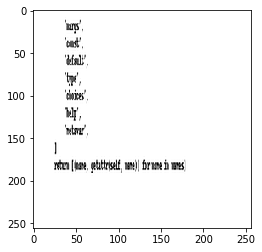

In [12]:
for i in range(len(errors)):
    pred_class = np.argmax(prob[errors[i]])
    pred_label = idx2label[pred_class]
    
    print('Original label:{}, Prediction :{}, confidence : {:.3f}'.format(
        fnames[errors[i]].split('/')[0],
        pred_label,
        prob[errors[i]][pred_class]))
    
    original = load_img('{}/{}'.format(validation_dir,fnames[errors[i]]))
    plt.imshow(original)
    plt.show()

ValueError: Error when checking : expected input_26 to have 4 dimensions, but got array with shape (1, 256, 256)